## Importing Packages

In [5]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt 
import seaborn as sns
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.model_selection import RandomizedSearchCV, GridSearchCV
from sklearn import tree
from sklearn.metrics import accuracy_score,confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics import accuracy_score, roc_curve, auc
from sklearn.metrics import recall_score,precision_score
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from imblearn.over_sampling import SMOTE
from collections import Counter
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report

## Importing Datasets

In [152]:
raw_data = pd.read_csv("C:/Users/winot/OneDrive/Desktop/UCI Academics/2. Fall 2024/Data Programming Analytics/Project/movie_metadata.csv")

cleaned_data = pd.read_csv("C:/Users/winot/OneDrive/Desktop/UCI Academics/2. Fall 2024/Data Programming Analytics/Project/Cleaned Data for Visualization.csv")

clean_data_no_names = pd.read_csv("C:/Users/winot/OneDrive/Desktop/UCI Academics/2. Fall 2024/Data Programming Analytics/Project/Cleaned Data No Names.csv")

clean_data_genre_engineered = pd.read_csv("C:/Users/winot/OneDrive/Desktop/UCI Academics/2. Fall 2024/Data Programming Analytics/Project/Cleaned Data No Names and Genre Altered.csv")

dummy_data = pd.read_csv("C:/Users/winot/OneDrive/Desktop/UCI Academics/2. Fall 2024/Data Programming Analytics/Project/Dummy Data.csv")

dummy_data_consolidated = pd.read_csv("C:/Users/winot/OneDrive/Desktop/UCI Academics/2. Fall 2024/Data Programming Analytics/Project/Dummy Data Consolidated.csv")

completed_dummy_data = pd.read_csv("C:/Users/winot/OneDrive/Desktop/UCI Academics/2. Fall 2024/Data Programming Analytics/Project/Completed Dummy Data.csv")

final_clean_data = pd.read_csv("C:/Users/winot/OneDrive/Desktop/UCI Academics/2. Fall 2024/Data Programming Analytics/Project/Final Cleaned Data.csv")

#### Comments on importing dataset

There's a lot of datasets here because we put checkpoints throughout the entire code. This way, when we continue developing the project the next day or something, we can simply load the data from the last check point instead of loading the raw data and executing the code top to bottom to get to the last check point. 

## List of Functions for Data Cleaning and Modeling

In [ ]:
# list of variable types
def list_variable_types(df):
    categorical_columns = df.select_dtypes(include=['object', 'category']).columns.tolist()
    numerical_columns   = df.select_dtypes(include=['float64', 'int64']).columns.tolist()

    print("Categorical Variables:")
    print(categorical_columns)
    
    print("\nNumerical Variables:")
    print(numerical_columns)


# check for missing values
def missing_value_percentage(df):
    missing_percentage = df.isnull().mean() * 100
    print("Percentage of missing values in each column:\n")
    print(missing_percentage)


# check for duplicate values 
def check_duplicates(df):
    duplicate_count = df.duplicated().sum()
    total_rows = len(df)
    duplicate_proportion = duplicate_count / total_rows if total_rows > 0 else 0
    print(f"Number of duplicate rows in the dataset: {duplicate_count}")
    print(f"Proportion of duplicate rows over total rows: {duplicate_proportion * 100:.2f}%")


# creating confusion matrix
def plot_confusionmatrix(y_train_pred,y_train,dom):
    print(f'{dom} Confusion matrix')
    cf = confusion_matrix(y_train, y_train_pred)
    fig, ax = plt.subplots(figsize=(8, 8))
    sns.heatmap(cf,annot=True,yticklabels=classes,xticklabels=classes,cmap='Blues', fmt='g')
    ax.set_aspect('equal')
    plt.tight_layout()
    plt.show()

#### Comments on List of Variables

These are the four functions we use, mostly for data cleaning purposes. This includes creating a list of variables and their respective types (numerical/categorical), calculating the proportion of missing values for each column, checking how many duplicate rows are there, and plotting a confusion matrix to evaluate our model performance. 

## Data Cleaning

Our data cleaning includes three steps, which are dropping missing value rows, dropping duplicate records, and discovering outliers. There's a data overview which utilizes the functions above to list the amount of missing values, outliers, and duplicate rows before and after the data cleaning procedures. 

### Data Overview (Prior to Cleaning)

#### Head Overview

In [109]:
raw_data.head()

,color,director_name,num_critic_for_reviews,duration,director_facebook_likes,actor_3_facebook_likes,actor_2_name,actor_1_facebook_likes,gross,genres,...,num_user_for_reviews,language,country,content_rating,budget,title_year,actor_2_facebook_likes,imdb_score,aspect_ratio,movie_facebook_likes
0,Color,James Cameron,723.0,178.0,0.0,855.0,Joel David Moore,1000.0,760505847.0,Action|Adventure|Fantasy|Sci-Fi,...,3054.0,English,USA,PG-13,237000000.0,2009.0,936.0,7.9,1.78,33000
1,Color,Gore Verbinski,302.0,169.0,563.0,1000.0,Orlando Bloom,40000.0,309404152.0,Action|Adventure|Fantasy,...,1238.0,English,USA,PG-13,300000000.0,2007.0,5000.0,7.1,2.35,0
2,Color,Sam Mendes,602.0,148.0,0.0,161.0,Rory Kinnear,11000.0,200074175.0,Action|Adventure|Thriller,...,994.0,English,UK,PG-13,245000000.0,2015.0,393.0,6.8,2.35,85000
3,Color,Christopher Nolan,813.0,164.0,22000.0,23000.0,Christian Bale,27000.0,448130642.0,Action|Thriller,...,2701.0,English,USA,PG-13,250000000.0,2012.0,23000.0,8.5,2.35,164000
4,NaN,Doug Walker,NaN,NaN,131.0,NaN,Rob Walker,131.0,NaN,Documentary,...,NaN,NaN,NaN,NaN,NaN,NaN,12.0,7.1,NaN,0


In [111]:
raw_data.shape

(5043, 28)

There's 5,043 rows and 28 columns in our dataset. 

#### List of Variables and Their Data Types

In [115]:
raw_data.dtypes

color                         object
director_name                 object
num_critic_for_reviews       float64
duration                     float64
director_facebook_likes      float64
actor_3_facebook_likes       float64
actor_2_name                  object
actor_1_facebook_likes       float64
gross                        float64
genres                        object
actor_1_name                  object
movie_title                   object
num_voted_users                int64
cast_total_facebook_likes      int64
actor_3_name                  object
facenumber_in_poster         float64
plot_keywords                 object
movie_imdb_link               object
num_user_for_reviews         float64
language                      object
country                       object
content_rating                object
budget                       float64
title_year                   float64
actor_2_facebook_likes       float64
imdb_score                   float64
aspect_ratio                 float64
m

In [117]:
list_variable_types(raw_data)

Categorical Variables:
['color', 'director_name', 'actor_2_name', 'genres', 'actor_1_name', 'movie_title', 'actor_3_name', 'plot_keywords', 'movie_imdb_link', 'language', 'country', 'content_rating']

Numerical Variables:
['num_critic_for_reviews', 'duration', 'director_facebook_likes', 'actor_3_facebook_likes', 'actor_1_facebook_likes', 'gross', 'num_voted_users', 'cast_total_facebook_likes', 'facenumber_in_poster', 'num_user_for_reviews', 'budget', 'title_year', 'actor_2_facebook_likes', 'imdb_score', 'aspect_ratio', 'movie_facebook_likes']


Majority of the data are numerical variables, which includes facebook likes for various variables like actors, movies, and directors as well as budget and gross revenue for each movies. The categorical variables mostly include actor names, movie titles, language and countries

#### Checking Missing Values 

In [121]:
missing_value_percentage(raw_data)

Percentage of missing values in each column:

color                         0.376760
director_name                 2.062265
num_critic_for_reviews        0.991473
duration                      0.297442
director_facebook_likes       2.062265
actor_3_facebook_likes        0.456078
actor_2_name                  0.257783
actor_1_facebook_likes        0.138806
gross                        17.529248
genres                        0.000000
actor_1_name                  0.138806
movie_title                   0.000000
num_voted_users               0.000000
cast_total_facebook_likes     0.000000
actor_3_name                  0.456078
facenumber_in_poster          0.257783
plot_keywords                 3.033908
movie_imdb_link               0.000000
num_user_for_reviews          0.416419
language                      0.277613
country                       0.099147
content_rating                6.008328
budget                        9.756098
title_year                    2.141582
actor_2_facebook_l

Most of the columns have missing values. The highest one is gross column, which has 17% missing values in relation to the total number of rows in the dataset. 

In [124]:
raw_data.isnull().sum()

color                         19
director_name                104
num_critic_for_reviews        50
duration                      15
director_facebook_likes      104
actor_3_facebook_likes        23
actor_2_name                  13
actor_1_facebook_likes         7
gross                        884
genres                         0
actor_1_name                   7
movie_title                    0
num_voted_users                0
cast_total_facebook_likes      0
actor_3_name                  23
facenumber_in_poster          13
plot_keywords                153
movie_imdb_link                0
num_user_for_reviews          21
language                      14
country                        5
content_rating               303
budget                       492
title_year                   108
actor_2_facebook_likes        13
imdb_score                     0
aspect_ratio                 329
movie_facebook_likes           0
dtype: int64

This is similar to the top missing % data, but this column tells us how many rows have missing values in each respective columns. For example, gross has 884 rows missing from the total 5,043 rows.

#### Checking Duplicate Values

In [128]:
check_duplicates(raw_data)

Number of duplicate rows in the dataset: 45
Proportion of duplicate rows over total rows: 0.89%


There's 45 rows with duplicate values, which accounts for close to 1% of the overall rows in our dataset

### Data Cleaning Procedure

#### Dropping Rows with Missing Values

In [154]:
raw_data.dropna(inplace = True)
raw_data.shape

(3755, 28)

#### Dropping Duplicate Records

In [157]:
raw_data.drop_duplicates(inplace = True)
raw_data.shape

(3722, 28)

#### Data Distribution and Visualization (Numerical)

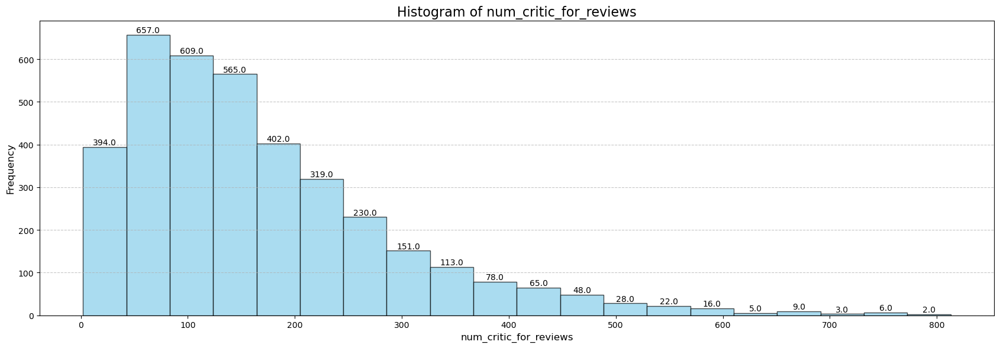

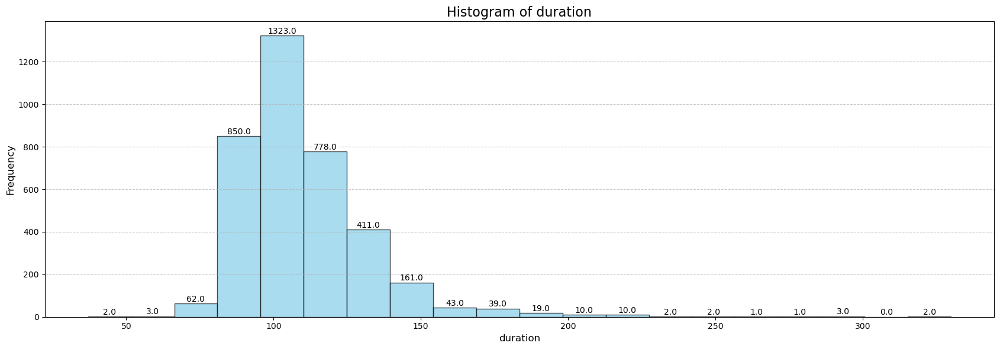

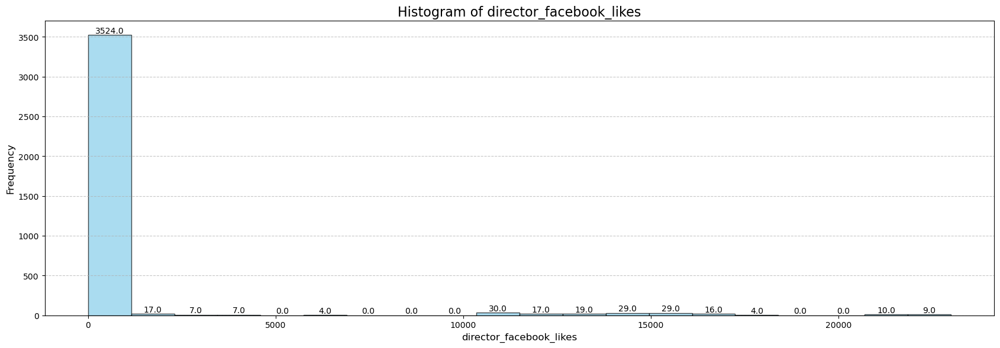

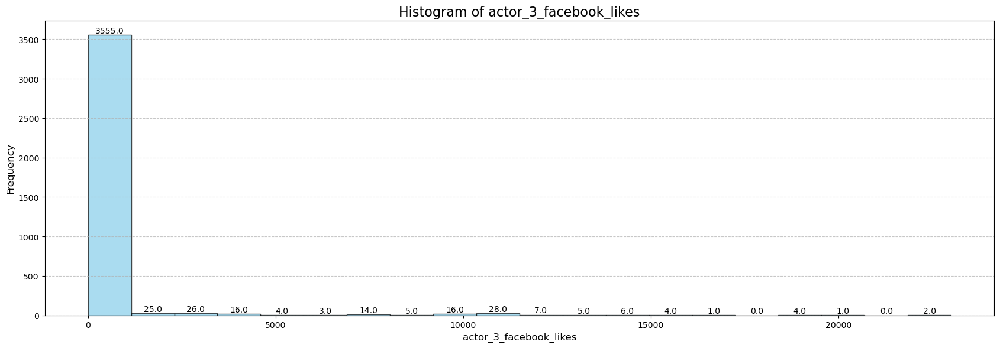

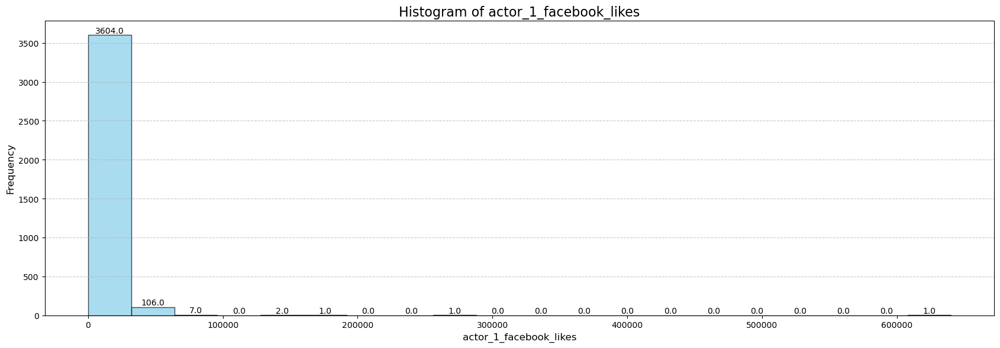

...

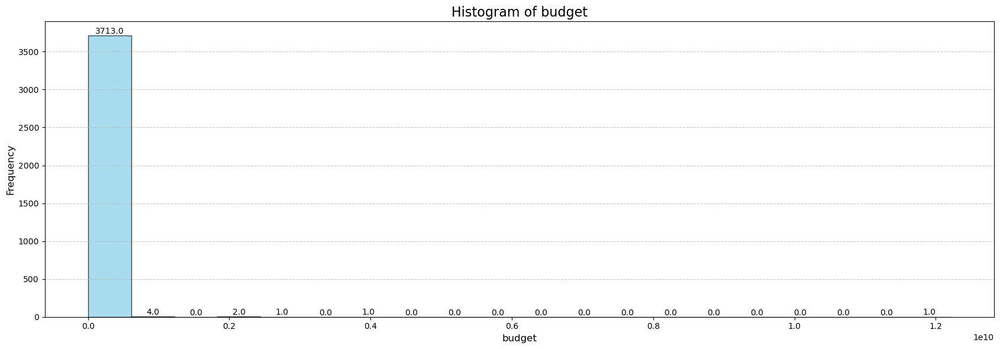

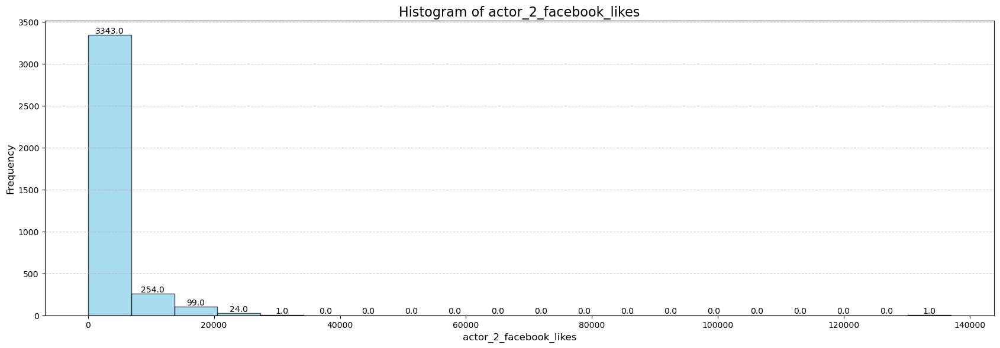

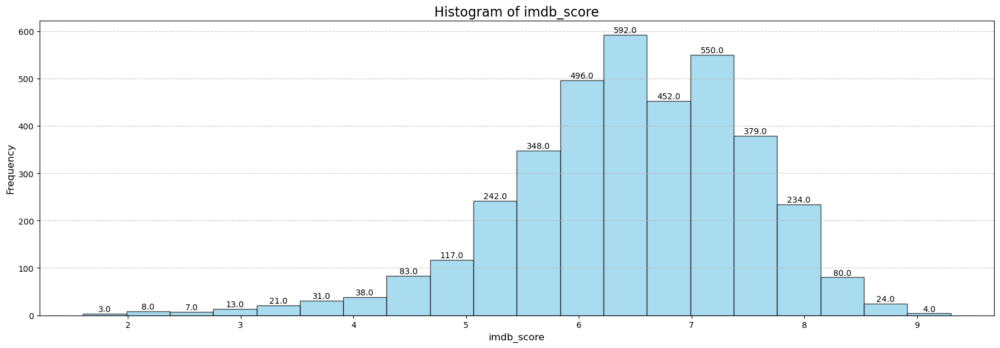

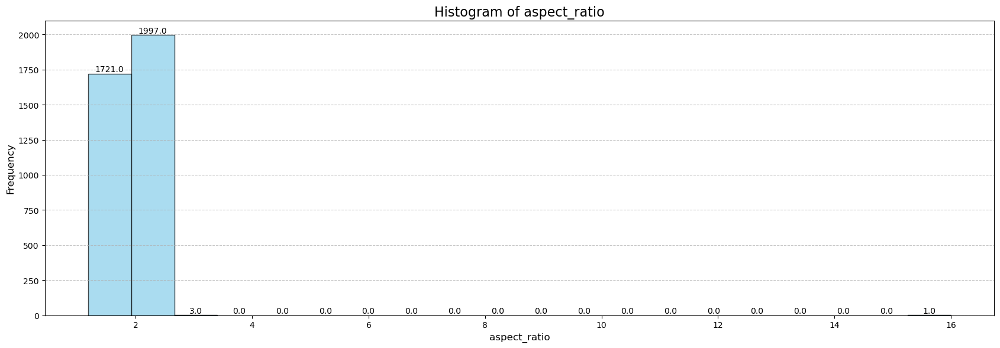

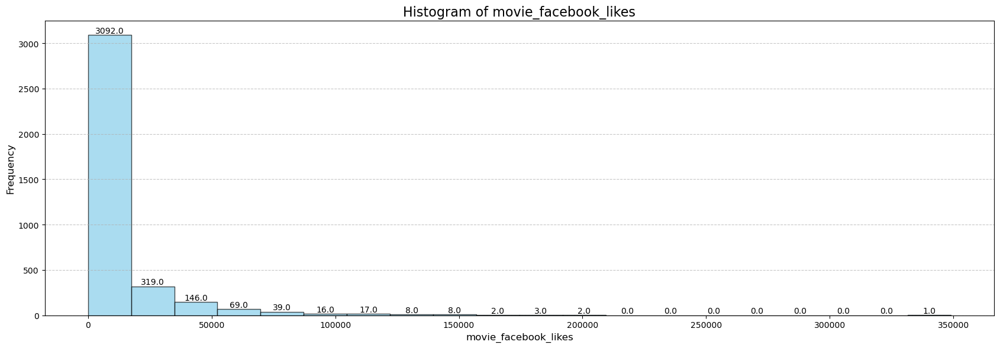

In [73]:
number_column_list = ["num_critic_for_reviews", "duration", "director_facebook_likes", "actor_3_facebook_likes","actor_1_facebook_likes","gross","num_voted_users","cast_total_facebook_likes","facenumber_in_poster","num_user_for_reviews", "budget", "actor_2_facebook_likes", "imdb_score", "aspect_ratio", "movie_facebook_likes"]

for x in number_column_list:
    plt.figure(figsize=(17, 6))
    n, bins, patches = plt.hist(raw_data[x], bins=20, edgecolor='black', color='skyblue', alpha=0.7)
    
    for i in range(len(bins) - 1):
        bin_center = (bins[i] + bins[i + 1]) / 2
        plt.text(bin_center, n[i] + 1, f'{n[i]:.1f}', ha='center', va='bottom', fontsize=10, color='black')

    plt.title(f'Histogram of {x}', fontsize=16)
    plt.xlabel(f'{x}', fontsize=12)
    plt.ylabel('Frequency', fontsize=12)
    plt.grid(axis='y', linestyle='--', alpha=0.7)
    plt.tight_layout()
    plt.show()

#### Checking Outliers

In [161]:
# finding the data with the top 5 gross
top_3_gross = raw_data.nlargest(3, 'gross')
print(top_3_gross)

    color    director_name  num_critic_for_reviews  duration  \
0   Color    James Cameron                   723.0     178.0   
26  Color    James Cameron                   315.0     194.0   
29  Color  Colin Trevorrow                   644.0     124.0   

    director_facebook_likes  actor_3_facebook_likes      actor_2_name  \
0                       0.0                   855.0  Joel David Moore   
26                      0.0                   794.0      Kate Winslet   
29                    365.0                  1000.0        Judy Greer   

    actor_1_facebook_likes        gross                            genres  \
0                   1000.0  760505847.0   Action|Adventure|Fantasy|Sci-Fi   
26                 29000.0  658672302.0                     Drama|Romance   
29                  3000.0  652177271.0  Action|Adventure|Sci-Fi|Thriller   

    ... num_user_for_reviews language  country  content_rating       budget  \
0   ...               3054.0  English      USA           PG-13

#### Comments on distribution and potential outliers

We noticed some distribution for the numerical variables are kind of skewed to the left and having one or two extreme values on the right tails. However, almost none of these variables' outliers are not clerical input errors. After diving into the excel file, we found out that these outliers are actually correct. For example, the movie Avatar made 760 million usd in gross revenue, which is why there's one point at the tail of the gross histogram. However, after looking into the distribution of budget in the, we noticed some variables being above $1 billion dollars in budget. 

In [164]:
# finding the data with the top 10 budgets

top_10_budget = raw_data.nlargest(10, 'budget')
print(top_10_budget)

      color    director_name  num_critic_for_reviews  duration  \
2988  Color     Joon-ho Bong                   363.0     110.0   
3859  Color   Chan-wook Park                   202.0     112.0   
3005  Color     Lajos Koltai                    73.0     134.0   
2323  Color   Hayao Miyazaki                   174.0     134.0   
2334  Color  Katsuhiro Ôtomo                   105.0     103.0   
3423  Color  Katsuhiro Ôtomo                   150.0     124.0   
4542  Color    Takao Okawara                   107.0      99.0   
3075  Color      Karan Johar                    20.0     193.0   
3851  Color     Carlos Saura                    35.0     115.0   
1338  Color         John Woo                   160.0     150.0   

      director_facebook_likes  actor_3_facebook_likes         actor_2_name  \
2988                    584.0                    74.0         Kang-ho Song   
3859                      0.0                    38.0         Yeong-ae Lee   
3005                     45.0          

These kind of outliers are for sure errors and a key distinction is that these budget outliers are typically from movies that are not in english language. They are using their own foreign currencies. Since majority are english speaking movies, most currencies uses the USD. Hence to keep currency for budget and gross consistent, we decided to drop any movies that are not in english language to avoid any outliers for the budget variable. 

#### Dropping Outlier Records by dropping movies that are not in english language

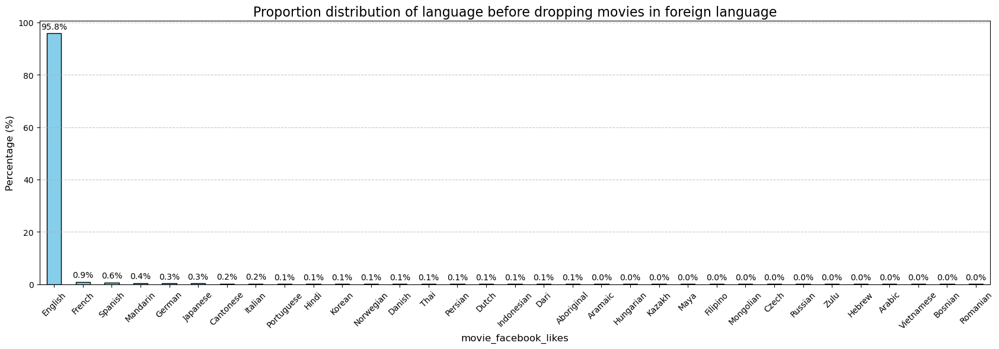

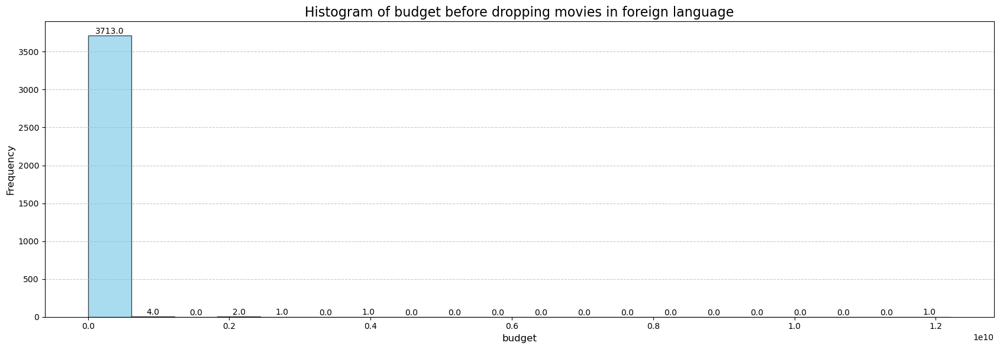

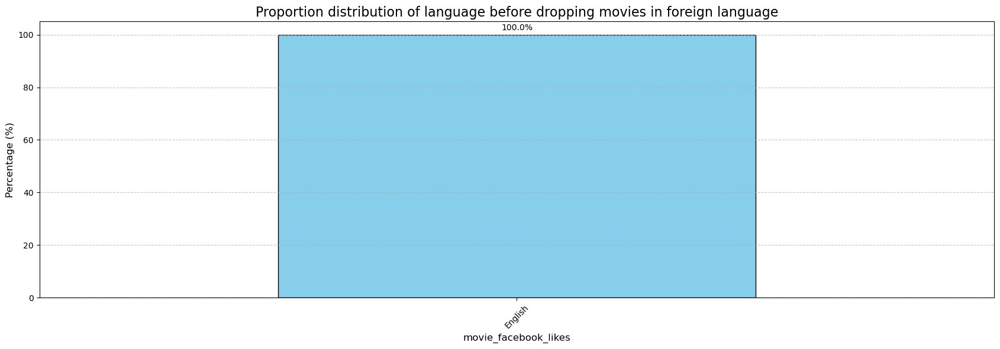

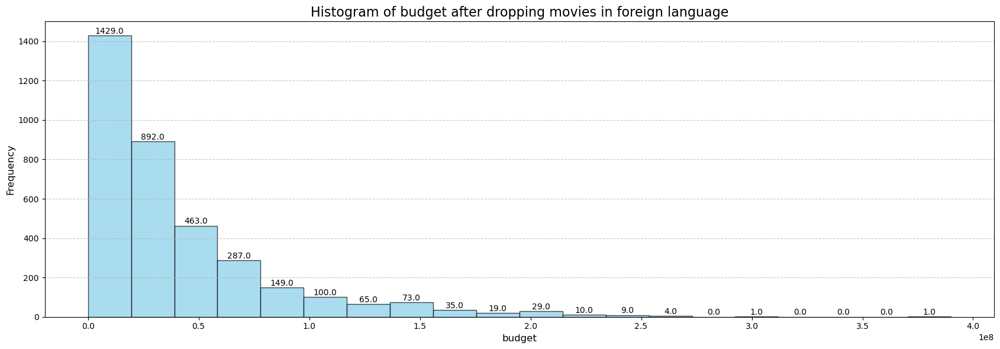

In [168]:
# Visualization of language and budget histogram before dropping movies in foreign language
proportions = raw_data["language"].value_counts(normalize=True) * 100

plt.figure(figsize=(17, 6))
bar_chart = proportions.plot(kind='bar', color='skyblue', edgecolor='black')
if (x!= "title_year"):
    for index, value in enumerate(proportions):
        plt.text(index, value + 1, f'{value:.1f}%', ha='center', va='bottom', fontsize=10, color='black')

plt.title(f'Proportion distribution of language before dropping movies in foreign language', fontsize=16)
plt.ylabel('Percentage (%)', fontsize=12)
plt.xlabel(f'{x}', fontsize=12)
plt.xticks(rotation=45)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()


plt.figure(figsize=(17, 6))
n, bins, patches = plt.hist(raw_data["budget"], bins=20, edgecolor='black', color='skyblue', alpha=0.7)
for i in range(len(bins) - 1):
    bin_center = (bins[i] + bins[i + 1]) / 2
    plt.text(bin_center, n[i] + 1, f'{n[i]:.1f}', ha='center', va='bottom', fontsize=10, color='black')
plt.title(f'Histogram of budget before dropping movies in foreign language', fontsize=16)
plt.xlabel(f'{"budget"}', fontsize=12)
plt.ylabel('Frequency', fontsize=12)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()


# Drop movies which is not in english language 
raw_data = raw_data[raw_data['language'] == 'English']


# Visualization of language and budget histogram after dropping movies in foreign language
proportions = raw_data["language"].value_counts(normalize=True) * 100

plt.figure(figsize=(17, 6))
bar_chart = proportions.plot(kind='bar', color='skyblue', edgecolor='black')
if (x!= "title_year"):
    for index, value in enumerate(proportions):
        plt.text(index, value + 1, f'{value:.1f}%', ha='center', va='bottom', fontsize=10, color='black')

plt.title(f'Proportion distribution of language after dropping movies in foreign language', fontsize=16)
plt.ylabel('Percentage (%)', fontsize=12)
plt.xlabel(f'{x}', fontsize=12)
plt.xticks(rotation=45)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()


plt.figure(figsize=(17, 6))
n, bins, patches = plt.hist(raw_data["budget"], bins=20, edgecolor='black', color='skyblue', alpha=0.7)
for i in range(len(bins) - 1):
    bin_center = (bins[i] + bins[i + 1]) / 2
    plt.text(bin_center, n[i] + 1, f'{n[i]:.1f}', ha='center', va='bottom', fontsize=10, color='black')
plt.title(f'Histogram of budget after dropping movies in foreign language', fontsize=16)
plt.xlabel(f'{"budget"}', fontsize=12)
plt.ylabel('Frequency', fontsize=12)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

After dropping movies that are not in english, we can see that the budget distribution is smoother. It's still left skewed, but the distribubtion is much better compared to before with having budget from different currencies. 

In [134]:
raw_data.shape

(3566, 28)

The shape of the dataset with no missing values, duplicates, and outliers is 3,566 rows and 28 columns.

### Data Overview (Post Cleaning)

#### Head Overview

In [136]:
raw_data.head()

,color,director_name,num_critic_for_reviews,duration,director_facebook_likes,actor_3_facebook_likes,actor_2_name,actor_1_facebook_likes,gross,genres,...,num_user_for_reviews,language,country,content_rating,budget,title_year,actor_2_facebook_likes,imdb_score,aspect_ratio,movie_facebook_likes
0,Color,James Cameron,723.0,178.0,0.0,855.0,Joel David Moore,1000.0,760505847.0,Action|Adventure|Fantasy|Sci-Fi,...,3054.0,English,USA,PG-13,237000000.0,2009.0,936.0,7.9,1.78,33000
1,Color,Gore Verbinski,302.0,169.0,563.0,1000.0,Orlando Bloom,40000.0,309404152.0,Action|Adventure|Fantasy,...,1238.0,English,USA,PG-13,300000000.0,2007.0,5000.0,7.1,2.35,0
2,Color,Sam Mendes,602.0,148.0,0.0,161.0,Rory Kinnear,11000.0,200074175.0,Action|Adventure|Thriller,...,994.0,English,UK,PG-13,245000000.0,2015.0,393.0,6.8,2.35,85000
3,Color,Christopher Nolan,813.0,164.0,22000.0,23000.0,Christian Bale,27000.0,448130642.0,Action|Thriller,...,2701.0,English,USA,PG-13,250000000.0,2012.0,23000.0,8.5,2.35,164000
5,Color,Andrew Stanton,462.0,132.0,475.0,530.0,Samantha Morton,640.0,73058679.0,Action|Adventure|Sci-Fi,...,738.0,English,USA,PG-13,263700000.0,2012.0,632.0,6.6,2.35,24000


In [138]:
raw_data.shape

(3566, 28)

#### List of Variables and Their Data Types

In [140]:
list_variable_types(raw_data)

Categorical Variables:
['color', 'director_name', 'actor_2_name', 'genres', 'actor_1_name', 'movie_title', 'actor_3_name', 'plot_keywords', 'movie_imdb_link', 'language', 'country', 'content_rating']

Numerical Variables:
['num_critic_for_reviews', 'duration', 'director_facebook_likes', 'actor_3_facebook_likes', 'actor_1_facebook_likes', 'gross', 'num_voted_users', 'cast_total_facebook_likes', 'facenumber_in_poster', 'num_user_for_reviews', 'budget', 'title_year', 'actor_2_facebook_likes', 'imdb_score', 'aspect_ratio', 'movie_facebook_likes']


#### Checking Missing Values 

In [142]:
missing_value_percentage(raw_data)

Percentage of missing values in each column:

color                        0.0
director_name                0.0
num_critic_for_reviews       0.0
duration                     0.0
director_facebook_likes      0.0
actor_3_facebook_likes       0.0
actor_2_name                 0.0
actor_1_facebook_likes       0.0
gross                        0.0
genres                       0.0
actor_1_name                 0.0
movie_title                  0.0
num_voted_users              0.0
cast_total_facebook_likes    0.0
actor_3_name                 0.0
facenumber_in_poster         0.0
plot_keywords                0.0
movie_imdb_link              0.0
num_user_for_reviews         0.0
language                     0.0
country                      0.0
content_rating               0.0
budget                       0.0
title_year                   0.0
actor_2_facebook_likes       0.0
imdb_score                   0.0
aspect_ratio                 0.0
movie_facebook_likes         0.0
dtype: float64


In [144]:
raw_data.isnull().sum()

color                        0
director_name                0
num_critic_for_reviews       0
duration                     0
director_facebook_likes      0
actor_3_facebook_likes       0
actor_2_name                 0
actor_1_facebook_likes       0
gross                        0
genres                       0
actor_1_name                 0
movie_title                  0
num_voted_users              0
cast_total_facebook_likes    0
actor_3_name                 0
facenumber_in_poster         0
plot_keywords                0
movie_imdb_link              0
num_user_for_reviews         0
language                     0
country                      0
content_rating               0
budget                       0
title_year                   0
actor_2_facebook_likes       0
imdb_score                   0
aspect_ratio                 0
movie_facebook_likes         0
dtype: int64

#### Checking Duplicate Values

In [146]:
check_duplicates(raw_data)

Number of duplicate rows in the dataset: 0
Proportion of duplicate rows over total rows: 0.00%


As we can see, the dataset no longer has duplicate values and missing values.

#### Exporting Cleaned Data

In [152]:
raw_data.to_csv("C:/Users/winot/OneDrive/Desktop/UCI Academics/2. Fall 2024/Data Programming Analytics/Project/Cleaned Data for Visualization.csv")

## Data Exploration and Visualization (Before Removing Outliers)

#### Categorical Variable Distribution

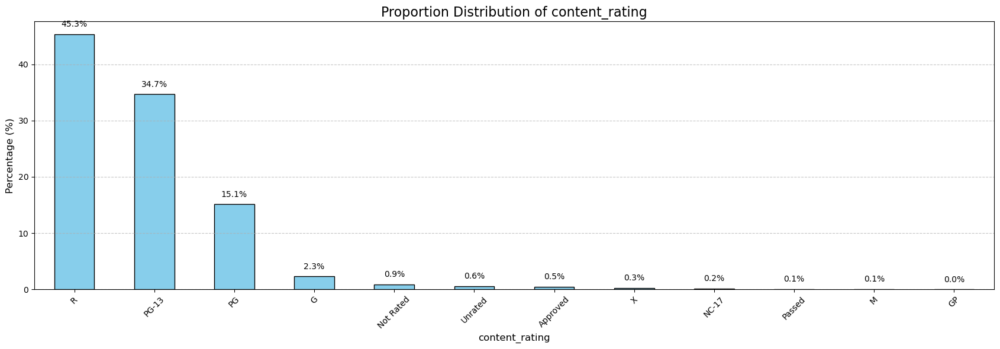

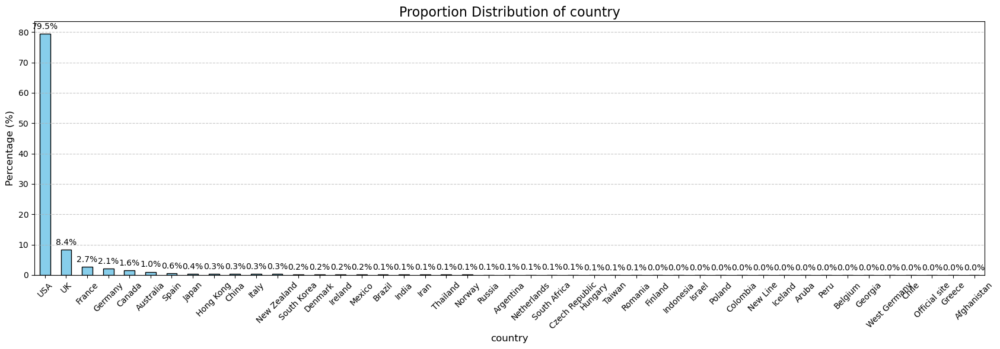

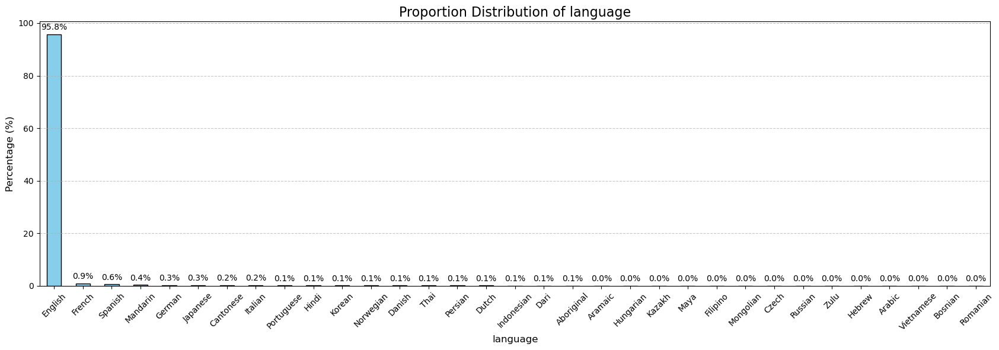

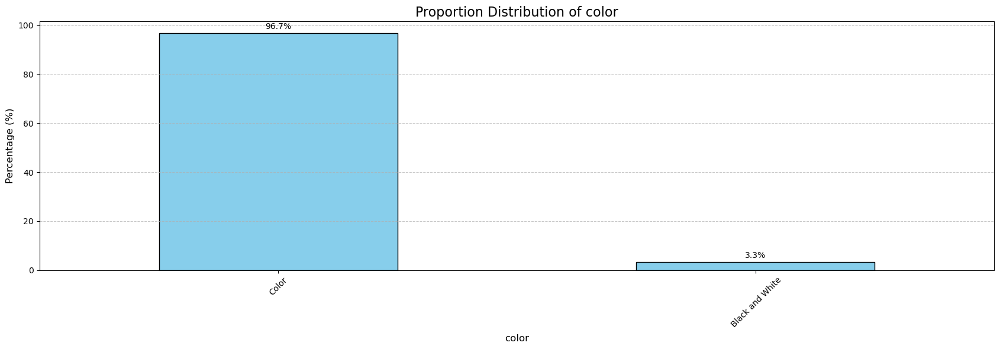

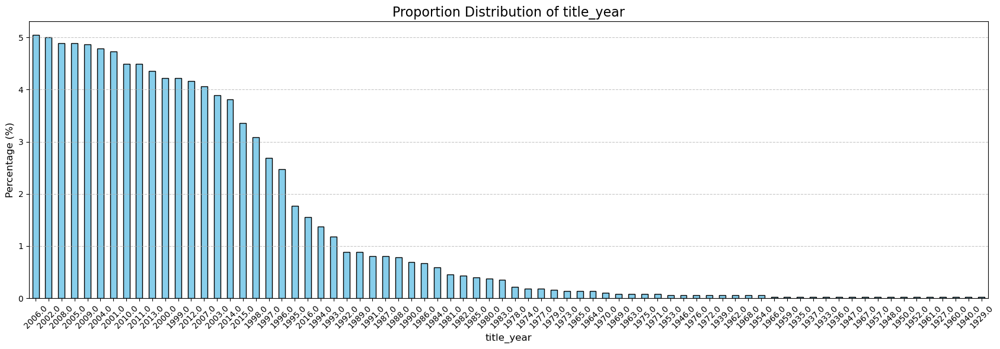

In [179]:
cat_column_list = ["content_rating", "country", "language", "color", "title_year"]

for x in cat_column_list:
    proportions = cleaned_data[x].value_counts(normalize=True) * 100
    
    plt.figure(figsize=(17, 6))
    bar_chart = proportions.plot(kind='bar', color='skyblue', edgecolor='black')

    if (x!= "title_year"):
        for index, value in enumerate(proportions):
            plt.text(index, value + 1, f'{value:.1f}%', ha='center', va='bottom', fontsize=10, color='black')
    
    plt.title(f'Proportion Distribution of {x}', fontsize=16)
    plt.ylabel('Percentage (%)', fontsize=12)
    plt.xlabel(f'{x}', fontsize=12)
    plt.xticks(rotation=45)
    plt.grid(axis='y', linestyle='--', alpha=0.7)
    plt.tight_layout()
    plt.show()

#### Numerical Variable Distribution

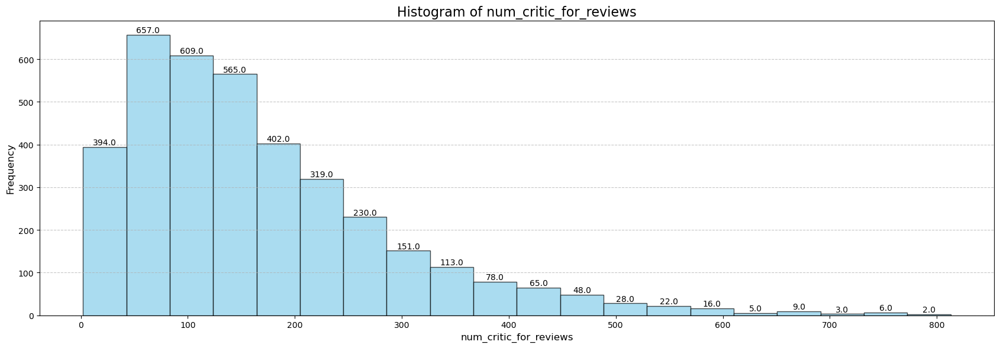

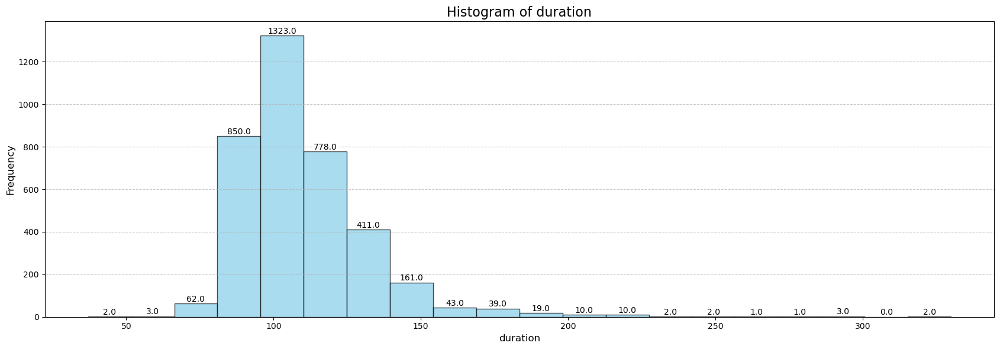

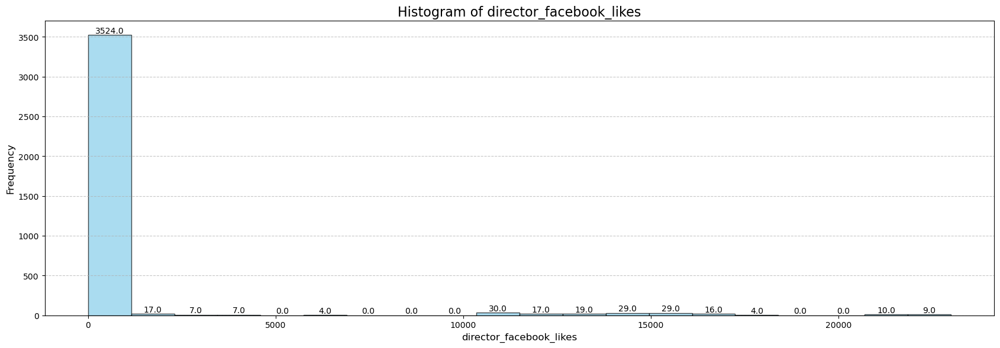

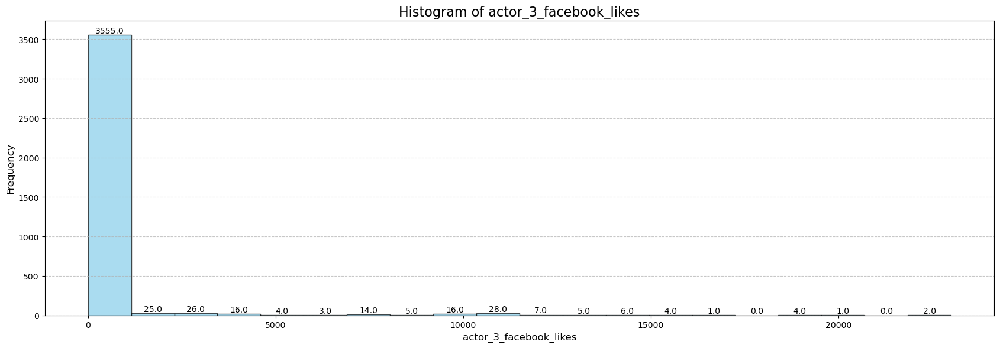

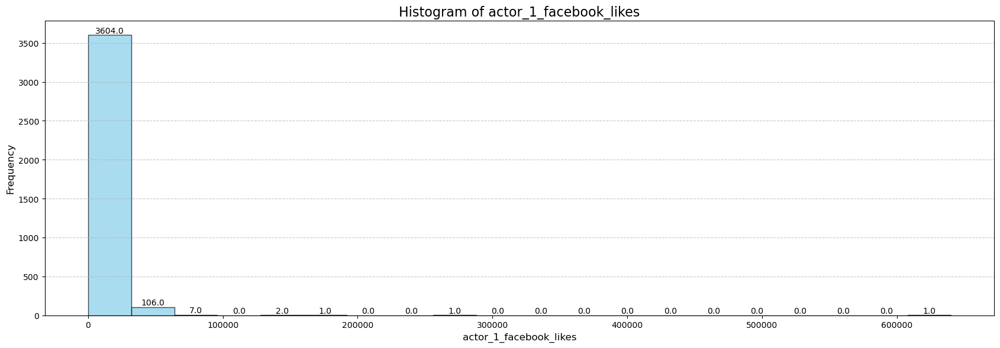

...

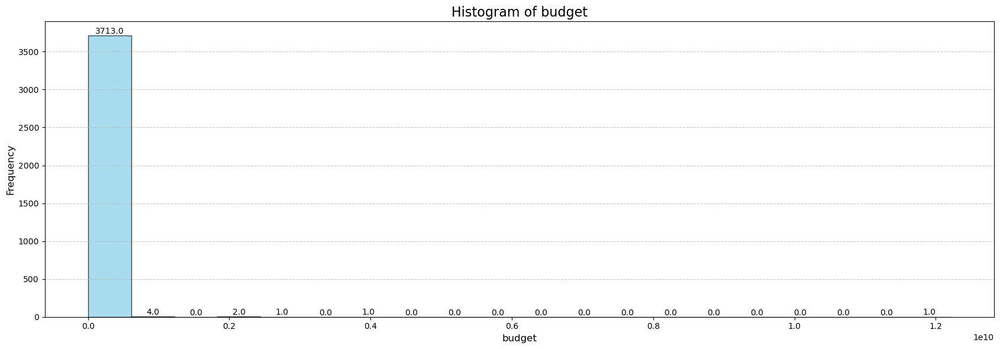

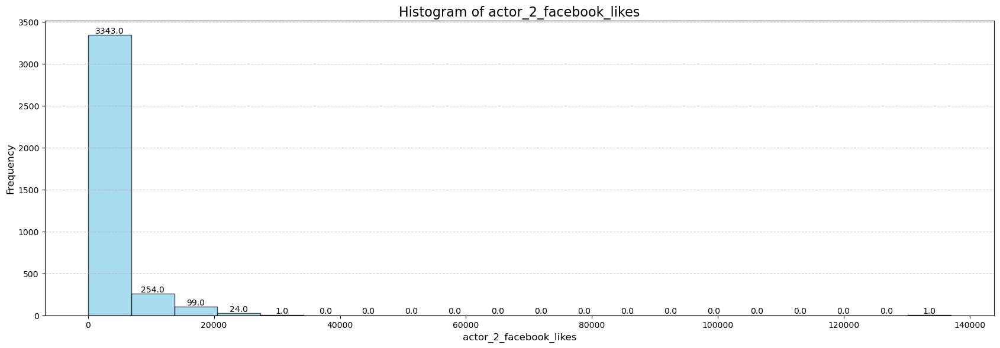

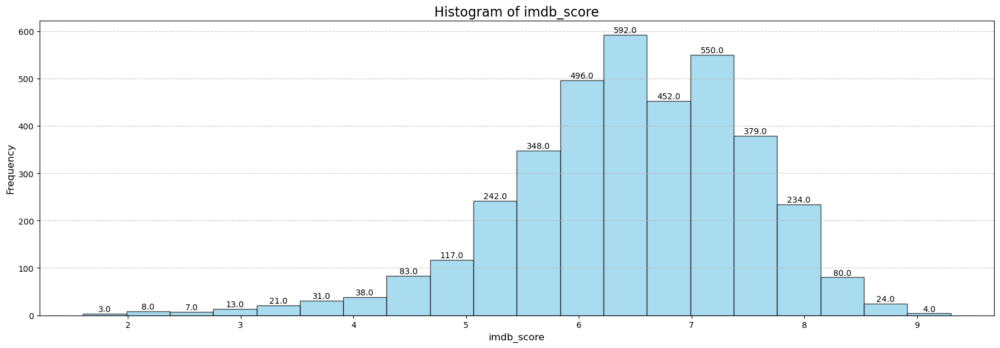

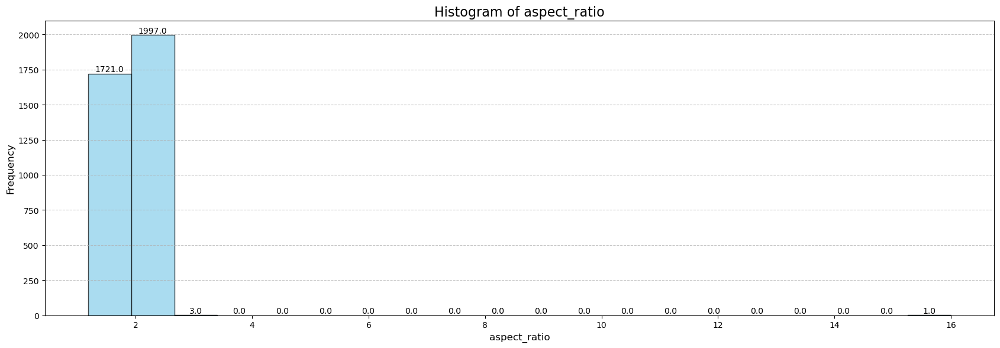

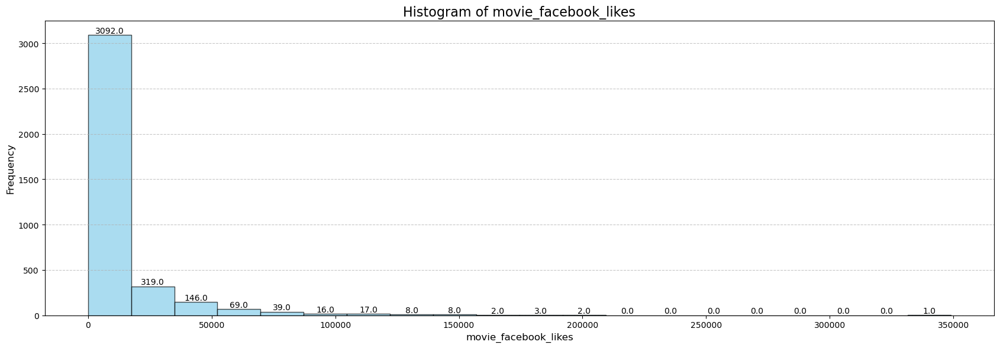

In [181]:
number_column_list = ["num_critic_for_reviews", "duration", "director_facebook_likes", "actor_3_facebook_likes","actor_1_facebook_likes","gross","num_voted_users","cast_total_facebook_likes","facenumber_in_poster","num_user_for_reviews", "budget", "actor_2_facebook_likes", "imdb_score", "aspect_ratio", "movie_facebook_likes"]

for x in number_column_list:
    plt.figure(figsize=(17, 6))
    n, bins, patches = plt.hist(cleaned_data[x], bins=20, edgecolor='black', color='skyblue', alpha=0.7)
    
    for i in range(len(bins) - 1):
        bin_center = (bins[i] + bins[i + 1]) / 2
        plt.text(bin_center, n[i] + 1, f'{n[i]:.1f}', ha='center', va='bottom', fontsize=10, color='black')

    plt.title(f'Histogram of {x}', fontsize=16)
    plt.xlabel(f'{x}', fontsize=12)
    plt.ylabel('Frequency', fontsize=12)
    plt.grid(axis='y', linestyle='--', alpha=0.7)
    plt.tight_layout()
    plt.show()


## Data Exploration and Visualization (After Removing Outliers)

#### Categorical Variable Distribution

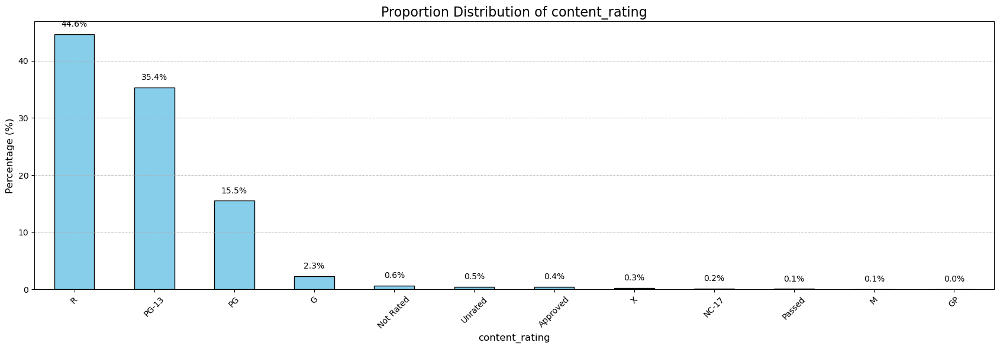

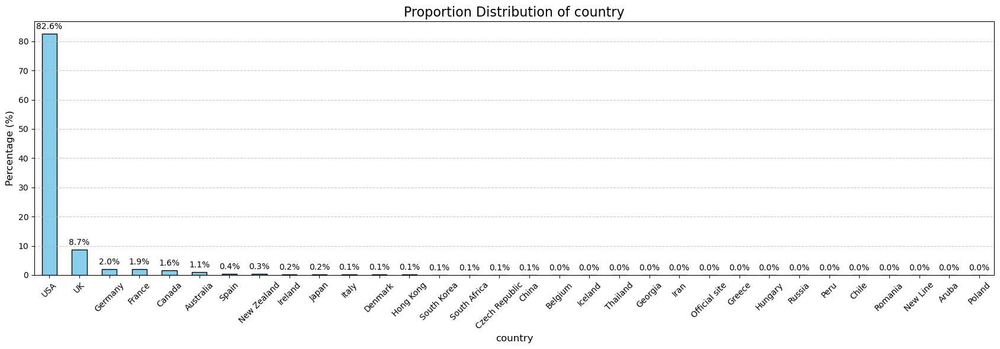

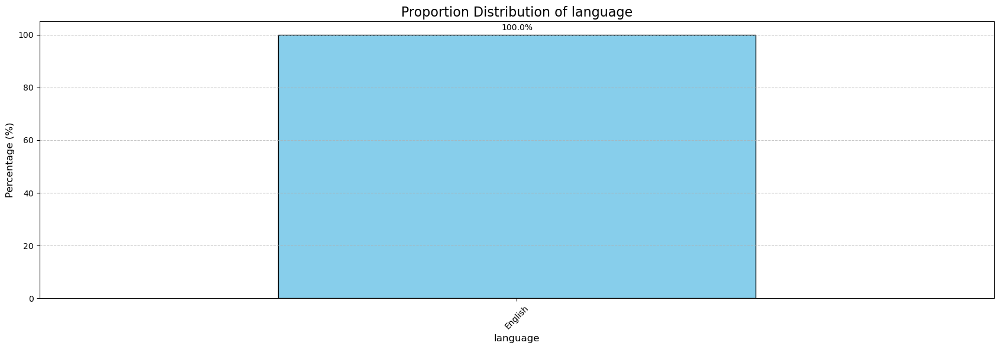

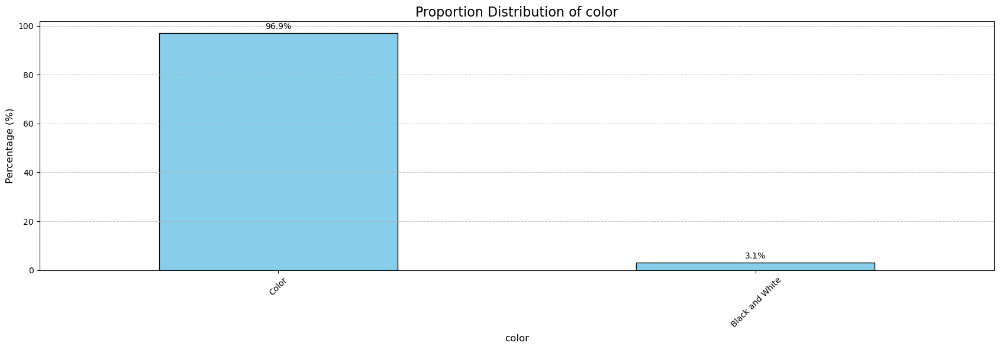

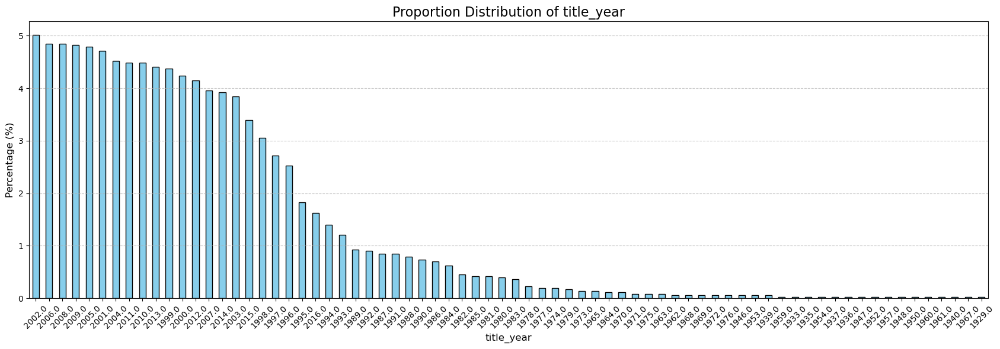

In [156]:
cat_column_list = ["content_rating", "country", "language", "color", "title_year"]

for x in cat_column_list:
    proportions = cleaned_data[x].value_counts(normalize=True) * 100
    
    plt.figure(figsize=(17, 6))
    bar_chart = proportions.plot(kind='bar', color='skyblue', edgecolor='black')

    if (x!= "title_year"):
        for index, value in enumerate(proportions):
            plt.text(index, value + 1, f'{value:.1f}%', ha='center', va='bottom', fontsize=10, color='black')
    
    plt.title(f'Proportion Distribution of {x}', fontsize=16)
    plt.ylabel('Percentage (%)', fontsize=12)
    plt.xlabel(f'{x}', fontsize=12)
    plt.xticks(rotation=45)
    plt.grid(axis='y', linestyle='--', alpha=0.7)
    plt.tight_layout()
    plt.show()

#### Numerical Variable Distribution

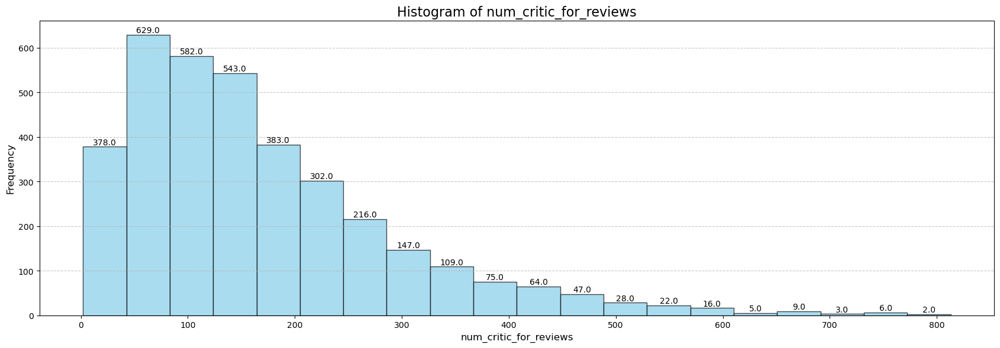

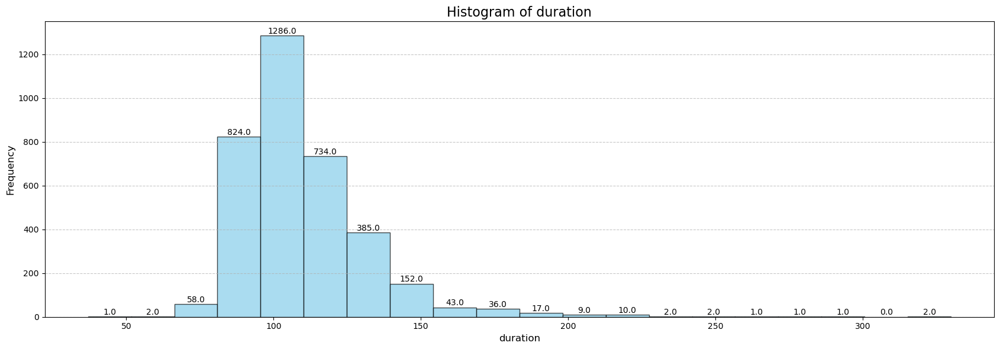

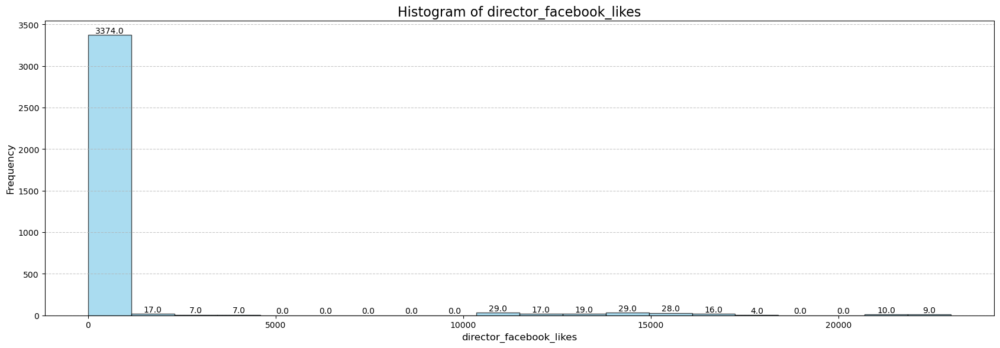

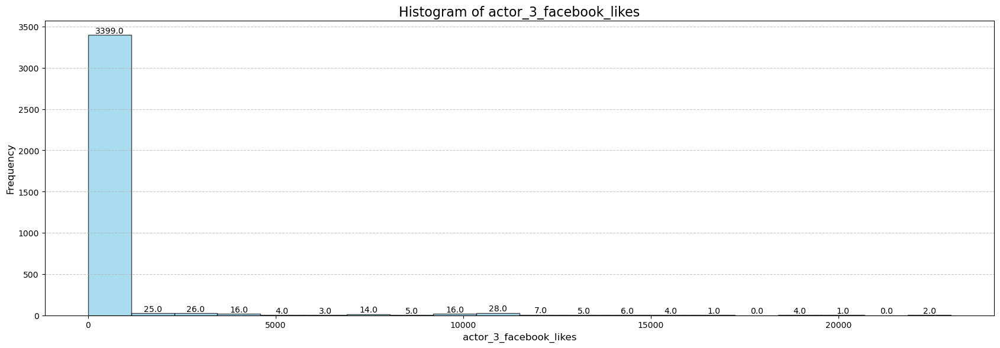

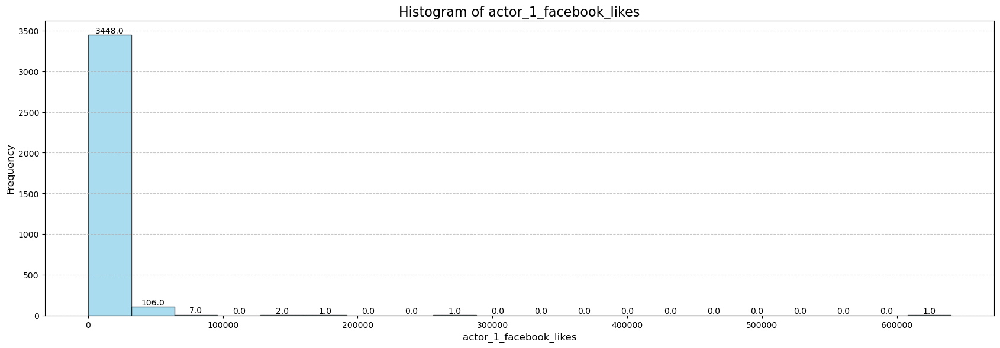

...

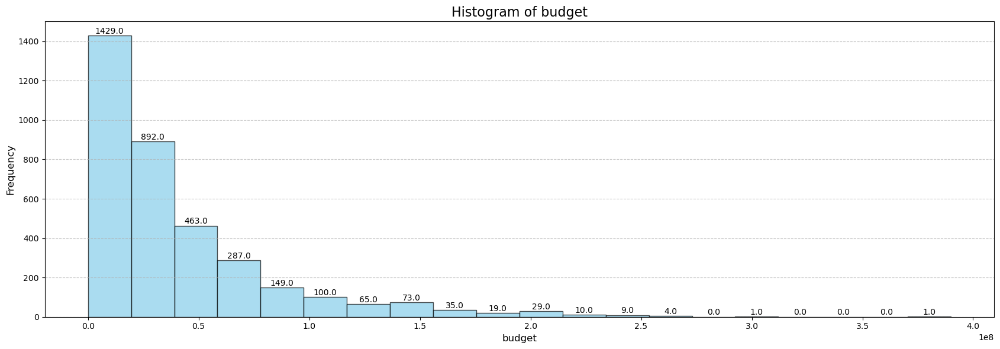

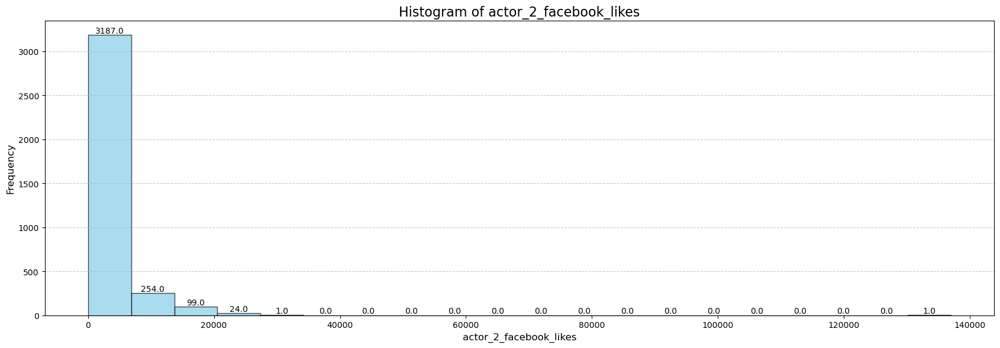

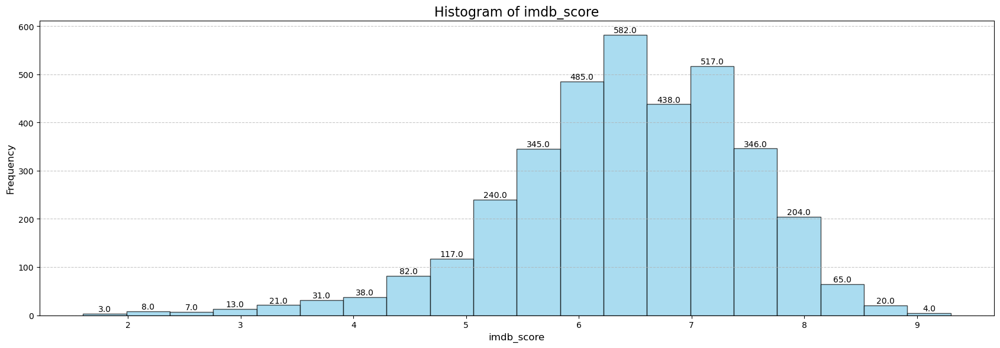

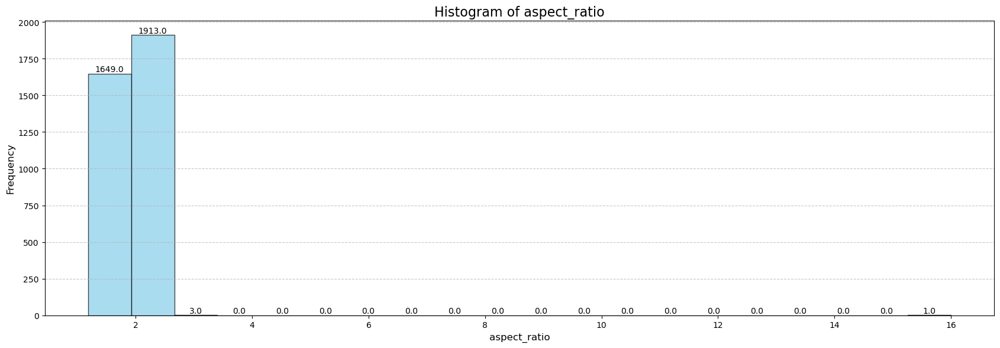

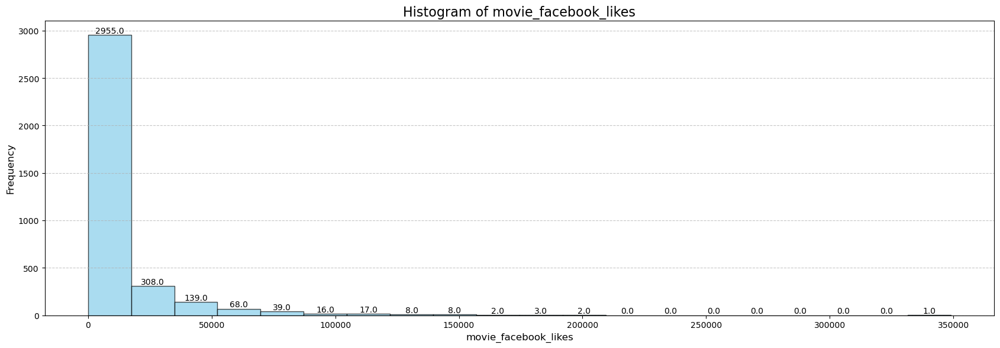

In [158]:
number_column_list = ["num_critic_for_reviews", "duration", "director_facebook_likes", "actor_3_facebook_likes","actor_1_facebook_likes","gross","num_voted_users","cast_total_facebook_likes","facenumber_in_poster","num_user_for_reviews", "budget", "actor_2_facebook_likes", "imdb_score", "aspect_ratio", "movie_facebook_likes"]

for x in number_column_list:
    plt.figure(figsize=(17, 6))
    n, bins, patches = plt.hist(cleaned_data[x], bins=20, edgecolor='black', color='skyblue', alpha=0.7)
    
    for i in range(len(bins) - 1):
        bin_center = (bins[i] + bins[i + 1]) / 2
        plt.text(bin_center, n[i] + 1, f'{n[i]:.1f}', ha='center', va='bottom', fontsize=10, color='black')

    plt.title(f'Histogram of {x}', fontsize=16)
    plt.xlabel(f'{x}', fontsize=12)
    plt.ylabel('Frequency', fontsize=12)
    plt.grid(axis='y', linestyle='--', alpha=0.7)
    plt.tight_layout()
    plt.show()

## Data Engineering and Pre Processing

#### Dropping Variables with Too Much Unique Values Like Names

In [166]:
name_variables = ["director_name", "actor_2_name", "actor_1_name", "movie_title", "actor_3_name", "plot_keywords", "movie_imdb_link"]

clean_data_no_names = cleaned_data.drop(name_variables, axis = 1)

# Exporting Dataset
# clean_data_no_names.to_csv("C:/Users/winot/OneDrive/Desktop/UCI Academics/2. Fall 2024/Data Programming Analytics/Project/Cleaned Data No Names.csv")

We are dropping the name columns because they have too much unique values and dummying these variables will not be ideal. So we will be dropping these 7 columns

#### Aggregating the Genre Column

This process is done in Excel. We've never learned any technique in class and i couldn't find a solution through stack overflow on how to separate the following genre format "Action|Adventure|Fantasy|Sci-Fi." Excel has a feature to separate values based on a character like "|". So what we did was separate the genres based on the "|" and created a frequency table showing the top 6 genres. Then we ran an if statement to see if each row contains a particular genre like "Action." If it does, then the genre_action column will be ticked as 1, and 0 if it doesn't. Basically, we've dummied the genre column based on the top 6 variables through excel.The table below shows the genres that have been dummied through excel. 

In [174]:
clean_data_genre_engineered.head()

,color,num_critic_for_reviews,duration,director_facebook_likes,actor_3_facebook_likes,actor_1_facebook_likes,gross,Genre_Drama,Genre_Comedy,Genre_Thriller,...,num_user_for_reviews,language,country,content_rating,budget,title_year,actor_2_facebook_likes,imdb_score,aspect_ratio,movie_facebook_likes
0,Color,723,178,0,855,1000,760505847,0,0,0,...,3054,English,USA,PG-13,237000000,2009,936,7.9,1.78,33000
1,Color,302,169,563,1000,40000,309404152,0,0,0,...,1238,English,USA,PG-13,300000000,2007,5000,7.1,2.35,0
2,Color,602,148,0,161,11000,200074175,0,0,1,...,994,English,UK,PG-13,245000000,2015,393,6.8,2.35,85000
3,Color,813,164,22000,23000,27000,448130642,0,0,1,...,2701,English,USA,PG-13,250000000,2012,23000,8.5,2.35,164000
4,Color,462,132,475,530,640,73058679,0,0,0,...,738,English,USA,PG-13,263700000,2012,632,6.6,2.35,24000


#### One Hot Encoding

In [176]:
dummy_data = pd.get_dummies(clean_data_genre_engineered)

In [178]:
pd.set_option('display.max_columns', None)
dummy_data.head()

,num_critic_for_reviews,duration,director_facebook_likes,actor_3_facebook_likes,actor_1_facebook_likes,gross,Genre_Drama,Genre_Comedy,Genre_Thriller,Genre_Action,Genre_Romance,Genre_Adventure,num_voted_users,cast_total_facebook_likes,facenumber_in_poster,num_user_for_reviews,budget,title_year,actor_2_facebook_likes,imdb_score,aspect_ratio,movie_facebook_likes,color_ Black and White,color_Color,language_English,country_Aruba,country_Australia,country_Belgium,country_Canada,country_Chile,country_China,country_Czech Republic,country_Denmark,country_France,country_Georgia,country_Germany,country_Greece,country_Hong Kong,country_Hungary,country_Iceland,country_Iran,country_Ireland,country_Italy,country_Japan,country_New Line,country_New Zealand,country_Official site,country_Peru,country_Poland,country_Romania,country_Russia,country_South Africa,country_South Korea,country_Spain,country_Thailand,country_UK,country_USA,content_rating_Approved,content_rating_G,content_rating_GP,content_rating_M,content_rating_NC-17,content_rating_Not Rated,content_rating_PG,content_rating_PG-13,content_rating_Passed,content_rating_R,content_rating_Unrated,content_rating_X
0,723,178,0,855,1000,760505847,0,0,0,1,0,1,886204,4834,0,3054,237000000,2009,936,7.9,1.78,33000,False,True,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,True,False,False,False,False
1,302,169,563,1000,40000,309404152,0,0,0,1,0,1,471220,48350,0,1238,300000000,2007,5000,7.1,2.35,0,False,True,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,True,False,False,False,False
2,602,148,0,161,11000,200074175,0,0,1,1,0,1,275868,11700,1,994,245000000,2015,393,6.8,2.35,85000,False,True,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,True,False,False,False,False
3,813,164,22000,23000,27000,448130642,0,0,1,1,0,0,1144337,106759,0,2701,250000000,2012,23000,8.5,2.35,164000,False,True,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,True,False,False,False,False
4,462,132,475,530,640,73058679,0,0,0,1,0,1,212204,1873,1,738,263700000,2012,632,6.6,2.35,24000,False,True,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,True,False,False,False,False


This process simply dummies the categorical data.

In [180]:
# Exporting Dataset
dummy_data.to_csv("C:/Users/winot/OneDrive/Desktop/UCI Academics/2. Fall 2024/Data Programming Analytics/Project/Dummy Data.csv")

#### Consolidating Dummy Variables

After dummying all the categorical variables, the number of variables in the dataset jumped from 26 columns to 114 columns. This is because some categorical variables like country, language, and content rating have more than 30 unqiue categories within each variable. Because of this, we decided to keep the top 3 categories with the highest proportion in each of these variables and place the remaining categories into the 'other' group. This 'other' will serve as the reference dummy variable in the dataset. 

Content rating --> R, PG-13, PG, and others (G, Not Rated, Approved, X, GP, etc)

Language --> All movies in english language so we removed the language column

Country --> USA, UK, France and others (Germany, Indonesia, Canada, Australia, etc)

We excluded the variables we wanted to delete from the "variables_to_keep" column.

In [211]:
variables_to_keep = [
    'num_critic_for_reviews', 'duration', 'director_facebook_likes',
    'actor_3_facebook_likes', 'actor_1_facebook_likes', 'gross',
    'Genre_Drama', 'Genre_Comedy', 'Genre_Thriller', 'Genre_Action',
    'Genre_Romance', 'Genre_Adventure', 'num_voted_users',
    'cast_total_facebook_likes', 'facenumber_in_poster', 'num_user_for_reviews',
    'budget', 'title_year', 'actor_2_facebook_likes', 'imdb_score',
    'aspect_ratio', 'movie_facebook_likes', 'color_Color',
    'country_USA', 'country_UK',
    'country_France', 'content_rating_PG', 'content_rating_PG-13',
    'content_rating_R']

dummy_data_consolidated = dummy_data[variables_to_keep]

In [213]:
dummy_data_consolidated.head()

,num_critic_for_reviews,duration,director_facebook_likes,actor_3_facebook_likes,actor_1_facebook_likes,gross,Genre_Drama,Genre_Comedy,Genre_Thriller,Genre_Action,Genre_Romance,Genre_Adventure,num_voted_users,cast_total_facebook_likes,facenumber_in_poster,num_user_for_reviews,budget,title_year,actor_2_facebook_likes,imdb_score,aspect_ratio,movie_facebook_likes,color_Color,country_USA,country_UK,country_France,content_rating_PG,content_rating_PG-13,content_rating_R
0,723,178,0,855,1000,760505847,0,0,0,1,0,1,886204,4834,0,3054,237000000,2009,936,7.9,1.78,33000,True,True,False,False,False,True,False
1,302,169,563,1000,40000,309404152,0,0,0,1,0,1,471220,48350,0,1238,300000000,2007,5000,7.1,2.35,0,True,True,False,False,False,True,False
2,602,148,0,161,11000,200074175,0,0,1,1,0,1,275868,11700,1,994,245000000,2015,393,6.8,2.35,85000,True,False,True,False,False,True,False
3,813,164,22000,23000,27000,448130642,0,0,1,1,0,0,1144337,106759,0,2701,250000000,2012,23000,8.5,2.35,164000,True,True,False,False,False,True,False
4,462,132,475,530,640,73058679,0,0,0,1,0,1,212204,1873,1,738,263700000,2012,632,6.6,2.35,24000,True,True,False,False,False,True,False


In [215]:
dummy_data_consolidated.shape

(3566, 29)

In [217]:
# Exporting Dataset
dummy_data_consolidated.to_csv("C:/Users/winot/OneDrive/Desktop/UCI Academics/2. Fall 2024/Data Programming Analytics/Project/Dummy Data Consolidated.csv")

#### Finalizing Dummy Data (True / False --> 1 / 0)

In [221]:
dummy_data_consolidated.loc[:, "color_Color"] = dummy_data_consolidated["color_Color"].apply(lambda x: 1 if x == True else 0)

dummy_data_consolidated.loc[:, "country_USA"] = dummy_data_consolidated["country_USA"].apply(lambda x: 1 if x == True else 0)
dummy_data_consolidated.loc[:, "country_UK"] = dummy_data_consolidated["country_UK"].apply(lambda x: 1 if x == True else 0)
dummy_data_consolidated.loc[:, "country_France"] = dummy_data_consolidated["country_France"].apply(lambda x: 1 if x == True else 0)

dummy_data_consolidated.loc[:, "content_rating_PG"] = dummy_data_consolidated["content_rating_PG"].apply(lambda x: 1 if x == True else 0)
dummy_data_consolidated.loc[:, "content_rating_PG-13"] = dummy_data_consolidated["content_rating_PG-13"].apply(lambda x: 1 if x == True else 0)
dummy_data_consolidated.loc[:, "content_rating_R"] = dummy_data_consolidated["content_rating_R"].apply(lambda x: 1 if x == True else 0)

This process simply changes the dummy variables from True and False to 1 and 0. 

In [223]:
dummy_data_consolidated.head()

,num_critic_for_reviews,duration,director_facebook_likes,actor_3_facebook_likes,actor_1_facebook_likes,gross,Genre_Drama,Genre_Comedy,Genre_Thriller,Genre_Action,Genre_Romance,Genre_Adventure,num_voted_users,cast_total_facebook_likes,facenumber_in_poster,num_user_for_reviews,budget,title_year,actor_2_facebook_likes,imdb_score,aspect_ratio,movie_facebook_likes,color_Color,country_USA,country_UK,country_France,content_rating_PG,content_rating_PG-13,content_rating_R
0,723,178,0,855,1000,760505847,0,0,0,1,0,1,886204,4834,0,3054,237000000,2009,936,7.9,1.78,33000,1,1,0,0,0,1,0
1,302,169,563,1000,40000,309404152,0,0,0,1,0,1,471220,48350,0,1238,300000000,2007,5000,7.1,2.35,0,1,1,0,0,0,1,0
2,602,148,0,161,11000,200074175,0,0,1,1,0,1,275868,11700,1,994,245000000,2015,393,6.8,2.35,85000,1,0,1,0,0,1,0
3,813,164,22000,23000,27000,448130642,0,0,1,1,0,0,1144337,106759,0,2701,250000000,2012,23000,8.5,2.35,164000,1,1,0,0,0,1,0
4,462,132,475,530,640,73058679,0,0,0,1,0,1,212204,1873,1,738,263700000,2012,632,6.6,2.35,24000,1,1,0,0,0,1,0


In [225]:
dummy_data_consolidated.shape

(3566, 29)

In [227]:
# Exporting Dataset
# dummy_data_consolidated.to_csv("C:/Users/winot/OneDrive/Desktop/UCI Academics/2. Fall 2024/Data Programming Analytics/Project/Completed Dummy Data.csv")

#### Checking for Multicollineary using Heatmap

In [233]:
# completed_dummy_data = pd.read_csv("C:/Users/winot/OneDrive/Desktop/UCI Academics/2. Fall 2024/Data Programming Analytics/Project/Completed Dummy Data.csv")

completed_dummy_data = dummy_data_consolidated.copy()

In [235]:
completed_dummy_data.head()

,num_critic_for_reviews,duration,director_facebook_likes,actor_3_facebook_likes,actor_1_facebook_likes,gross,Genre_Drama,Genre_Comedy,Genre_Thriller,Genre_Action,Genre_Romance,Genre_Adventure,num_voted_users,cast_total_facebook_likes,facenumber_in_poster,num_user_for_reviews,budget,title_year,actor_2_facebook_likes,imdb_score,aspect_ratio,movie_facebook_likes,color_Color,country_USA,country_UK,country_France,content_rating_PG,content_rating_PG-13,content_rating_R
0,723,178,0,855,1000,760505847,0,0,0,1,0,1,886204,4834,0,3054,237000000,2009,936,7.9,1.78,33000,1,1,0,0,0,1,0
1,302,169,563,1000,40000,309404152,0,0,0,1,0,1,471220,48350,0,1238,300000000,2007,5000,7.1,2.35,0,1,1,0,0,0,1,0
2,602,148,0,161,11000,200074175,0,0,1,1,0,1,275868,11700,1,994,245000000,2015,393,6.8,2.35,85000,1,0,1,0,0,1,0
3,813,164,22000,23000,27000,448130642,0,0,1,1,0,0,1144337,106759,0,2701,250000000,2012,23000,8.5,2.35,164000,1,1,0,0,0,1,0
4,462,132,475,530,640,73058679,0,0,0,1,0,1,212204,1873,1,738,263700000,2012,632,6.6,2.35,24000,1,1,0,0,0,1,0


In [237]:
completed_dummy_data.shape

(3566, 29)

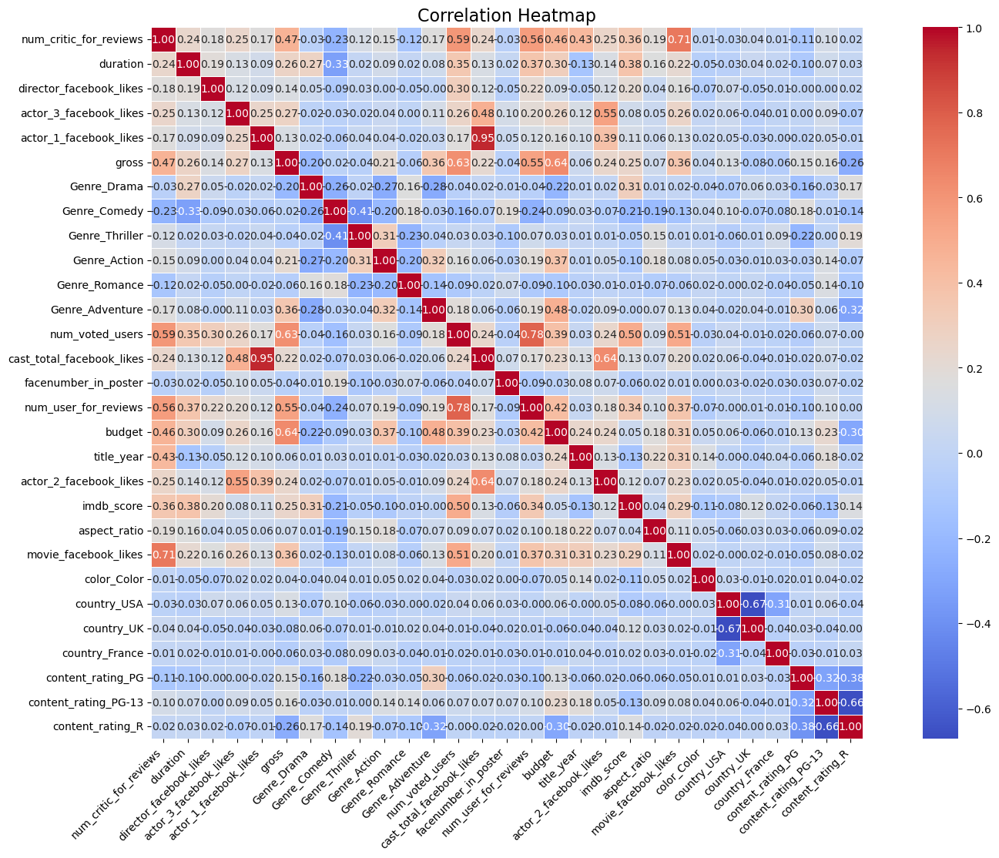

In [239]:
correlation_matrix = completed_dummy_data.corr()

plt.figure(figsize=(20, 12))  

sns.heatmap(
    correlation_matrix,
    annot=True,  
    fmt='.2f',   
    cmap='coolwarm',  
    square=True,  
    cbar=True,    
    linewidths=0.5,  
)

plt.xticks(rotation=45, ha='right')  
plt.yticks(rotation=0)  
plt.title('Correlation Heatmap', fontsize=16)
plt.show()

As seen in the heatmap, cast_total_facebook likes and actor_1_facebook likes are very highly correlated with 0.95 correlation. 

One of these two variables will be dropped to mitigate any multicollinearity issues with the model. We decided to drop actor_1_facebook likes is already represented within the cast_total_facebook_likes. 

In [241]:
completed_dummy_data.drop("actor_1_facebook_likes", axis = 1, inplace = True)

In [243]:
completed_dummy_data.shape

(3566, 28)

#### Engineering the Dependent Variable

Instead of using the actual IMDB_score which is a contineous variable ranging from 1 to 10, we will categorize the movie rating values in three groups. 
> Good movies --> IMDB >= 7.5

> Mediocre movies --> IMDB >= 5 and IMDB < 7.5

> Poor movies --> IMDB < 5

This new column called imdb_score_category will serve as our model's dependent variable 

In [245]:
completed_dummy_data['imdb_score_category'] = completed_dummy_data['imdb_score'].apply(lambda x: 2 if x >= 7.5 else (1 if 5 <= x < 7.5 else 0))

In [247]:
completed_dummy_data.head()

,num_critic_for_reviews,duration,director_facebook_likes,actor_3_facebook_likes,gross,Genre_Drama,Genre_Comedy,Genre_Thriller,Genre_Action,Genre_Romance,Genre_Adventure,num_voted_users,cast_total_facebook_likes,facenumber_in_poster,num_user_for_reviews,budget,title_year,actor_2_facebook_likes,imdb_score,aspect_ratio,movie_facebook_likes,color_Color,country_USA,country_UK,country_France,content_rating_PG,content_rating_PG-13,content_rating_R,imdb_score_category
0,723,178,0,855,760505847,0,0,0,1,0,1,886204,4834,0,3054,237000000,2009,936,7.9,1.78,33000,1,1,0,0,0,1,0,2
1,302,169,563,1000,309404152,0,0,0,1,0,1,471220,48350,0,1238,300000000,2007,5000,7.1,2.35,0,1,1,0,0,0,1,0,1
2,602,148,0,161,200074175,0,0,1,1,0,1,275868,11700,1,994,245000000,2015,393,6.8,2.35,85000,1,0,1,0,0,1,0,1
3,813,164,22000,23000,448130642,0,0,1,1,0,0,1144337,106759,0,2701,250000000,2012,23000,8.5,2.35,164000,1,1,0,0,0,1,0,2
4,462,132,475,530,73058679,0,0,0,1,0,1,212204,1873,1,738,263700000,2012,632,6.6,2.35,24000,1,1,0,0,0,1,0,1


In [249]:
final_clean_data = completed_dummy_data.drop("imdb_score", axis = 1)

we then dropped the imdb_score because the imdb_score_category already represents the imdb_score.

In [251]:
final_clean_data.head()

,num_critic_for_reviews,duration,director_facebook_likes,actor_3_facebook_likes,gross,Genre_Drama,Genre_Comedy,Genre_Thriller,Genre_Action,Genre_Romance,Genre_Adventure,num_voted_users,cast_total_facebook_likes,facenumber_in_poster,num_user_for_reviews,budget,title_year,actor_2_facebook_likes,aspect_ratio,movie_facebook_likes,color_Color,country_USA,country_UK,country_France,content_rating_PG,content_rating_PG-13,content_rating_R,imdb_score_category
0,723,178,0,855,760505847,0,0,0,1,0,1,886204,4834,0,3054,237000000,2009,936,1.78,33000,1,1,0,0,0,1,0,2
1,302,169,563,1000,309404152,0,0,0,1,0,1,471220,48350,0,1238,300000000,2007,5000,2.35,0,1,1,0,0,0,1,0,1
2,602,148,0,161,200074175,0,0,1,1,0,1,275868,11700,1,994,245000000,2015,393,2.35,85000,1,0,1,0,0,1,0,1
3,813,164,22000,23000,448130642,0,0,1,1,0,0,1144337,106759,0,2701,250000000,2012,23000,2.35,164000,1,1,0,0,0,1,0,2
4,462,132,475,530,73058679,0,0,0,1,0,1,212204,1873,1,738,263700000,2012,632,2.35,24000,1,1,0,0,0,1,0,1


In [253]:
final_clean_data.shape

(3566, 28)

In [255]:
# Exporting Dataset
final_clean_data.to_csv("C:/Users/winot/OneDrive/Desktop/UCI Academics/2. Fall 2024/Data Programming Analytics/Project/Final Cleaned Data.csv")

#### Class Proportion of Target Variable

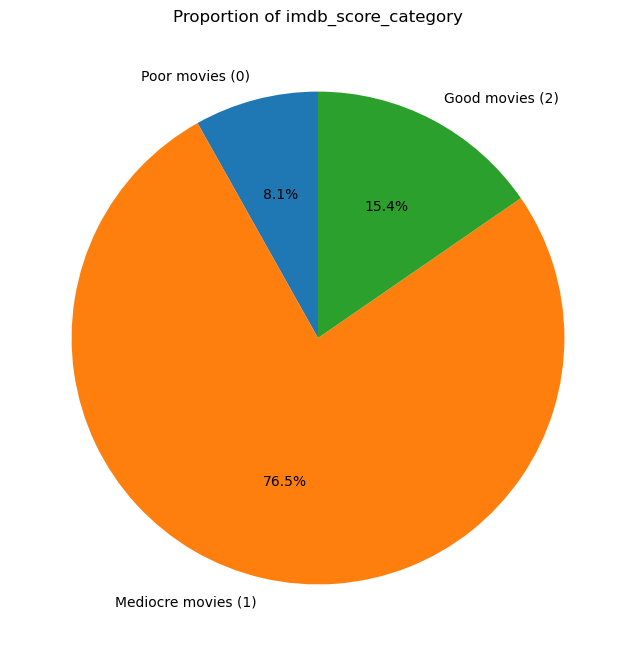

In [188]:
# Counting the values of each class in the target variable 
category_counts = final_clean_data['imdb_score_category'].value_counts()

#Creating the labels and sizes needed to plot the pie chart
labels = ['Poor movies (0)', 'Mediocre movies (1)', 'Good movies (2)']

sizes = [category_counts.get(0, 0), category_counts.get(1, 0), category_counts.get(2, 0)]

plt.figure(figsize=(8, 8))
plt.pie(sizes, labels=labels, autopct='%1.1f%%', startangle=90)
plt.title('Proportion of imdb_score_category')
plt.show()

The class distribution of our dependent variable is very imbalanced and skewed to mediocre movies (1). This might cause issues in modeling and might make our models better at predicting class 1 than classes 0 and 2. 

## Data Modeling

### Data Partitioning

In [192]:
# Splitting the data into x and y and printing their shapes
X = final_clean_data.drop(columns=['imdb_score_category'])
y = final_clean_data['imdb_score_category']
print(X.shape)
print(y.shape)

(3566, 28)
(3566,)


In [194]:
#splitting the data into training and testing variables 
x_train, x_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

We are splitting our training and testing data to a 70:30 proportions. 

### Calculating Proportion of Classes in full data, training, and testing sets

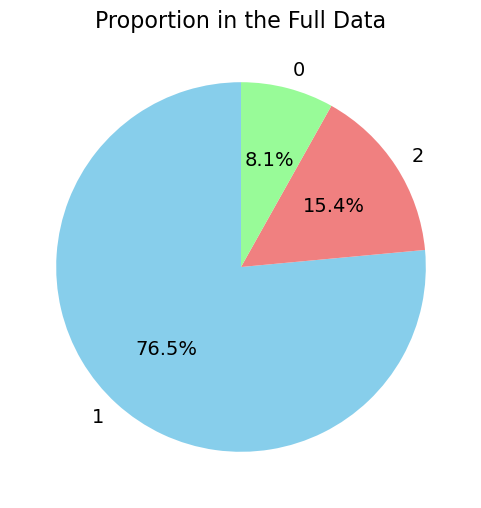

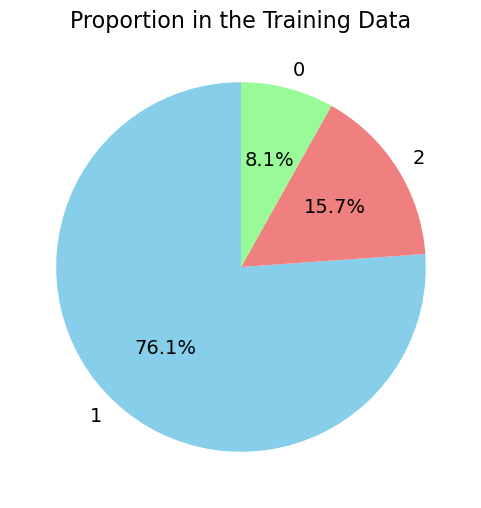

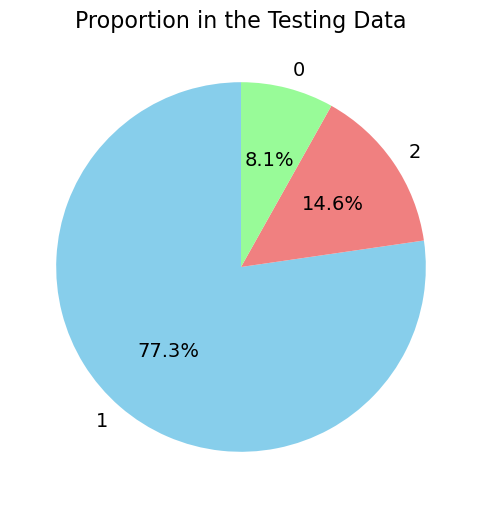

In [196]:
#Counting the values of the target variable 
full_proportion = y.value_counts(normalize=True)
train_proportion = y_train.value_counts(normalize=True)
test_proportion = y_test.value_counts(normalize=True)

#Create a function that prints out the pie charts for each of the target variable's proportion porportions 
def plot_pie_chart(proportions, title):
    labels = proportions.index.map(str)
    sizes = proportions.values
    plt.figure(figsize=(6, 6))
    plt.pie(
        sizes,
        labels=labels,
        autopct='%1.1f%%',
        startangle=90,
        colors=['skyblue', 'lightcoral', 'palegreen'],
        textprops={'fontsize': 14}  
    )
    plt.title(title, fontsize=16) 
    plt.show()

#Displaying the pie charts
plot_pie_chart(full_proportion, "Proportion in the Full Data")
plot_pie_chart(train_proportion, "Proportion in the Training Data")
plot_pie_chart(test_proportion, "Proportion in the Testing Data")

By comparing the pie charts, we can tell that the class distribution for the training and testing is as imbalanced as the original data. SMOTE and other sampling techniques will be used in the next sections to remedy this.

### Decision Tree

#### Decision Tree (Benchmark)

Decision Tree Model Performance:

 > Train score = 100.0%

 > Test score  = 75.42056074766356%

                     precision    recall  f1-score   support

    Poor movies (0)       0.31      0.39      0.34        87
Mediocre movies (1)       0.86      0.83      0.84       827
    Good movies (2)       0.56      0.58      0.57       156

           accuracy                           0.75      1070
          macro avg       0.57      0.60      0.58      1070
       weighted avg       0.77      0.75      0.76      1070

Train Confusion matrix


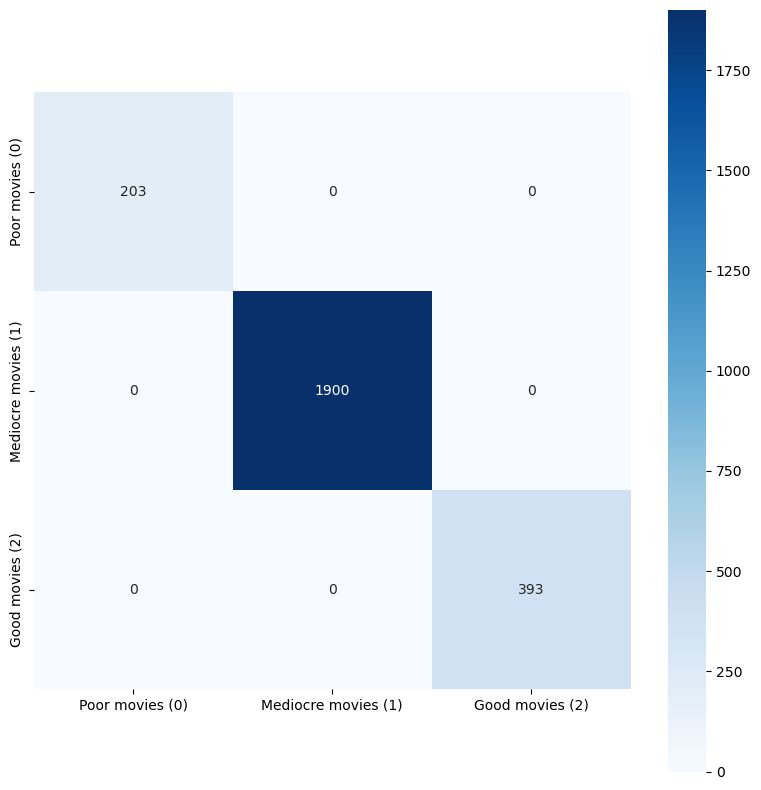

Test Confusion matrix


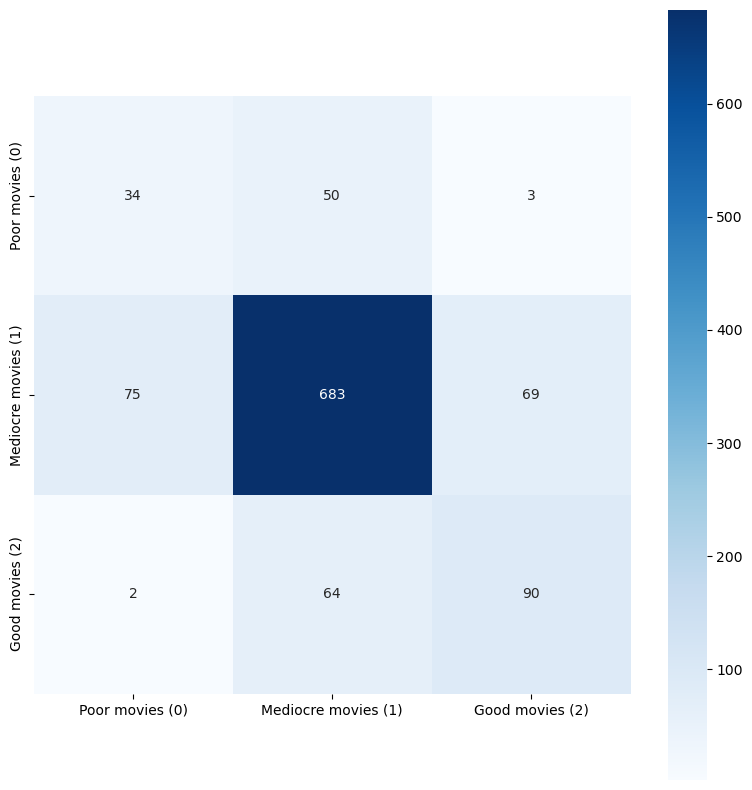

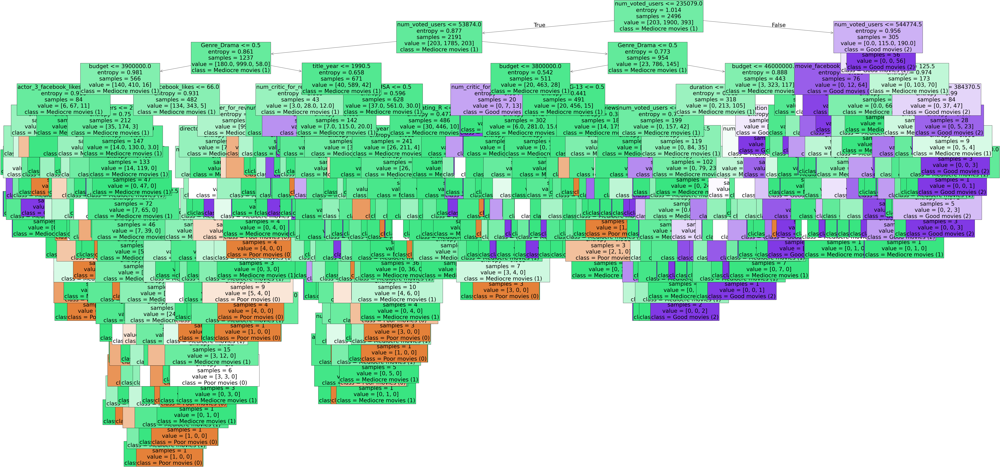

In [269]:
#Making and fitting the model
model = tree.DecisionTreeClassifier(criterion='entropy')
model.fit(x_train, y_train)

y_train_pred = model.predict(x_train)
y_test_pred  = model.predict(x_test)

# Plotting the decision tree performance, confusion matrix, and decision tree
classes = ['Poor movies (0)', 'Mediocre movies (1)', 'Good movies (2)']

print("Decision Tree Model Performance:\n")
print(f' > Train score = {accuracy_score(y_train_pred,y_train)*100}%\n')
print(f' > Test score  = {accuracy_score(y_test_pred,y_test)*100}%\n')

print(classification_report(y_test, y_test_pred, target_names = ['Poor movies (0)', 'Mediocre movies (1)', 'Good movies (2)']))

plot_confusionmatrix(y_train_pred,y_train,dom='Train')
plot_confusionmatrix(y_test_pred,y_test,dom='Test')

fig, ax = plt.subplots(figsize=(96, 48), dpi=100)

features = final_clean_data.columns

tree.plot_tree(model,ax=ax,feature_names=features,class_names=classes, filled=True, fontsize=32)
plt.show()

#### Comments on Benchmark Decision Tree Model

This decision tree model is our benchmark model. The training accuracy is 100% and the test score is 75%. This benchmark model is definitely overfitted. Additionally, the recall accuracy for poor movies and good movies are very low at 39% and 58% respectively. This suggests that the model can predict only 39% and 58% of the actual poor and good movies in the testing dataset. The model is very good at predicting mediocre movies though, with an 83% recall accuracy. This is caused by the depedent variable's class imbalance, since the majority of the class is mediocre movies. Before dealing with the class imbalance issue, we must fix the overfitting issue using pre pruning methods like hyperparamter tuning using gridsearch. This method will help us find the optimal parameters for our decision tree, preventing the tree from growing excessively and risking overfitting like this benchmark model.

#### Decision Tree (Pre Pruning) v1

Best Fit Model
DecisionTreeClassifier(criterion='entropy', max_depth=19, min_samples_leaf=15,
                       min_samples_split=110)

Decision Tree Model Performance:

 > Train score = 82.6923076923077%

 > Test score  = 81.21495327102804%

                     precision    recall  f1-score   support

    Poor movies (0)       0.53      0.10      0.17        87
Mediocre movies (1)       0.84      0.94      0.89       827
    Good movies (2)       0.66      0.52      0.58       156

           accuracy                           0.81      1070
          macro avg       0.68      0.52      0.55      1070
       weighted avg       0.79      0.81      0.78      1070

Train Confusion matrix


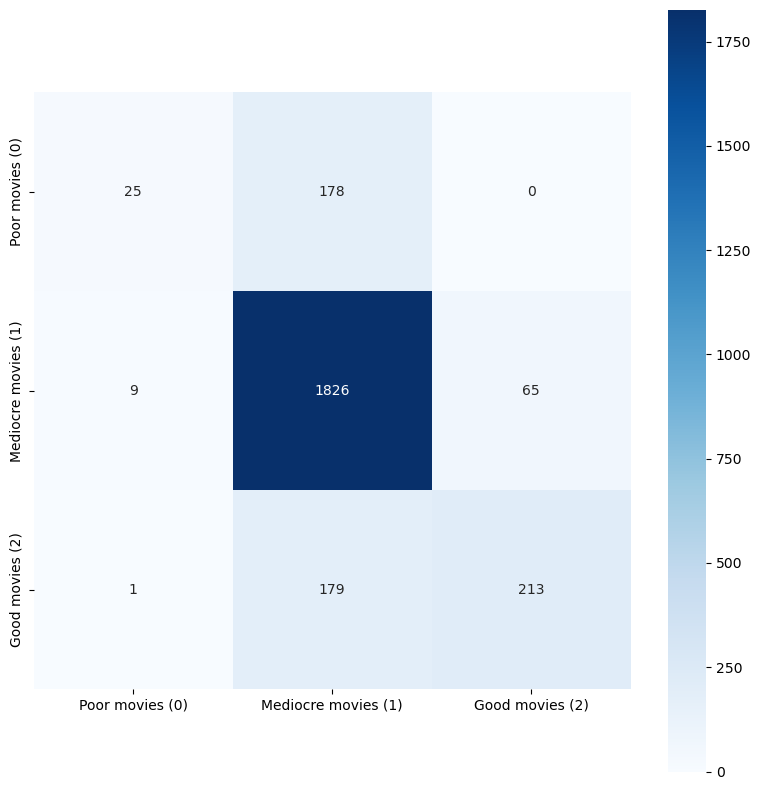

Test Confusion matrix


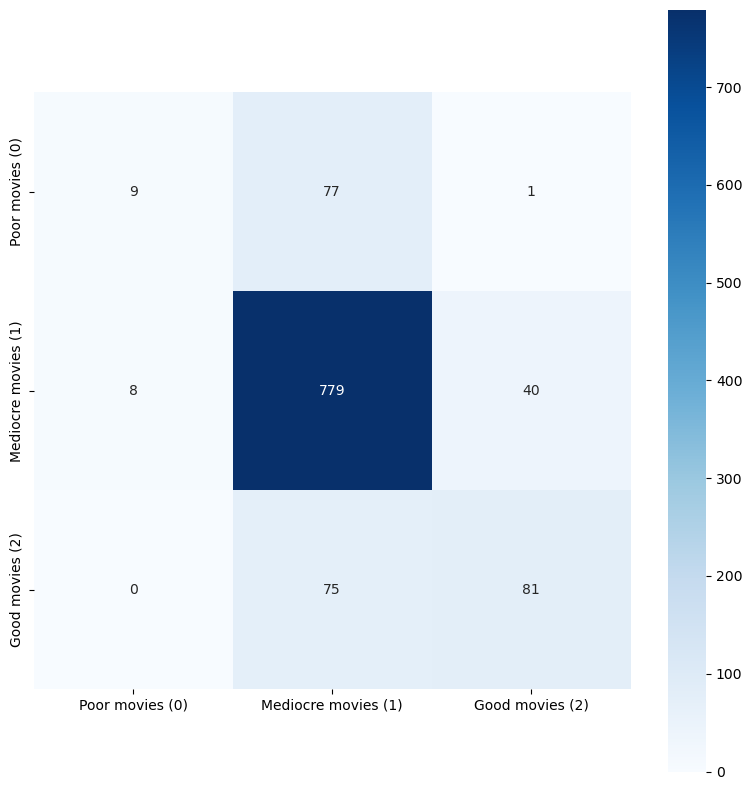

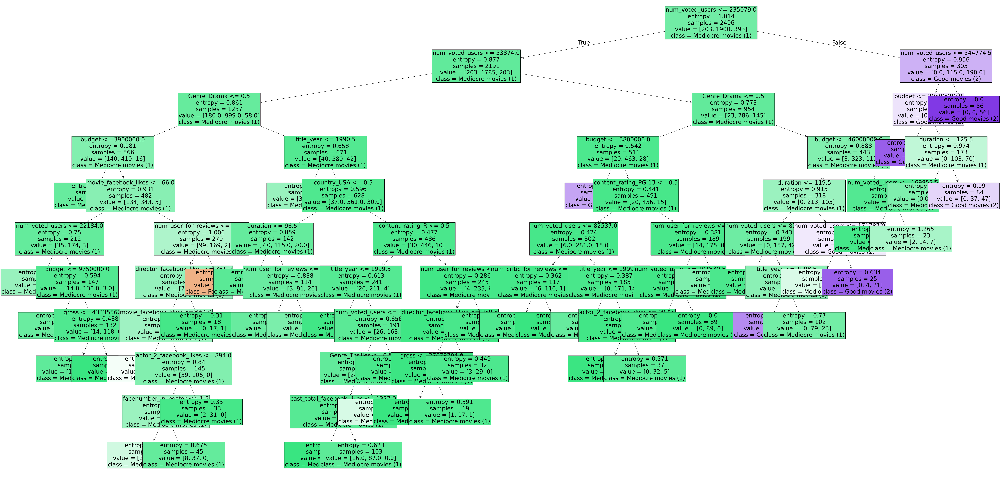

In [271]:
#Setting up the hyperparamter options
params = {
    'max_depth': [19, 20, 21, 22],
    'min_samples_split': [80, 90, 100, 110, 120],
    'min_samples_leaf': [5, 10, 15, 20]
}

#Making and fitting the model
clf = tree.DecisionTreeClassifier(criterion='entropy')
gcv = GridSearchCV(estimator=clf,param_grid=params, cv = 10)
gcv.fit(x_train,y_train)

model = gcv.best_estimator_
print("Best Fit Model")
print(model)
print("")

model.fit(x_train,y_train)
y_train_pred = model.predict(x_train)
y_test_pred = model.predict(x_test)

# Plotting the decision tree performance, confusion matrix, and decision tree
classes = ['Poor movies (0)', 'Mediocre movies (1)', 'Good movies (2)']

print("Decision Tree Model Performance:\n")
print(f' > Train score = {accuracy_score(y_train_pred,y_train)*100}%\n')
print(f' > Test score  = {accuracy_score(y_test_pred,y_test)*100}%\n')

print(classification_report(y_test, y_test_pred, target_names = ['Poor movies (0)', 'Mediocre movies (1)', 'Good movies (2)']))

plot_confusionmatrix(y_train_pred,y_train,dom='Train')
plot_confusionmatrix(y_test_pred,y_test,dom='Test')

fig, ax = plt.subplots(figsize=(96, 48), dpi=100)

features = final_clean_data.columns

tree.plot_tree(model,ax=ax,feature_names=features,class_names=classes, filled=True, fontsize=32)
plt.show()

#### Decision Tree (Pre Pruning) v2

Best Fit Model
DecisionTreeClassifier(criterion='entropy', max_depth=16, min_samples_leaf=35,
                       min_samples_split=40)

Decision Tree Model Performance:

 > Train score = 82.8125%

 > Test score  = 81.21495327102804%

                     precision    recall  f1-score   support

    Poor movies (0)       0.42      0.23      0.30        87
Mediocre movies (1)       0.84      0.94      0.89       827
    Good movies (2)       0.76      0.46      0.57       156

           accuracy                           0.81      1070
          macro avg       0.67      0.54      0.59      1070
       weighted avg       0.79      0.81      0.79      1070

Train Confusion matrix


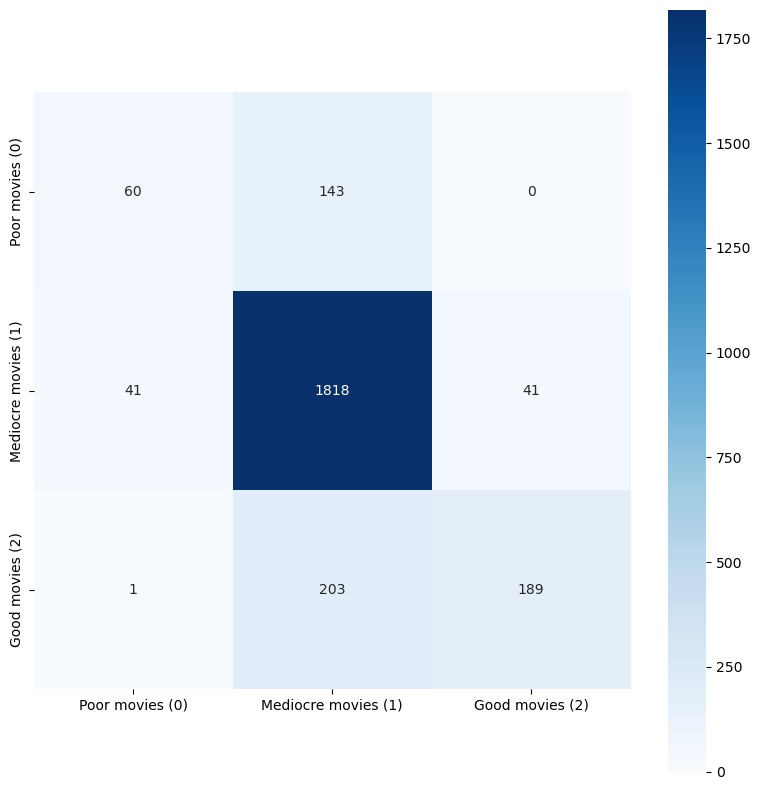

Test Confusion matrix


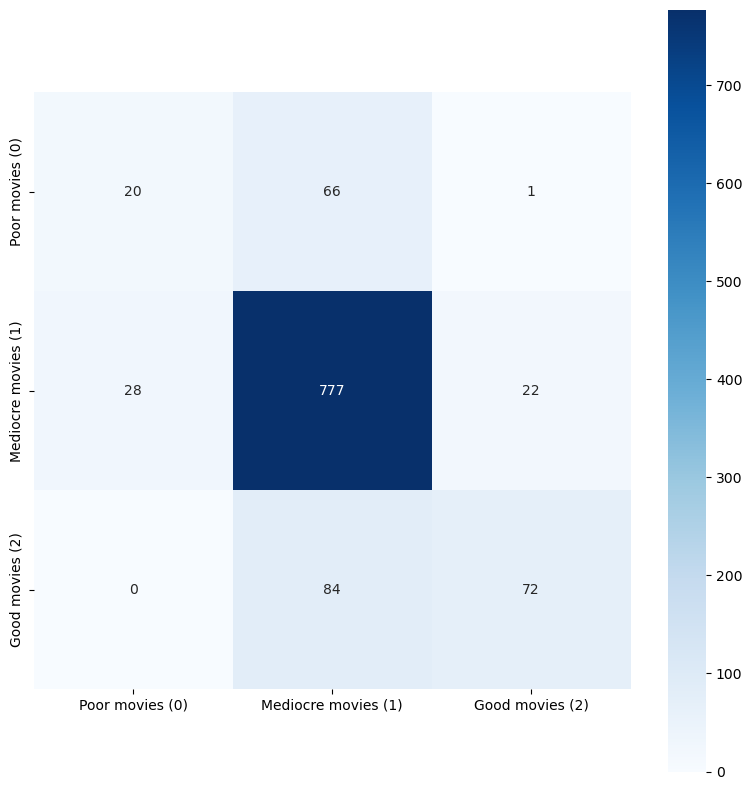

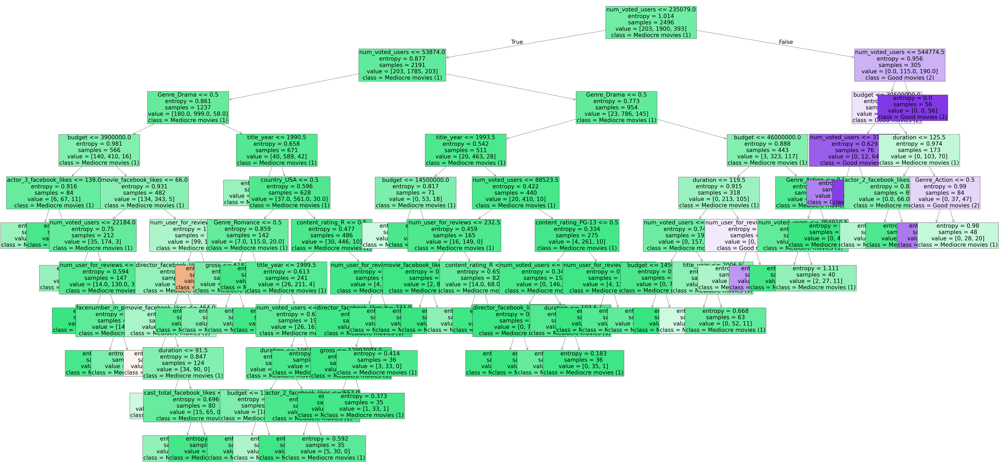

In [273]:
#Setting up the hyperparamter options
params = {
    'max_depth': [15, 16, 17, 18, 19],
    'min_samples_split': [40, 50, 60, 70, 80],
    'min_samples_leaf': [20, 25, 30, 35, 40]
}

#Making and fitting the model
clf = tree.DecisionTreeClassifier(criterion='entropy')
gcv = GridSearchCV(estimator=clf,param_grid=params, cv = 10)
gcv.fit(x_train,y_train)

model = gcv.best_estimator_
print("Best Fit Model")
print(model)
print("")

model.fit(x_train,y_train)
y_train_pred = model.predict(x_train)
y_test_pred = model.predict(x_test)

# Plotting the decision tree performance, confusion matrix, and decision tree
classes = ['Poor movies (0)', 'Mediocre movies (1)', 'Good movies (2)']

print("Decision Tree Model Performance:\n")
print(f' > Train score = {accuracy_score(y_train_pred,y_train)*100}%\n')
print(f' > Test score  = {accuracy_score(y_test_pred,y_test)*100}%\n')

print(classification_report(y_test, y_test_pred, target_names = ['Poor movies (0)', 'Mediocre movies (1)', 'Good movies (2)']))

plot_confusionmatrix(y_train_pred,y_train,dom='Train')
plot_confusionmatrix(y_test_pred,y_test,dom='Test')

fig, ax = plt.subplots(figsize=(96, 48), dpi=100)

features = final_clean_data.columns

tree.plot_tree(model,ax=ax,feature_names=features,class_names=classes, filled=True, fontsize=32)
plt.show()

#### Decision Tree (Pre Pruning) v3

Best Fit Model
DecisionTreeClassifier(criterion='entropy', max_depth=8, min_samples_leaf=40,
                       min_samples_split=30)

Decision Tree Model Performance:

 > Train score = 82.45192307692307%

 > Test score  = 80.28037383177569%

                     precision    recall  f1-score   support

    Poor movies (0)       0.37      0.13      0.19        87
Mediocre movies (1)       0.83      0.94      0.88       827
    Good movies (2)       0.70      0.44      0.54       156

           accuracy                           0.80      1070
          macro avg       0.63      0.50      0.54      1070
       weighted avg       0.77      0.80      0.77      1070

Train Confusion matrix


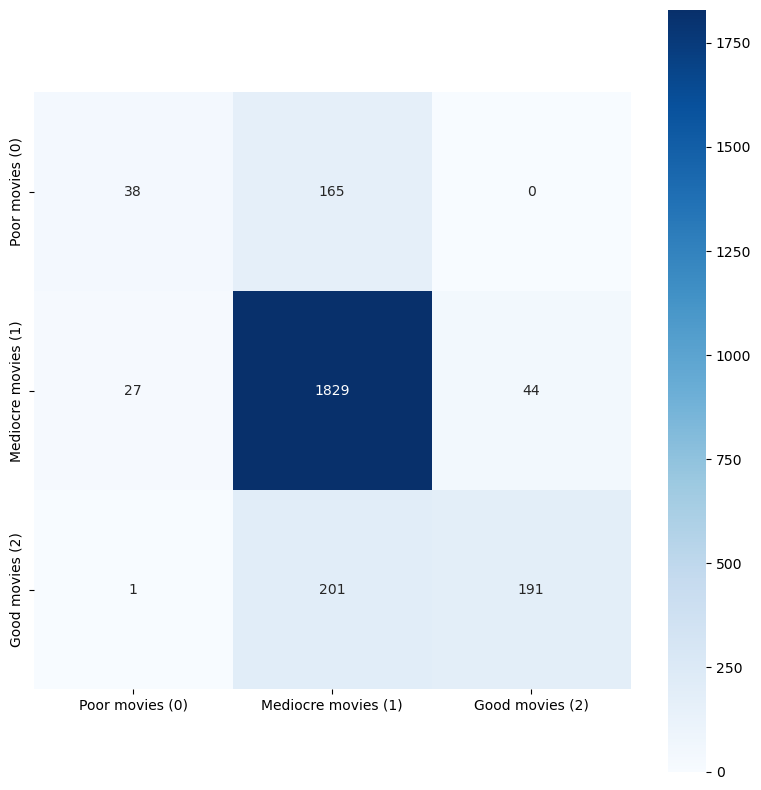

Test Confusion matrix


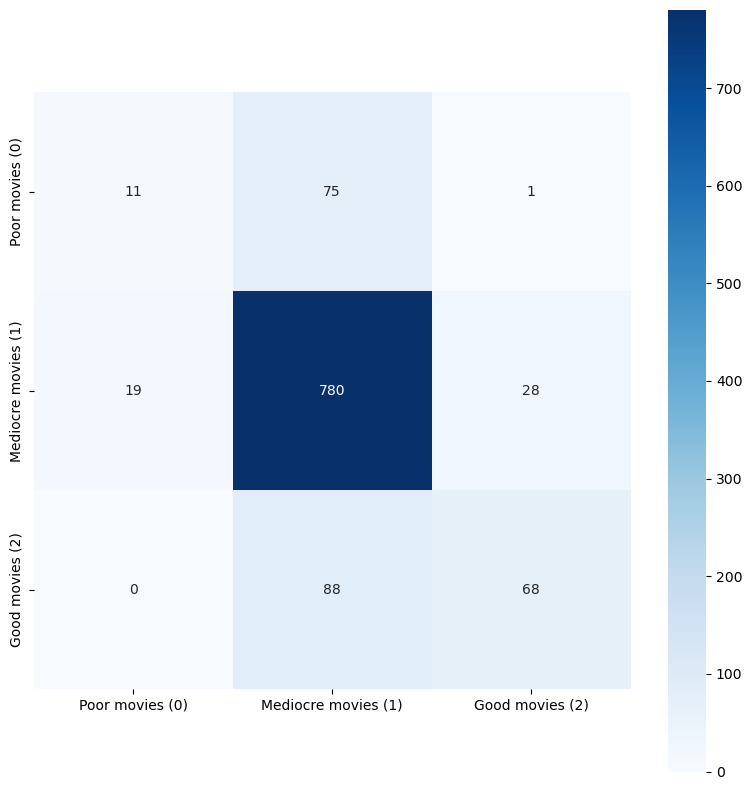

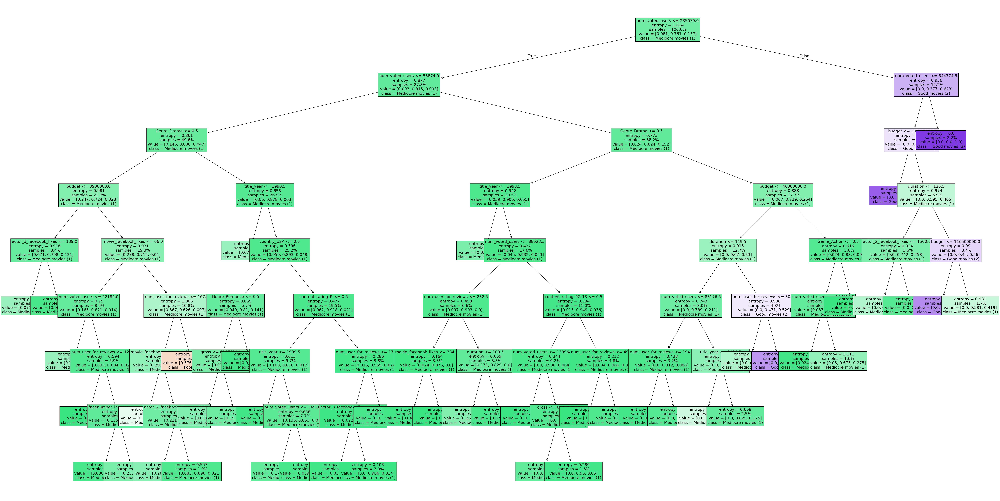

In [275]:
#Setting up the hyperparamter options
params = {
    'max_depth': [8, 10, 12, 14, 16],
    'min_samples_split': [20, 25, 30, 35, 40],
    'min_samples_leaf': [40, 45, 50, 55, 60]
}

#Making and fitting the model
clf = tree.DecisionTreeClassifier(criterion='entropy')
gcv = GridSearchCV(estimator=clf,param_grid=params, cv = 10)
gcv.fit(x_train,y_train)

model = gcv.best_estimator_
print("Best Fit Model")
print(model)
print("")

model.fit(x_train,y_train)
y_train_pred = model.predict(x_train)
y_test_pred = model.predict(x_test)


# Plotting the decision tree performance, confusion matrix, and decision tree
classes = ['Poor movies (0)', 'Mediocre movies (1)', 'Good movies (2)']

print("Decision Tree Model Performance:\n")
print(f' > Train score = {accuracy_score(y_train_pred,y_train)*100}%\n')
print(f' > Test score  = {accuracy_score(y_test_pred,y_test)*100}%\n')

print(classification_report(y_test, y_test_pred, target_names = ['Poor movies (0)', 'Mediocre movies (1)', 'Good movies (2)']))

plot_confusionmatrix(y_train_pred,y_train,dom='Train')
plot_confusionmatrix(y_test_pred,y_test,dom='Test')

fig, ax = plt.subplots(figsize=(50, 25), dpi=150)  # Reduced size while maintaining a high DPI

features = final_clean_data.columns

tree.plot_tree(
    model,
    ax=ax,
    feature_names=features,
    class_names=classes,
    filled=True,
    fontsize=14,  
    proportion=True  
)

plt.tight_layout()
plt.show()

#### Comments on Pre Pruning the Trees

We did three trials of hyperparamter tuning, each with parameter options adjusted to the previous trial's results. For example, since the chosen value was 19 for trial 1's max depth parameter, which was the lowest value in trial 1's paramter options, the options we provided for the 2nd trial was less than 19. The same logic applis to the other 2 paramters. From the training and testing results, pre pruning the trees definitely fixed the overfitting issue since the training score decreased from 100% to around 82% and the testing score is around 81%. However, the class imbalance issue worsened as the recall for poor movies and good movies dropped from 39% and 58% to around 13% and 44% on the pre pruning trial 3. Hence, we will try SMOTE to fix this issue. 

#### SMOTE Decision Tree

Original class distribution: Counter({1: 2727, 2: 549, 0: 290})
Class distribution after SMOTE: Counter({2: 1900, 1: 1900, 0: 1900})
Before SMOTE - Training set class distribution: Counter({1: 1900, 2: 393, 0: 203})
After SMOTE - Training set class distribution: Counter({2: 1900, 1: 1900, 0: 1900})

Decision Tree Model Performance:

 > Train score = 100.0%

 > Test score  = 71.68224299065422%

                     precision    recall  f1-score   support

    Poor movies (0)       0.27      0.43      0.33        87
Mediocre movies (1)       0.86      0.77      0.81       827
    Good movies (2)       0.50      0.62      0.55       156

           accuracy                           0.72      1070
          macro avg       0.54      0.60      0.56      1070
       weighted avg       0.76      0.72      0.73      1070

Train Confusion matrix


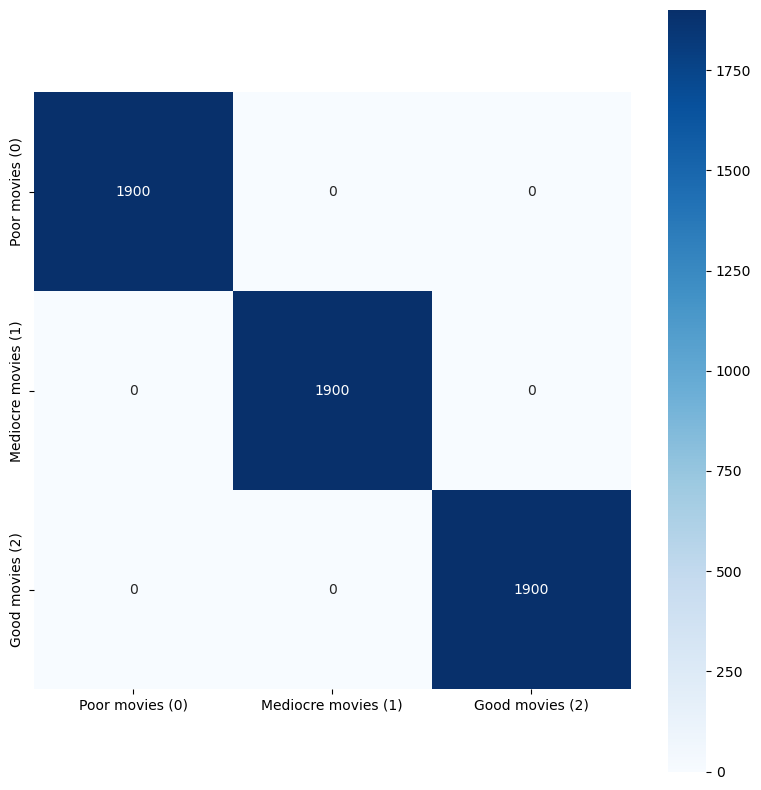

Test Confusion matrix


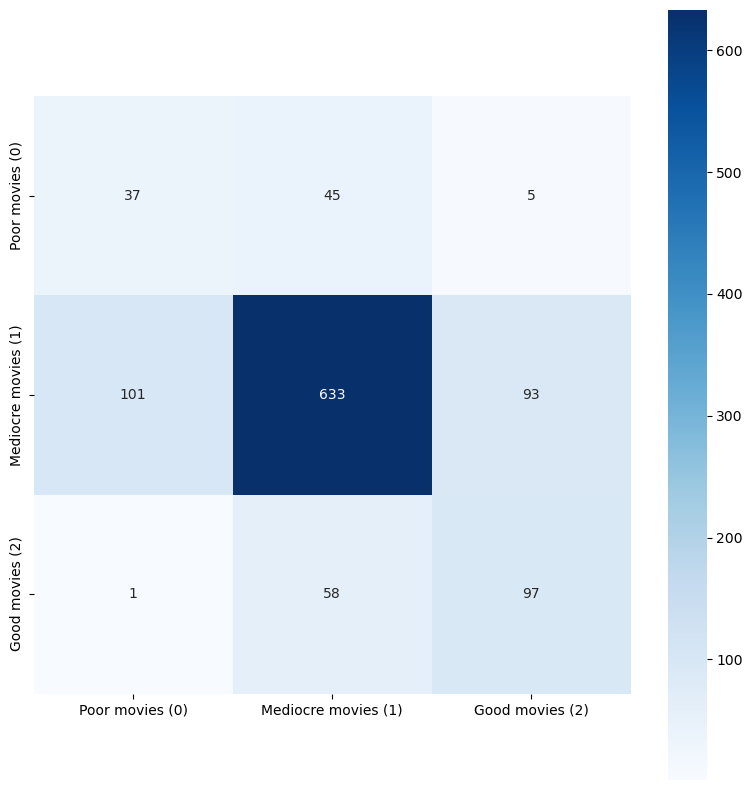

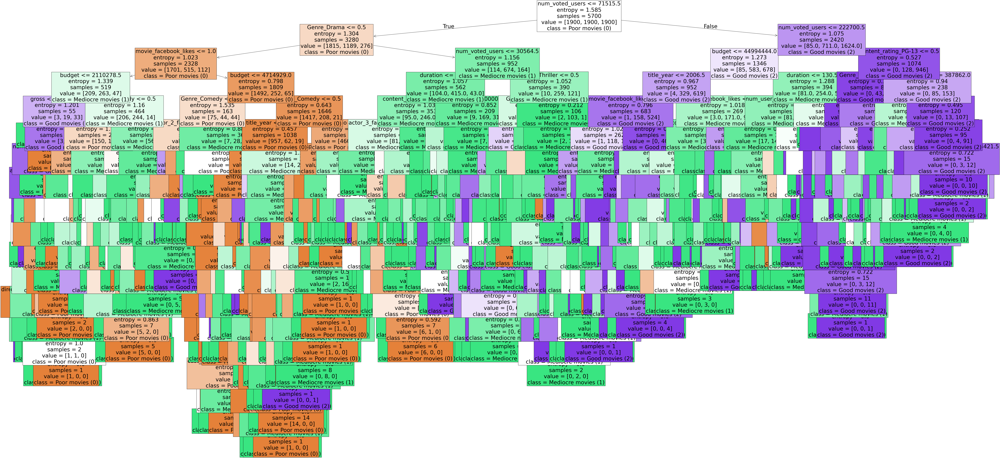

In [277]:
#Using smote to balance the data and show the distribution before and after SMOTE
print("Original class distribution:", Counter(y))

smote = SMOTE(random_state=42)
x_train_smote, y_train_smote = smote.fit_resample(x_train, y_train)

print("Class distribution after SMOTE:", Counter(y_train_smote))

# Creating the model
model = DecisionTreeClassifier(criterion='entropy', random_state=42)
model.fit(x_train_smote, y_train_smote)

y_train_pred = model.predict(x_train_smote)
y_test_pred = model.predict(x_test)

print("Before SMOTE - Training set class distribution:", Counter(y_train))
print("After SMOTE - Training set class distribution:", Counter(y_train_smote))
print("")

# Plotting the decision tree performance and confusion matrix
classes = ['Poor movies (0)', 'Mediocre movies (1)', 'Good movies (2)']

print("Decision Tree Model Performance:\n")
print(f' > Train score = {accuracy_score(y_train_pred,y_train_smote)*100}%\n')
print(f' > Test score  = {accuracy_score(y_test_pred,y_test)*100}%\n')

print(classification_report(y_test, y_test_pred, target_names = ['Poor movies (0)', 'Mediocre movies (1)', 'Good movies (2)']))

plot_confusionmatrix(y_train_pred,y_train_smote,dom='Train')
plot_confusionmatrix(y_test_pred,y_test,dom='Test')

# Plotting the decision tree
fig, ax = plt.subplots(figsize=(96, 48), dpi=100)

features = final_clean_data.columns

tree.plot_tree(model,ax=ax,feature_names=features,class_names=classes, filled=True, fontsize=32)
plt.show()

#### Comments on SMOTE Decision Tree

We implemented SMOTE on the training data and build a basic decision tree model on it. The results is still an overfitted data, but what we wanted to see is if the SMOTE technique fixes the recall accuracy imbalance issue. The answer is no. The imbalance is still heavy on mediocre movie, and the recall for poor and good movies is still poor eventhough they slighlty improved compared to our benchmark model. Next, we will try to use SMOTE and pre pruning to try and get a model that is not overfitted and hopefully have a balanced recall accuracy.  

#### SMOTE Decision Tree (with Grid Search)

Original class distribution: Counter({1: 2727, 2: 549, 0: 290})
Class distribution after SMOTE: Counter({2: 1900, 1: 1900, 0: 1900})
Best Fit Model
DecisionTreeClassifier(criterion='entropy', max_depth=19, min_samples_leaf=15,
                       min_samples_split=110)

Before SMOTE - Training set class distribution: Counter({1: 1900, 2: 393, 0: 203})
After SMOTE - Training set class distribution: Counter({2: 1900, 1: 1900, 0: 1900})

Decision Tree Model Performance:

 > Train score = 84.29824561403508%

 > Test score  = 72.80373831775701%

                     precision    recall  f1-score   support

    Poor movies (0)       0.24      0.41      0.31        87
Mediocre movies (1)       0.87      0.77      0.82       827
    Good movies (2)       0.55      0.69      0.62       156

           accuracy                           0.73      1070
          macro avg       0.56      0.62      0.58      1070
       weighted avg       0.78      0.73      0.75      1070

Train Confusion matr

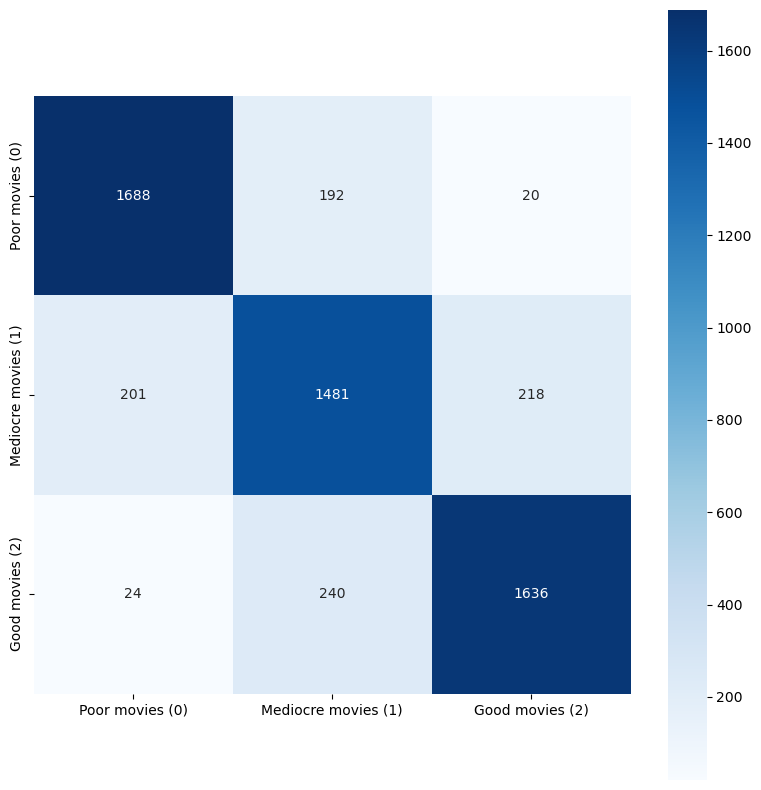

Test Confusion matrix


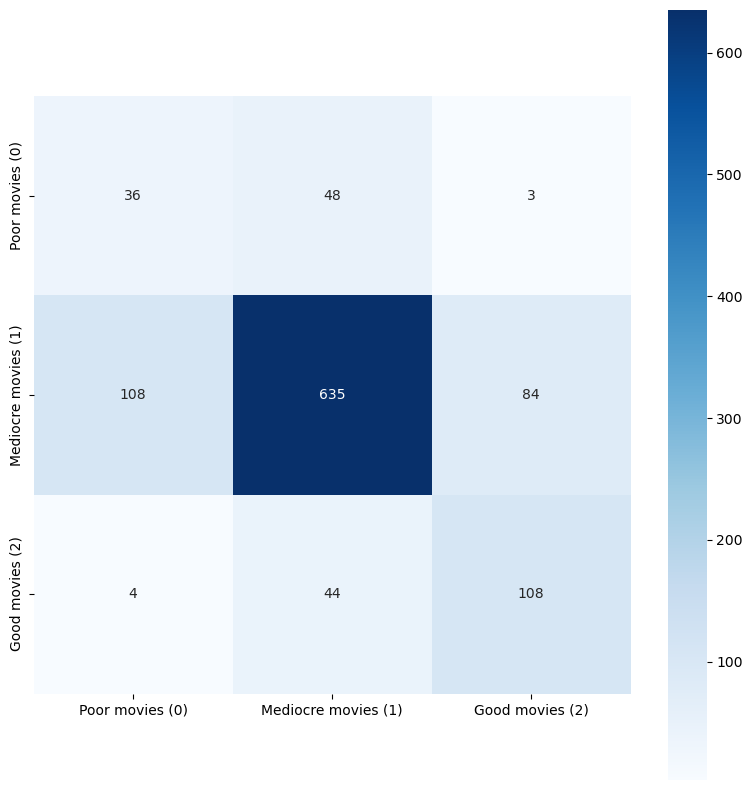

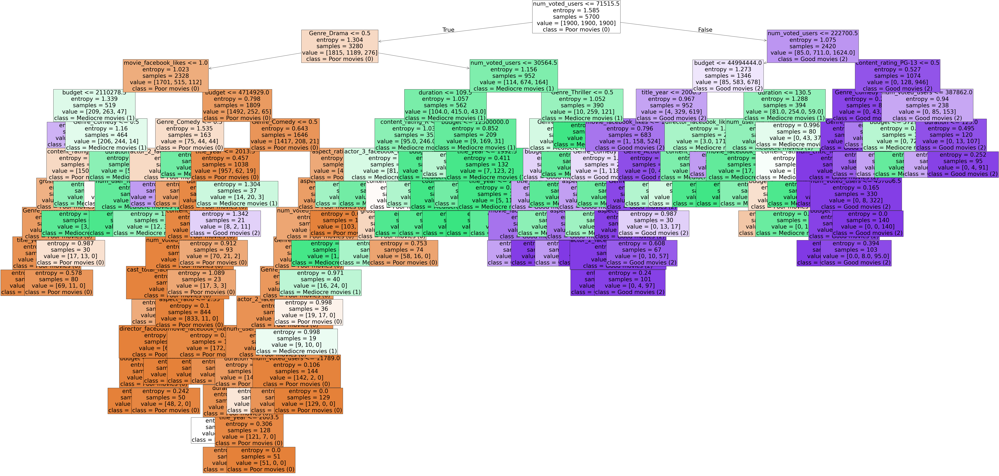

In [279]:

#Using smote to balance the data and show the distribution before and after SMOTE
print("Original class distribution:", Counter(y))
smote = SMOTE(random_state=42)
x_train_smote, y_train_smote = smote.fit_resample(x_train, y_train)

print("Class distribution after SMOTE:", Counter(y_train_smote))

# Setting the parameters from hyperparemeter tuning
params = {
    'max_depth': [19, 20, 21, 22],
    'min_samples_split': [80, 90, 100, 110, 120],
    'min_samples_leaf': [5, 10, 15, 20]
}

# Creating the model
clf = tree.DecisionTreeClassifier(criterion='entropy')
gcv = GridSearchCV(estimator=clf,param_grid=params, cv = 10)
gcv.fit(x_train,y_train)

model = gcv.best_estimator_
print("Best Fit Model")
print(model)
print("")

# Fitting and training the model
model.fit(x_train_smote,y_train_smote)
y_train_pred = model.predict(x_train_smote)
y_test_pred = model.predict(x_test)

# Output proportions before and after SMOTE
print("Before SMOTE - Training set class distribution:", Counter(y_train))
print("After SMOTE - Training set class distribution:", Counter(y_train_smote))
print("")

classes = ['Poor movies (0)', 'Mediocre movies (1)', 'Good movies (2)']

# Plotting the decision tree performance and confusion matrix
print("Decision Tree Model Performance:\n")
print(f' > Train score = {accuracy_score(y_train_pred,y_train_smote)*100}%\n')
print(f' > Test score  = {accuracy_score(y_test_pred,y_test)*100}%\n')

print(classification_report(y_test, y_test_pred, target_names = ['Poor movies (0)', 'Mediocre movies (1)', 'Good movies (2)']))

plot_confusionmatrix(y_train_pred,y_train_smote,dom='Train')
plot_confusionmatrix(y_test_pred,y_test,dom='Test')

# Plotting the decision tree
fig, ax = plt.subplots(figsize=(96, 48), dpi=100)

features = final_clean_data.columns

tree.plot_tree(model,ax=ax,feature_names=features,class_names=classes, filled=True, fontsize=32)
plt.show()

#### Comments on SMOTE Decision Tree with GridSearch

This model has a slightly better recall accuracy for good movies, but the recall accuracy for poor movies decreased to 41% compared to the SMOTE model above. Additionally, the test accuracy dropped to 72% compared to the average test accuracy from the pre pruned trial models, which is around 82%. Hence, decision tree with or without smote and pre pruning is not a good model to classify class 0, 1 and 2 movies in this dataset. We will try using random forest next

### Random Forest

#### Random Forest (Benchmark)

##### Note: 
    Good Movies : IMBD Score >= 7.5               : Associated with Dummy Variable = 2
    Mediocre Movies : IMBD Score < 7.5 and >=5    : Associated with Dummy Variable = 1
    Poor Movies : IMBD Score < 5                  : Associated with Dummy Variable = 0
*Uses 'imdb_score_category' as target column for predictions

In [283]:
train_data, test_data = train_test_split(final_clean_data, test_size=0.3, random_state=42)
# Separate features and target variable for training data
x_train = train_data.drop(["imdb_score_category"], axis=1)
y_train = train_data.imdb_score_category.values

# Separate features and target variable for testing data
x_test = test_data.drop(["imdb_score_category"], axis=1)
y_test = test_data.imdb_score_category.values

In [284]:
classifier_RF = RandomForestClassifier(n_estimators = 100, criterion='entropy', random_state = 42)

#accuracy of model
classifier_RF.fit(x_train, y_train)
classifier_RF.score(x_test, y_test)

0.8420560747663551

Random Forest Model Performance:

 > Train score = 100.0%

 > Test score  = 84.2056074766355%

                     precision    recall  f1-score   support

    Poor movies (0)       0.67      0.05      0.09        87
Mediocre movies (1)       0.84      0.98      0.91       827
    Good movies (2)       0.85      0.55      0.67       156

           accuracy                           0.84      1070
          macro avg       0.79      0.53      0.55      1070
       weighted avg       0.83      0.84      0.80      1070

Train Confusion matrix


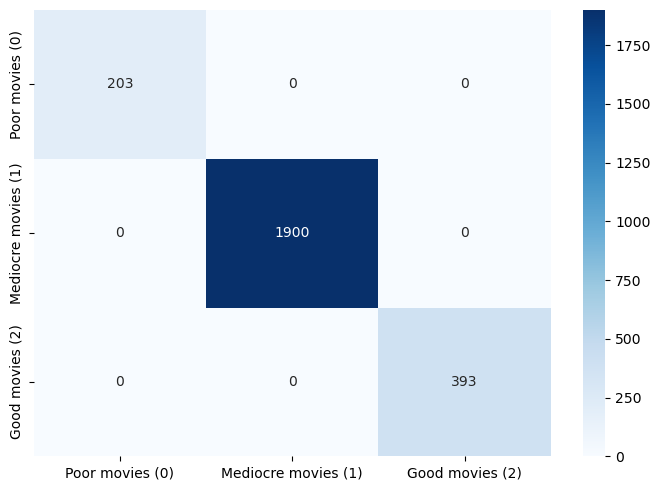

Test Confusion matrix


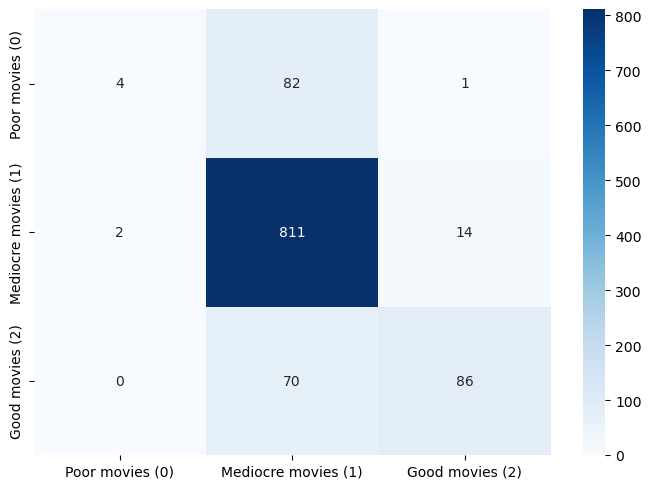

In [285]:
def plot_confusionmatrix(y_train_pred,y_train,dom):
    print(f'{dom} Confusion matrix')
    cf = confusion_matrix(y_train, y_train_pred)
    # When annot is set to True, it adds text annotations to each cell of the heatmap.
    sns.heatmap(cf,annot=True,yticklabels=['Poor movies (0)', 'Mediocre movies (1)', 'Good movies (2)'],xticklabels=['Poor movies (0)', 'Mediocre movies (1)', 'Good movies (2)'],cmap='Blues', fmt='g')
    plt.tight_layout()
    plt.show()

classifier_RF.fit(x_train,y_train)
y_train_pred = classifier_RF.predict(x_train)
y_test_pred = classifier_RF.predict(x_test)

print("Random Forest Model Performance:\n")

print(f' > Train score = {accuracy_score(y_train_pred,y_train)*100}%\n')

print(f' > Test score  = {accuracy_score(y_test_pred,y_test)*100}%\n')

print(classification_report(y_test, y_test_pred, target_names = ['Poor movies (0)', 'Mediocre movies (1)', 'Good movies (2)']))

fig, ax = plt.subplots(figsize=(7,5))
ax = plot_confusionmatrix(y_train_pred,y_train,dom='Train')
fig, ax = plt.subplots(figsize=(7,5))
ax = plot_confusionmatrix(y_test_pred,y_test,dom='Test')

#### Comments on Benchmark Model:

Our benchmark Random Forest model shows a 100% training accuracy which is an indication that the model is overfitted. Although we have a testing accuracy of 84.21%, this model will have poor generalized performance due to the fact that it is tailored to our testing dataset. Additionally, the benchmark shows extremely poor recall scores resulting in the need for SMOTE sampling in further data processing steps.

#### Random Forest (with Hyperparameter Tuning Gridsearch)

##### Trial 1

C:\Users\winot\anaconda3\Lib\site-packages\numpy\ma\core.py:2820: RuntimeWarning: invalid value encountered in cast
  _data = np.array(data, dtype=dtype, copy=copy,


Best Fit Model
RandomForestClassifier(criterion='entropy', max_depth=20, max_features=15,
                       min_samples_leaf=20, min_samples_split=50,
                       n_estimators=5, random_state=42)

Random Forest Model Performance:

 > Train score = 83.61378205128204%

 > Test score  = 83.64485981308411%

                     precision    recall  f1-score   support

    Poor movies (0)       0.57      0.05      0.09        87
Mediocre movies (1)       0.84      0.97      0.90       827
    Good movies (2)       0.81      0.56      0.66       156

           accuracy                           0.84      1070
          macro avg       0.74      0.53      0.55      1070
       weighted avg       0.81      0.84      0.80      1070

Train Confusion matrix


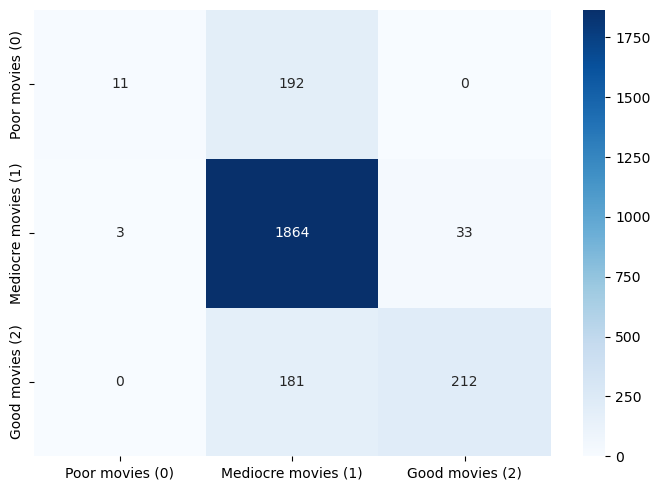

Test Confusion matrix


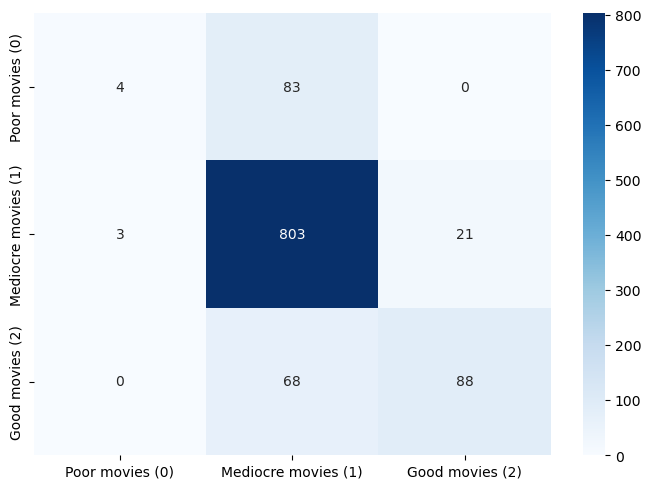

In [288]:
train_data, test_data = train_test_split(final_clean_data, test_size=0.3, random_state=42)
# Separate features and target variable for training data
x_train = train_data.drop(["imdb_score_category"], axis=1)
y_train = train_data.imdb_score_category.values

# Separate features and target variable for testing data
x_test = test_data.drop(["imdb_score_category"], axis=1)
y_test = test_data.imdb_score_category.values

params = {'max_depth': [20,30,40,50],
         'min_samples_split': [25,50,75,100],
         'min_samples_leaf': [20,30,40,50],
         'max_features' : ['sqrt', 'log2', None,30,25,20,15]}

clf = RandomForestClassifier(criterion = 'entropy', n_estimators = 5, random_state=42)
gcv = GridSearchCV(estimator=clf,param_grid=params)
gcv.fit(x_train,y_train)

model = gcv.best_estimator_
print("Best Fit Model")
print(model)

print("")

model.fit(x_train,y_train)
y_train_pred = model.predict(x_train)
y_test_pred = model.predict(x_test)

print("Random Forest Model Performance:\n")

print(f' > Train score = {accuracy_score(y_train_pred,y_train)*100}%\n')

print(f' > Test score  = {accuracy_score(y_test_pred,y_test)*100}%\n')

print(classification_report(y_test, y_test_pred, target_names = ['Poor movies (0)', 'Mediocre movies (1)', 'Good movies (2)']))

fig, ax = plt.subplots(figsize=(7,5))
ax = plot_confusionmatrix(y_train_pred,y_train,dom='Train')
fig, ax = plt.subplots(figsize=(7,5))
ax = plot_confusionmatrix(y_test_pred,y_test,dom='Test')

##### Trial 2

Best Fit Model
RandomForestClassifier(criterion='entropy', max_depth=15, max_features=15,
                       min_samples_leaf=20, min_samples_split=50,
                       n_estimators=5, random_state=42)
Random Forest Model Performance:

 > Train score = 83.61378205128204%

 > Test score  = 83.64485981308411%

                     precision    recall  f1-score   support

    Poor movies (0)       0.57      0.05      0.09        87
Mediocre movies (1)       0.84      0.97      0.90       827
    Good movies (2)       0.81      0.56      0.66       156

           accuracy                           0.84      1070
          macro avg       0.74      0.53      0.55      1070
       weighted avg       0.81      0.84      0.80      1070

Train Confusion matrix


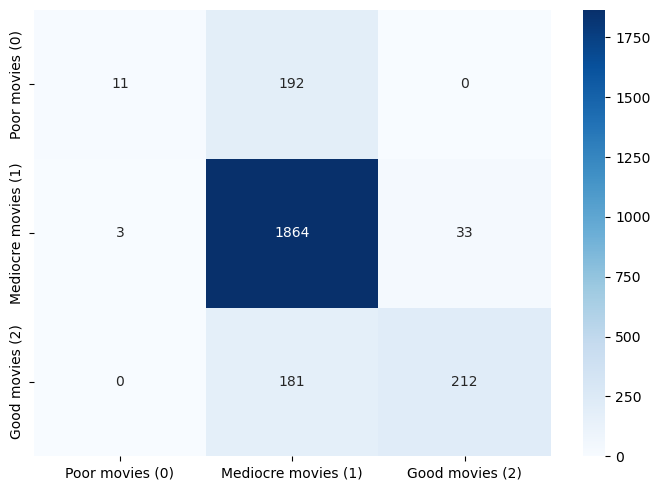

Test Confusion matrix


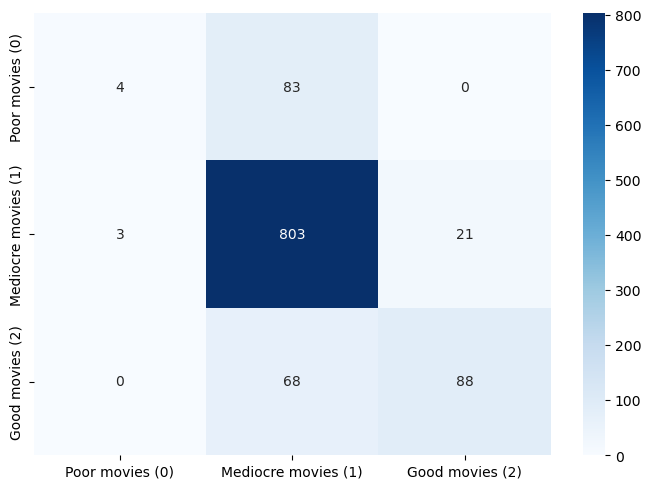

In [290]:
train_data, test_data = train_test_split(final_clean_data, test_size=0.3, random_state=42)
# Separate features and target variable for training data
x_train = train_data.drop(["imdb_score_category"], axis=1)
y_train = train_data.imdb_score_category.values

# Separate features and target variable for testing data
x_test = test_data.drop(["imdb_score_category"], axis=1)
y_test = test_data.imdb_score_category.values

params = {'max_depth': [15,20,25,30],
         'min_samples_split': [30,40,50,60],
         'min_samples_leaf': [15,20,25,30],
         'max_features' : ['sqrt', 'log2', None,30,25,20,15]}

clf = RandomForestClassifier(criterion = 'entropy', n_estimators = 5, random_state=42)
gcv = GridSearchCV(estimator=clf,param_grid=params)
gcv.fit(x_train,y_train)

model = gcv.best_estimator_
print("Best Fit Model")
print(model)

model.fit(x_train,y_train)
y_train_pred = model.predict(x_train)
y_test_pred = model.predict(x_test)

print("Random Forest Model Performance:\n")

print(f' > Train score = {accuracy_score(y_train_pred,y_train)*100}%\n')

print(f' > Test score  = {accuracy_score(y_test_pred,y_test)*100}%\n')

print(classification_report(y_test, y_test_pred, target_names = ['Poor movies (0)', 'Mediocre movies (1)', 'Good movies (2)']))

fig, ax = plt.subplots(figsize=(7,5))
ax = plot_confusionmatrix(y_train_pred,y_train,dom='Train')
fig, ax = plt.subplots(figsize=(7,5))
ax = plot_confusionmatrix(y_test_pred,y_test,dom='Test')

##### Trial 3

Best Fit Model
RandomForestClassifier(criterion='entropy', max_depth=12, min_samples_leaf=18,
                       min_samples_split=40, n_estimators=5, random_state=42)
Random Forest Model Performance:

 > Train score = 84.13461538461539%

 > Test score  = 83.27102803738318%

                     precision    recall  f1-score   support

    Poor movies (0)       0.50      0.01      0.02        87
Mediocre movies (1)       0.83      0.98      0.90       827
    Good movies (2)       0.84      0.51      0.63       156

           accuracy                           0.83      1070
          macro avg       0.72      0.50      0.52      1070
       weighted avg       0.81      0.83      0.79      1070

Train Confusion matrix


C:\Users\winot\anaconda3\Lib\site-packages\numpy\ma\core.py:2820: RuntimeWarning: invalid value encountered in cast
  _data = np.array(data, dtype=dtype, copy=copy,


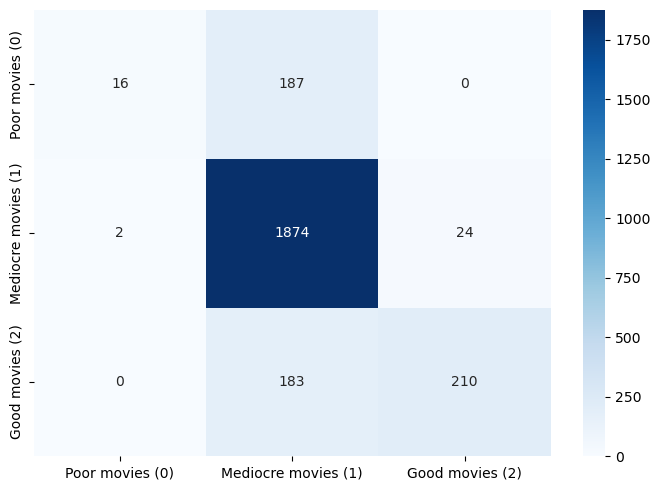

Test Confusion matrix


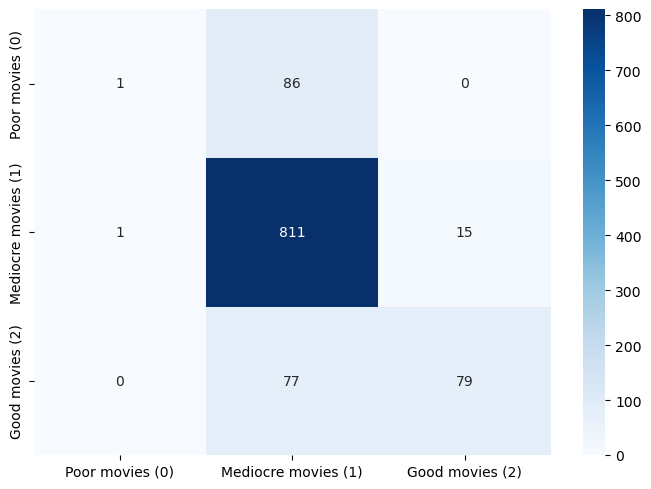

In [292]:
train_data, test_data = train_test_split(final_clean_data, test_size=0.3, random_state=42)
# Separate features and target variable for training data
x_train = train_data.drop(["imdb_score_category"], axis=1)
y_train = train_data.imdb_score_category.values

# Separate features and target variable for testing data
x_test = test_data.drop(["imdb_score_category"], axis=1)
y_test = test_data.imdb_score_category.values

params = {'max_depth': [12,15,18,20],
         'min_samples_split': [35,40,45,50],
         'min_samples_leaf': [12,15,18,20],
         'max_features' : ['sqrt', 'log2', None,25,20]}

clf = RandomForestClassifier(criterion = 'entropy', n_estimators = 5, random_state=42)
gcv = GridSearchCV(estimator=clf,param_grid=params)
gcv.fit(x_train,y_train)

model = gcv.best_estimator_
print("Best Fit Model")
print(model)

model.fit(x_train,y_train)
y_train_pred = model.predict(x_train)
y_test_pred = model.predict(x_test)

print("Random Forest Model Performance:\n")

print(f' > Train score = {accuracy_score(y_train_pred,y_train)*100}%\n')

print(f' > Test score  = {accuracy_score(y_test_pred,y_test)*100}%\n')

print(classification_report(y_test, y_test_pred, target_names = ['Poor movies (0)', 'Mediocre movies (1)', 'Good movies (2)']))

fig, ax = plt.subplots(figsize=(7,5))
ax = plot_confusionmatrix(y_train_pred,y_train,dom='Train')
fig, ax = plt.subplots(figsize=(7,5))
ax = plot_confusionmatrix(y_test_pred,y_test,dom='Test')

##### Trial 4

C:\Users\winot\anaconda3\Lib\site-packages\numpy\ma\core.py:2820: RuntimeWarning: invalid value encountered in cast
  _data = np.array(data, dtype=dtype, copy=copy,


Best Fit Model
RandomForestClassifier(criterion='entropy', max_depth=11, max_features=22,
                       min_samples_leaf=11, min_samples_split=45,
                       n_estimators=5, random_state=42)
Random Forest Model Performance:

 > Train score = 84.81570512820514%

 > Test score  = 84.01869158878505%

                     precision    recall  f1-score   support

    Poor movies (0)       0.58      0.08      0.14        87
Mediocre movies (1)       0.85      0.97      0.90       827
    Good movies (2)       0.82      0.58      0.68       156

           accuracy                           0.84      1070
          macro avg       0.75      0.54      0.57      1070
       weighted avg       0.82      0.84      0.81      1070

Train Confusion matrix


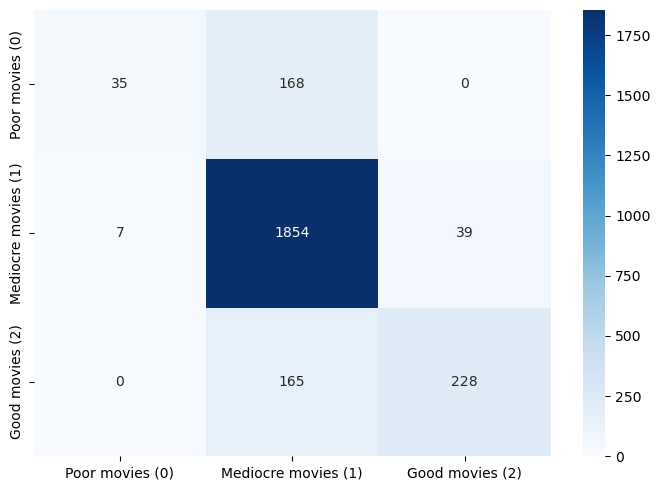

Test Confusion matrix


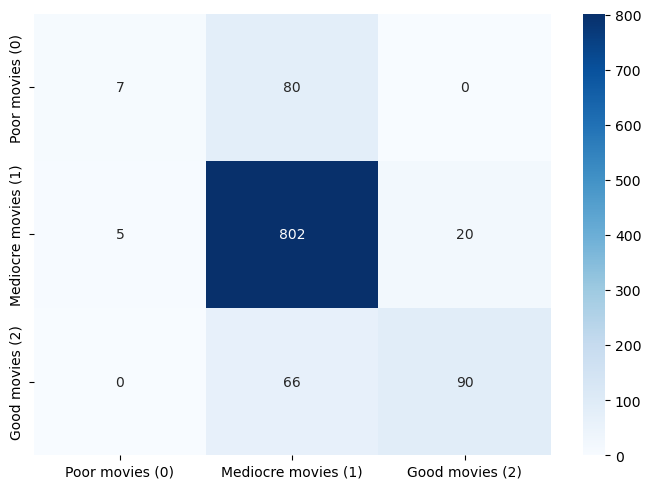

In [294]:
train_data, test_data = train_test_split(final_clean_data, test_size=0.3, random_state=42)
# Separate features and target variable for training data
x_train = train_data.drop(["imdb_score_category"], axis=1)
y_train = train_data.imdb_score_category.values

# Separate features and target variable for testing data
x_test = test_data.drop(["imdb_score_category"], axis=1)
y_test = test_data.imdb_score_category.values

params = {'max_depth': [11,12,13,14],
         'min_samples_split': [38,40,43,45],
         'min_samples_leaf': [11,12,13,14],
         'max_features' : ['sqrt', None,27,25,22]}

clf = RandomForestClassifier(criterion = 'entropy', n_estimators = 5, random_state=42)
gcv = GridSearchCV(estimator=clf,param_grid=params)
gcv.fit(x_train,y_train)

model = gcv.best_estimator_
print("Best Fit Model")
print(model)

model.fit(x_train,y_train)
y_train_pred = model.predict(x_train)
y_test_pred = model.predict(x_test)

print("Random Forest Model Performance:\n")

print(f' > Train score = {accuracy_score(y_train_pred,y_train)*100}%\n')

print(f' > Test score  = {accuracy_score(y_test_pred,y_test)*100}%\n')

print(classification_report(y_test, y_test_pred, target_names = ['Poor movies (0)', 'Mediocre movies (1)', 'Good movies (2)']))

fig, ax = plt.subplots(figsize=(7,5))
ax = plot_confusionmatrix(y_train_pred,y_train,dom='Train')
fig, ax = plt.subplots(figsize=(7,5))
ax = plot_confusionmatrix(y_test_pred,y_test,dom='Test')

##### Trial 5

Best Fit Model
RandomForestClassifier(criterion='entropy', max_depth=9, min_samples_leaf=14,
                       min_samples_split=41, n_estimators=5, random_state=42)

Random Forest Model Performance:

 > Train score = 84.13461538461539%

 > Test score  = 83.0841121495327%

                     precision    recall  f1-score   support

    Poor movies (0)       0.00      0.00      0.00        87
Mediocre movies (1)       0.83      0.98      0.90       827
    Good movies (2)       0.83      0.49      0.62       156

           accuracy                           0.83      1070
          macro avg       0.55      0.49      0.51      1070
       weighted avg       0.76      0.83      0.79      1070

Train Confusion matrix


C:\Users\winot\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\winot\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\winot\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


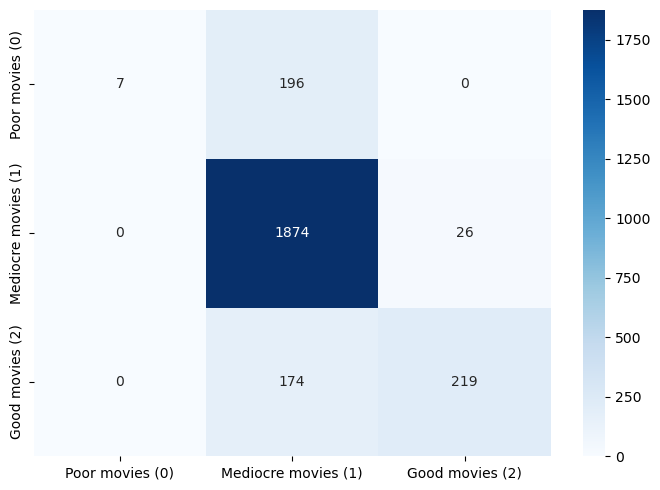

Test Confusion matrix


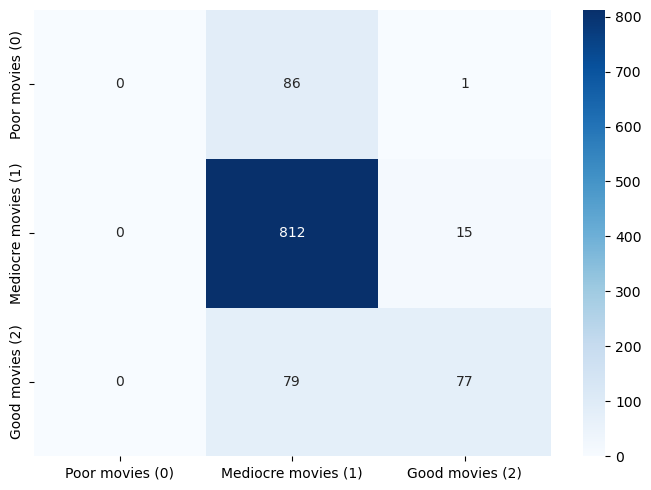

In [296]:
train_data, test_data = train_test_split(final_clean_data, test_size=0.3, random_state=42)
# Separate features and target variable for training data
x_train = train_data.drop(["imdb_score_category"], axis=1)
y_train = train_data.imdb_score_category.values

# Separate features and target variable for testing data
x_test = test_data.drop(["imdb_score_category"], axis=1)
y_test = test_data.imdb_score_category.values

params = {'max_depth': [9,10,11,13],
         'min_samples_split': [39,40,41,42],
         'min_samples_leaf': [13,14,15,16],
         'max_features' : ['sqrt', None,25,24,23,21]}

clf = RandomForestClassifier(criterion = 'entropy', n_estimators = 5, random_state=42)
gcv = GridSearchCV(estimator=clf,param_grid=params)
gcv.fit(x_train,y_train)

model = gcv.best_estimator_
print("Best Fit Model")
print(model)
print("")

model.fit(x_train,y_train)
y_train_pred = model.predict(x_train)
y_test_pred = model.predict(x_test)

print("Random Forest Model Performance:\n")

print(f' > Train score = {accuracy_score(y_train_pred,y_train)*100}%\n')

print(f' > Test score  = {accuracy_score(y_test_pred,y_test)*100}%\n')

print(classification_report(y_test, y_test_pred, target_names = ['Poor movies (0)', 'Mediocre movies (1)', 'Good movies (2)']))

fig, ax = plt.subplots(figsize=(7,5))
ax = plot_confusionmatrix(y_train_pred,y_train,dom='Train')
fig, ax = plt.subplots(figsize=(7,5))
ax = plot_confusionmatrix(y_test_pred,y_test,dom='Test')

#### Random Forest (Optimized Model using Hyperparameter Gridsearch)

Random Forest Model Performance:

 > Train score = 84.97596153846155%

 > Test score  = 84.2056074766355%

                     precision    recall  f1-score   support

    Poor movies (0)       0.80      0.05      0.09        87
Mediocre movies (1)       0.84      0.98      0.91       827
    Good movies (2)       0.86      0.54      0.67       156

           accuracy                           0.84      1070
          macro avg       0.83      0.52      0.55      1070
       weighted avg       0.84      0.84      0.80      1070

Train Confusion matrix


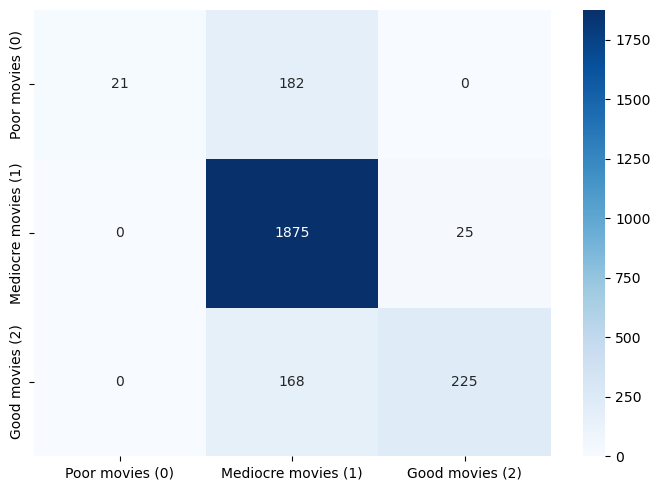

Test Confusion matrix


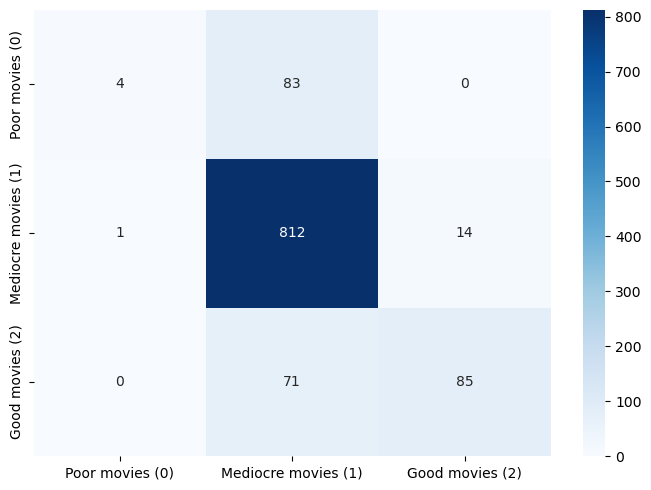

In [298]:
train_data, test_data = train_test_split(final_clean_data, test_size=0.3, random_state=42)
# Separate features and target variable for training data
x_train = train_data.drop(["imdb_score_category"], axis=1)
y_train = train_data.imdb_score_category.values

# Separate features and target variable for testing data
x_test = test_data.drop(["imdb_score_category"], axis=1)
y_test = test_data.imdb_score_category.values

classifier_RF = RandomForestClassifier(criterion='entropy', max_depth=11, max_features=21,
                                       min_samples_leaf=16, min_samples_split=42,
                                       n_estimators=250, random_state=42)

#accuracy of model
classifier_RF.fit(x_train, y_train)
classifier_RF.score(x_test, y_test)

classifier_RF.fit(x_train,y_train)
y_train_pred = classifier_RF.predict(x_train)
y_test_pred = classifier_RF.predict(x_test)

print("Random Forest Model Performance:\n")

print(f' > Train score = {accuracy_score(y_train_pred,y_train)*100}%\n')

print(f' > Test score  = {accuracy_score(y_test_pred,y_test)*100}%\n')

print(classification_report(y_test, y_test_pred, target_names = ['Poor movies (0)', 'Mediocre movies (1)', 'Good movies (2)']))

fig, ax = plt.subplots(figsize=(7,5))
ax = plot_confusionmatrix(y_train_pred,y_train,dom='Train')
fig, ax = plt.subplots(figsize=(7,5))
ax = plot_confusionmatrix(y_test_pred,y_test,dom='Test')

#### Comments on trials and optimal hyperparameters

We used sklearn's GridSearchCV to search for the best parameters that will increase the accuracy of our model and solve for overfitting. Five trials we conducted, each with parameter options adjusted based on the previous trial's results (same steps taken as decision trees). This pre prunning method resulted in similar testing accuracy as our benchmark and a training score of 85% indicating that the model is not overfit. However, the recall still shows that the model is extremely poor at predicting poor and good movies. This is mainly due to an inbalanced dataset. We tried 2 different sampling techniques in the next section in an attempt to solve this issue.

#### Random Forest (Sampling Techniques)

In [301]:
from sklearn.model_selection import StratifiedShuffleSplit
from imblearn.over_sampling import RandomOverSampler, SMOTE

In [302]:
X = final_clean_data.drop(['imdb_score_category'], axis=1)
y = final_clean_data[['imdb_score_category']]

##### Stratified Split (Failed!)

In [304]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.30, random_state = 42)
print(y_train.value_counts())
print(y_test.value_counts())

imdb_score_category
1                      1900
2                       393
0                       203
Name: count, dtype: int64
imdb_score_category
1                      827
2                      156
0                       87
Name: count, dtype: int64


In [305]:
splitter = StratifiedShuffleSplit(n_splits=1, random_state = 42, test_size = 0.30)
for train,test in splitter.split(X,y):
    X_train_strat = X.iloc[train]
    y_train_strat = y.iloc[train]
    X_test_strat = X.iloc[test]
    y_test_strat = y.iloc[test]

print(y_train_strat.value_counts())
print(y_test_strat.value_counts())

imdb_score_category
1                      1909
2                       384
0                       203
Name: count, dtype: int64
imdb_score_category
1                      818
2                      165
0                       87
Name: count, dtype: int64


##### Stratified Split Testing with no Hyperparameters (Failed!)

Random Forest Model Performance:

 > Train score = 65.5849358974359%

 > Test score  = 66.9158878504673%

                     precision    recall  f1-score   support

    Poor movies (0)       0.07      0.05      0.05        87
Mediocre movies (1)       0.77      0.85      0.81       818
    Good movies (2)       0.17      0.12      0.14       165

           accuracy                           0.67      1070
          macro avg       0.34      0.34      0.33      1070
       weighted avg       0.62      0.67      0.64      1070

Train Confusion matrix


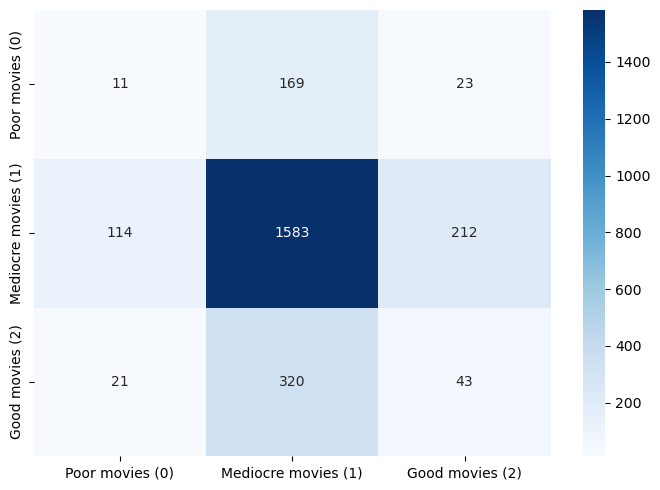

Test Confusion matrix


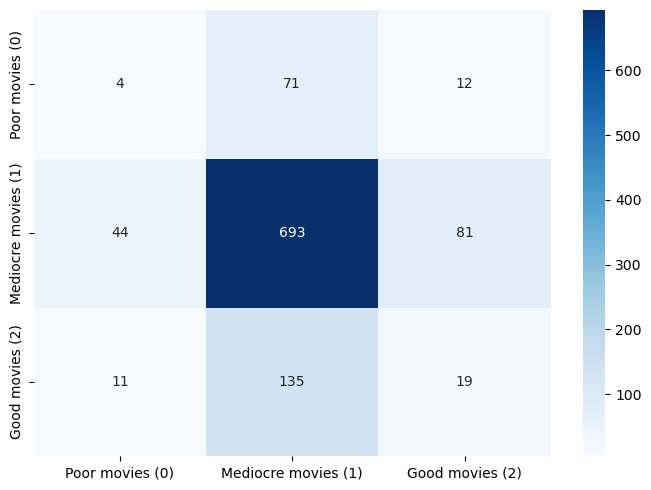

In [307]:
classifier_RF = RandomForestClassifier(criterion='entropy', n_estimators=250, random_state=42)

classifier_RF.fit(x_train,y_train_strat.values.ravel())
y_train_pred = classifier_RF.predict(X_train_strat)
y_test_pred = classifier_RF.predict(X_test_strat)

print("Random Forest Model Performance:\n")

print(f' > Train score = {accuracy_score(y_train_pred,y_train_strat)*100}%\n')

print(f' > Test score  = {accuracy_score(y_test_pred,y_test_strat)*100}%\n')

print(classification_report(y_test_strat, y_test_pred, target_names = ['Poor movies (0)', 'Mediocre movies (1)', 'Good movies (2)']))

fig, ax = plt.subplots(figsize=(7,5))
ax = plot_confusionmatrix(y_train_pred,y_train_strat,dom='Train')
fig, ax = plt.subplots(figsize=(7,5))
ax = plot_confusionmatrix(y_test_pred,y_test_strat,dom='Test')

##### SMOTE

In [309]:
#Base Distribution
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.30, random_state = 42)
print(y_train.value_counts())
print(y_test.value_counts())

imdb_score_category
1                      1900
2                       393
0                       203
Name: count, dtype: int64
imdb_score_category
1                      827
2                      156
0                       87
Name: count, dtype: int64


In [310]:
sm = SMOTE(random_state = 42)
X_sm, y_sm = sm.fit_resample(X, y)

In [311]:
X_train_sm, X_test_sm, y_train_sm, y_test_sm = train_test_split(X_sm, y_sm, test_size = 0.30, random_state = 42)
print(y_train_sm.value_counts())
print(y_test_sm.value_counts())

imdb_score_category
0                      1936
2                      1916
1                      1874
Name: count, dtype: int64
imdb_score_category
1                      853
2                      811
0                      791
Name: count, dtype: int64


###### Random Forest + SMOTE

Random Forest Model Performance:

 > Train score = 100.0%

 > Test score  = 92.21995926680245%

                     precision    recall  f1-score   support

    Poor movies (0)       0.94      0.97      0.95       791
Mediocre movies (1)       0.90      0.87      0.89       853
    Good movies (2)       0.92      0.93      0.93       811

           accuracy                           0.92      2455
          macro avg       0.92      0.92      0.92      2455
       weighted avg       0.92      0.92      0.92      2455

Train Confusion matrix


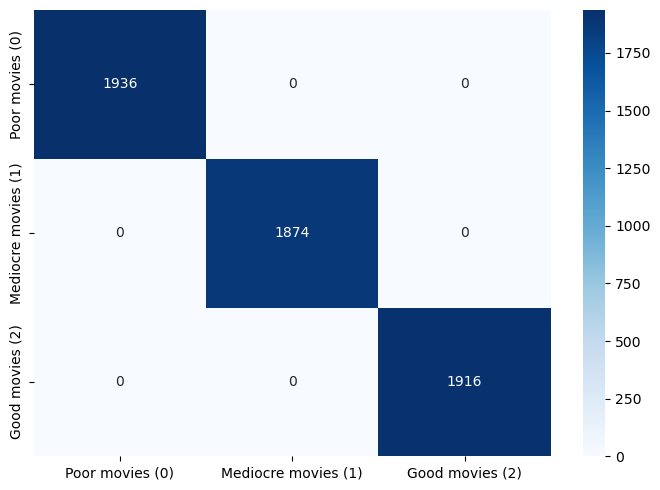

Test Confusion matrix


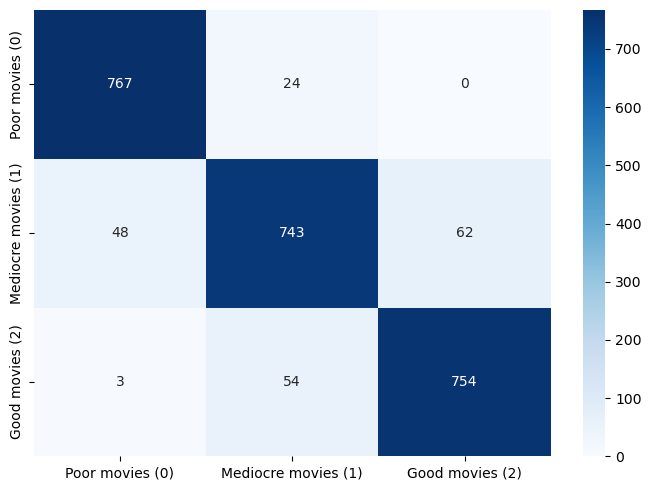

In [313]:
classifier_RF = RandomForestClassifier(criterion='entropy', n_estimators=100, random_state=42)

#needed to add .values.ravel() to fix data conversion warning
classifier_RF.fit(X_train_sm,y_train_sm.values.ravel())
y_train_pred = classifier_RF.predict(X_train_sm)
y_test_pred = classifier_RF.predict(X_test_sm)

print("Random Forest Model Performance:\n")

print(f' > Train score = {accuracy_score(y_train_pred,y_train_sm)*100}%\n')

print(f' > Test score  = {accuracy_score(y_test_pred,y_test_sm)*100}%\n')

print(classification_report(y_test_sm, y_test_pred, target_names = ['Poor movies (0)', 'Mediocre movies (1)', 'Good movies (2)']))

fig, ax = plt.subplots(figsize=(7,5))
ax = plot_confusionmatrix(y_train_pred,y_train_sm,dom='Train')
fig, ax = plt.subplots(figsize=(7,5))
ax = plot_confusionmatrix(y_test_pred,y_test_sm,dom='Test')

###### Random Forest + SMOTE + Grid Search (Trial 1)

Best Fit Model
RandomForestClassifier(criterion='entropy', max_depth=20, max_features=15,
                       min_samples_leaf=20, min_samples_split=20,
                       n_estimators=15, random_state=42)

Random Forest Model Performance:

 > Train score = 90.13272790778903%

 > Test score  = 86.35437881873727%

                     precision    recall  f1-score   support

    Poor movies (0)       0.88      0.91      0.90       791
Mediocre movies (1)       0.81      0.82      0.82       853
    Good movies (2)       0.90      0.86      0.88       811

           accuracy                           0.86      2455
          macro avg       0.87      0.86      0.86      2455
       weighted avg       0.86      0.86      0.86      2455

Train Confusion matrix


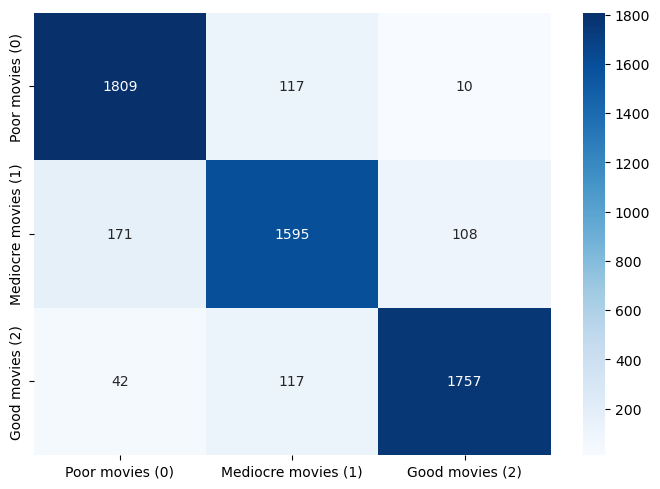

Test Confusion matrix


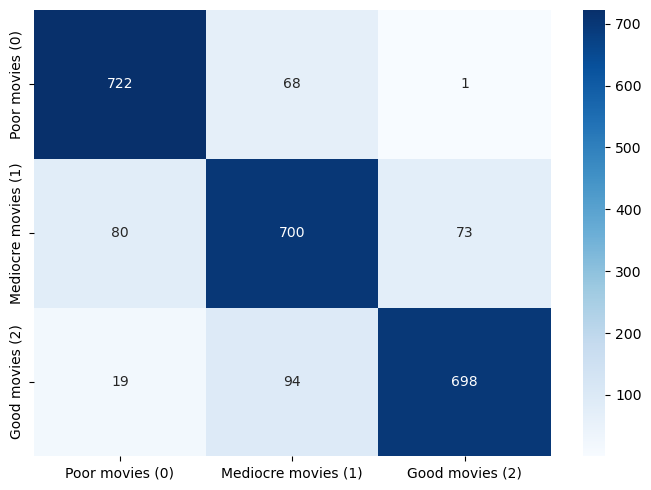

In [315]:
params = {'max_depth': [10,20,30],
         'min_samples_split': [20,30,40],
         'min_samples_leaf': [20,30,40],
         'max_features' : ['sqrt', None,20,15]}

clf = RandomForestClassifier(criterion = 'entropy', n_estimators = 15, random_state=42)
gcv = GridSearchCV(estimator=clf,param_grid=params)
gcv.fit(X_train_sm,y_train_sm.values.ravel())

model = gcv.best_estimator_
print("Best Fit Model")
print(model)
print("")

model.fit(X_train_sm,y_train_sm.values.ravel())
y_train_pred = model.predict(X_train_sm)
y_test_pred = model.predict(X_test_sm)

print("Random Forest Model Performance:\n")

print(f' > Train score = {accuracy_score(y_train_pred,y_train_sm)*100}%\n')

print(f' > Test score  = {accuracy_score(y_test_pred,y_test_sm)*100}%\n')

print(classification_report(y_test_sm, y_test_pred, target_names = ['Poor movies (0)', 'Mediocre movies (1)', 'Good movies (2)']))

fig, ax = plt.subplots(figsize=(7,5))
ax = plot_confusionmatrix(y_train_pred,y_train_sm,dom='Train')
fig, ax = plt.subplots(figsize=(7,5))
ax = plot_confusionmatrix(y_test_pred,y_test_sm,dom='Test')

###### Random Forest + SMOTE + Grid Search (Trial 2)

Best Fit Model
RandomForestClassifier(criterion='entropy', max_depth=17, max_features=15,
                       min_samples_leaf=15, min_samples_split=17,
                       n_estimators=15, random_state=42)

Random Forest Model Performance:

 > Train score = 91.32029339853301%

 > Test score  = 86.47657841140528%

                     precision    recall  f1-score   support

    Poor movies (0)       0.88      0.90      0.89       791
Mediocre movies (1)       0.82      0.81      0.82       853
    Good movies (2)       0.89      0.88      0.89       811

           accuracy                           0.86      2455
          macro avg       0.87      0.87      0.87      2455
       weighted avg       0.86      0.86      0.86      2455

Train Confusion matrix


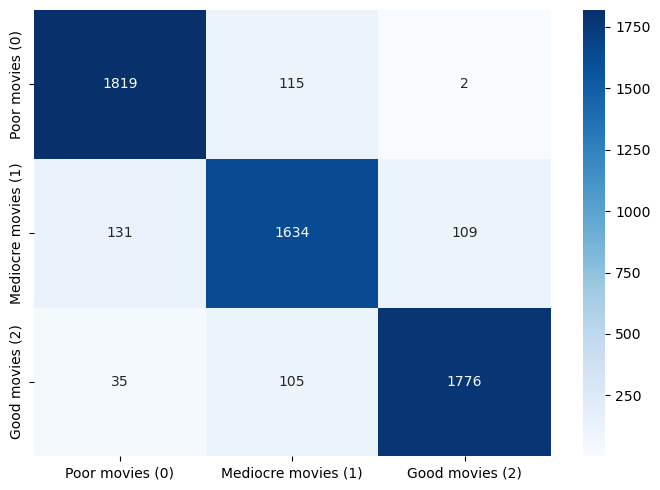

Test Confusion matrix


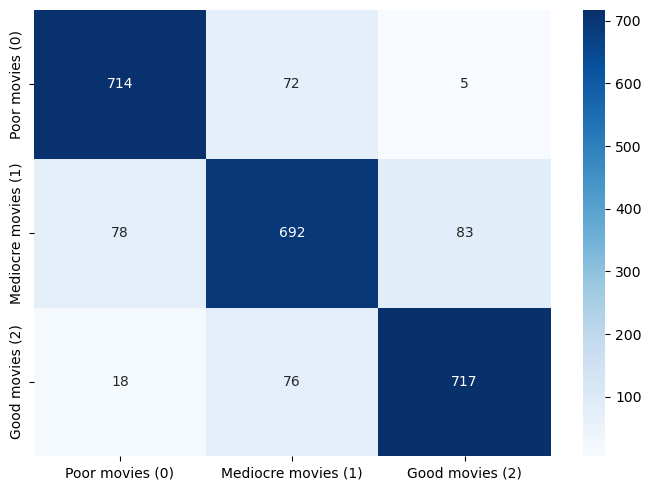

In [317]:
params = {'max_depth': [17,20,23],
         'min_samples_split': [17,20,23],
         'min_samples_leaf': [15,20,25],
         'max_features' : ['sqrt', 20,15,10]}

clf = RandomForestClassifier(criterion = 'entropy', n_estimators = 15, random_state=42)
gcv = GridSearchCV(estimator=clf,param_grid=params)
gcv.fit(X_train_sm,y_train_sm.values.ravel())

model = gcv.best_estimator_
print("Best Fit Model")
print(model)
print("")

model.fit(X_train_sm,y_train_sm.values.ravel())
y_train_pred = model.predict(X_train_sm)
y_test_pred = model.predict(X_test_sm)

print("Random Forest Model Performance:\n")

print(f' > Train score = {accuracy_score(y_train_pred,y_train_sm)*100}%\n')

print(f' > Test score  = {accuracy_score(y_test_pred,y_test_sm)*100}%\n')

print(classification_report(y_test_sm, y_test_pred, target_names = ['Poor movies (0)', 'Mediocre movies (1)', 'Good movies (2)']))

fig, ax = plt.subplots(figsize=(7,5))
ax = plot_confusionmatrix(y_train_pred,y_train_sm,dom='Train')
fig, ax = plt.subplots(figsize=(7,5))
ax = plot_confusionmatrix(y_test_pred,y_test_sm,dom='Test')

###### Random Forest + SMOTE + Grid Search (Trial 3)

Best Fit Model
RandomForestClassifier(criterion='entropy', max_depth=15, max_features=8,
                       min_samples_leaf=8, min_samples_split=17,
                       n_estimators=15, random_state=42)

Random Forest Model Performance:

 > Train score = 94.72581208522529%

 > Test score  = 89.04276985743381%

                     precision    recall  f1-score   support

    Poor movies (0)       0.91      0.95      0.93       791
Mediocre movies (1)       0.86      0.83      0.85       853
    Good movies (2)       0.90      0.90      0.90       811

           accuracy                           0.89      2455
          macro avg       0.89      0.89      0.89      2455
       weighted avg       0.89      0.89      0.89      2455

Train Confusion matrix


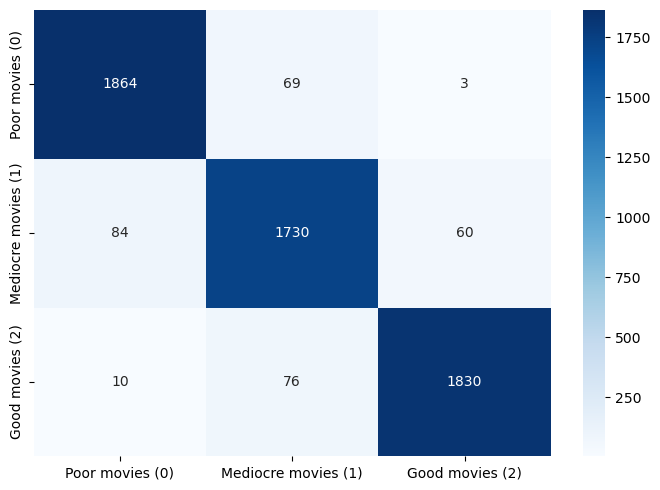

Test Confusion matrix


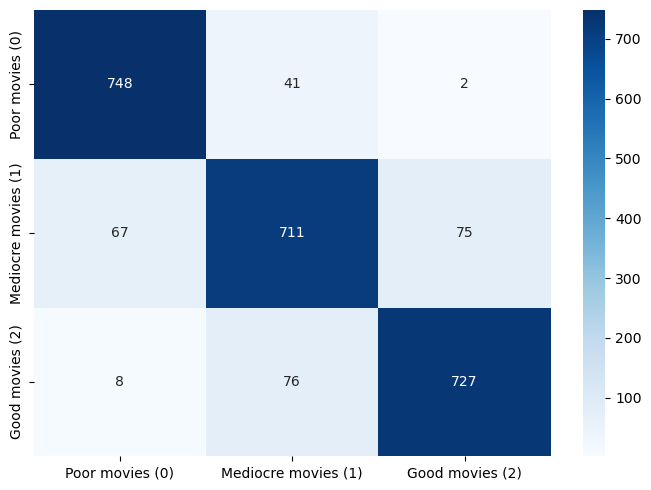

In [319]:
params = {'max_depth': [15,17,19],
         'min_samples_split': [15,17,20],
         'min_samples_leaf': [8,10,15],
         'max_features' : ['sqrt',15,10,8]}

clf = RandomForestClassifier(criterion = 'entropy', n_estimators = 15, random_state=42)
gcv = GridSearchCV(estimator=clf,param_grid=params)
gcv.fit(X_train_sm,y_train_sm.values.ravel())

model = gcv.best_estimator_
print("Best Fit Model")
print(model)
print("")

model.fit(X_train_sm,y_train_sm.values.ravel())
y_train_pred = model.predict(X_train_sm)
y_test_pred = model.predict(X_test_sm)

print("Random Forest Model Performance:\n")

print(f' > Train score = {accuracy_score(y_train_pred,y_train_sm)*100}%\n')

print(f' > Test score  = {accuracy_score(y_test_pred,y_test_sm)*100}%\n')

print(classification_report(y_test_sm, y_test_pred, target_names = ['Poor movies (0)', 'Mediocre movies (1)', 'Good movies (2)']))

fig, ax = plt.subplots(figsize=(7,5))
ax = plot_confusionmatrix(y_train_pred,y_train_sm,dom='Train')
fig, ax = plt.subplots(figsize=(7,5))
ax = plot_confusionmatrix(y_test_pred,y_test_sm,dom='Test')

###### Random Forest + SMOTE + Grid Search (Trial 4)

Best Fit Model
RandomForestClassifier(criterion='entropy', max_depth=17, max_features=8,
                       min_samples_leaf=7, min_samples_split=16,
                       n_estimators=15, random_state=42)

Random Forest Model Performance:

 > Train score = 95.09256025148446%

 > Test score  = 90.14256619144602%

                     precision    recall  f1-score   support

    Poor movies (0)       0.91      0.94      0.93       791
Mediocre movies (1)       0.88      0.86      0.87       853
    Good movies (2)       0.91      0.91      0.91       811

           accuracy                           0.90      2455
          macro avg       0.90      0.90      0.90      2455
       weighted avg       0.90      0.90      0.90      2455

Train Confusion matrix


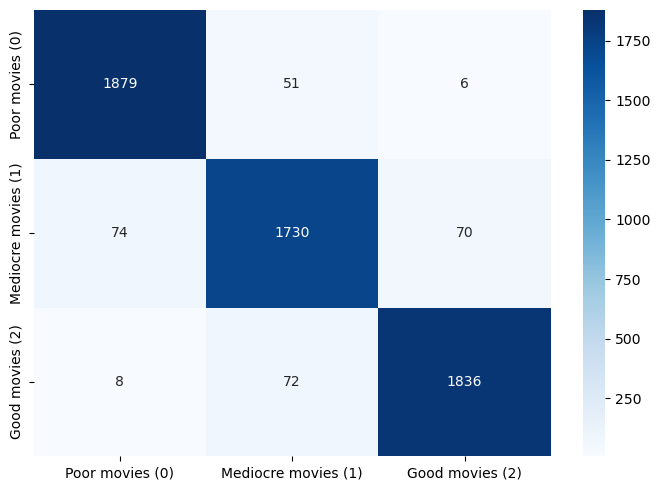

Test Confusion matrix


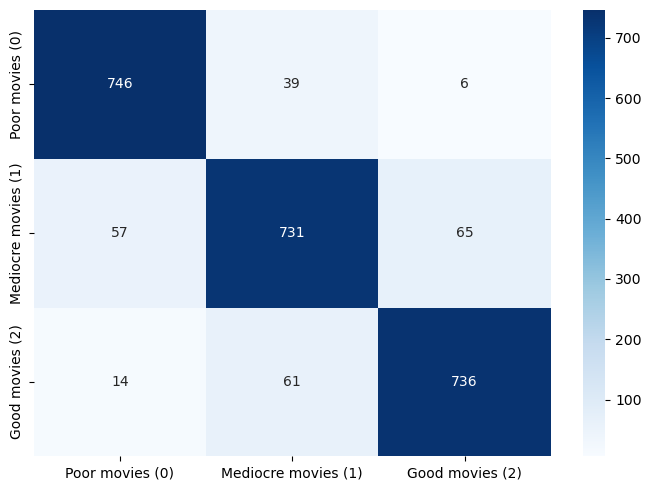

In [321]:
params = {'max_depth': [17,18,19],
         'min_samples_split': [16,17,19],
         'min_samples_leaf': [7,8,9],
         'max_features' : ['sqrt',10,8]}

clf = RandomForestClassifier(criterion = 'entropy', n_estimators = 15, random_state=42)
gcv = GridSearchCV(estimator=clf,param_grid=params)
gcv.fit(X_train_sm,y_train_sm.values.ravel())

model = gcv.best_estimator_
print("Best Fit Model")
print(model)
print("")

model.fit(X_train_sm,y_train_sm.values.ravel())
y_train_pred = model.predict(X_train_sm)
y_test_pred = model.predict(X_test_sm)

print("Random Forest Model Performance:\n")

print(f' > Train score = {accuracy_score(y_train_pred,y_train_sm)*100}%\n')

print(f' > Test score  = {accuracy_score(y_test_pred,y_test_sm)*100}%\n')

print(classification_report(y_test_sm, y_test_pred, target_names = ['Poor movies (0)', 'Mediocre movies (1)', 'Good movies (2)']))

fig, ax = plt.subplots(figsize=(7,5))
ax = plot_confusionmatrix(y_train_pred,y_train_sm,dom='Train')
fig, ax = plt.subplots(figsize=(7,5))
ax = plot_confusionmatrix(y_test_pred,y_test_sm,dom='Test')

#### Comments on sampling techniques

In this section of data processing techiques, we tried a stratified splitting strategy and SMOTE to improve recall. The stratified split failed at improving recall and hurt our model's overall accuracy. The next processing step we used with SMOTE technique which improved the recall on our benchmark model to 97%, 87%, and 93% for poor, mediocre, and good movies respectively. However, the model was still overfit so we used Grid Search to account for overfitting. Through multiple trials (same steps as previous grid search attempts) we found the optimal hyperparameters for the Random Forest and used the SMOTE technique to acquire our best model.

#### Running Optimal model with 100 decision trees (rather than 15) to obtain final performance measures
The trials could only be run with limited number of trees (for sake of time and computing power) so we found the optimal hyperparameters using 5 trees and then applied them to this model using 100 trees

Random Forest Model Performance:

 > Train score = 95.68634299685644%

 > Test score  = 90.020366598778%

                     precision    recall  f1-score   support

    Poor movies (0)       0.92      0.94      0.93       791
Mediocre movies (1)       0.87      0.85      0.86       853
    Good movies (2)       0.92      0.91      0.91       811

           accuracy                           0.90      2455
          macro avg       0.90      0.90      0.90      2455
       weighted avg       0.90      0.90      0.90      2455

Train Confusion matrix


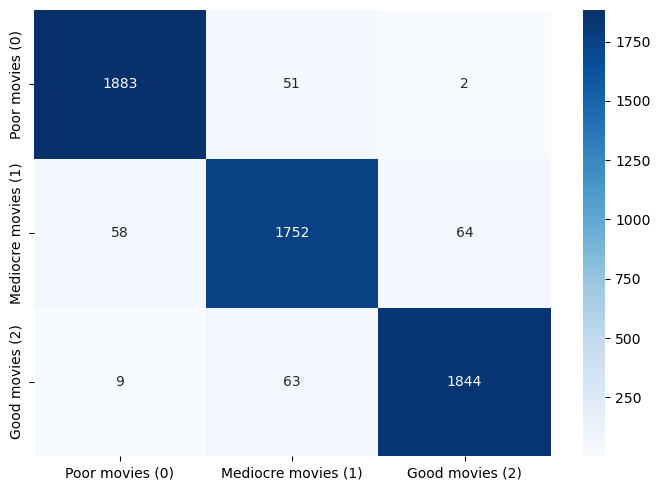

Test Confusion matrix


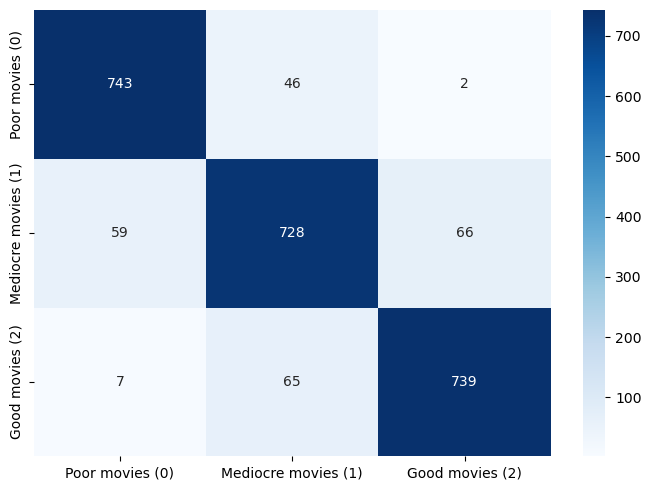

In [324]:
classifier_RF = RandomForestClassifier(criterion='entropy', n_estimators=100, random_state=42,
                                      max_features=8, min_samples_leaf=8,max_depth=18, min_samples_split=17)


#needed to add .values.ravel() to fix data conversion warning
classifier_RF.fit(X_train_sm,y_train_sm.values.ravel())
y_train_pred = classifier_RF.predict(X_train_sm)
y_test_pred = classifier_RF.predict(X_test_sm)

print("Random Forest Model Performance:\n")

print(f' > Train score = {accuracy_score(y_train_pred,y_train_sm)*100}%\n')

print(f' > Test score  = {accuracy_score(y_test_pred,y_test_sm)*100}%\n')

print(classification_report(y_test_sm, y_test_pred, target_names = ['Poor movies (0)', 'Mediocre movies (1)', 'Good movies (2)']))

fig, ax = plt.subplots(figsize=(7,5))
ax = plot_confusionmatrix(y_train_pred,y_train_sm,dom='Train')
fig, ax = plt.subplots(figsize=(7,5))
ax = plot_confusionmatrix(y_test_pred,y_test_sm,dom='Test')

##### Imporant Features in SMOTE + Hyperparameter Model

In [326]:
features = X_train_sm.columns
print(features)

Index(['num_critic_for_reviews', 'duration', 'director_facebook_likes',
       'actor_3_facebook_likes', 'gross', 'Genre_Drama', 'Genre_Comedy',
       'Genre_Thriller', 'Genre_Action', 'Genre_Romance', 'Genre_Adventure',
       'num_voted_users', 'cast_total_facebook_likes', 'facenumber_in_poster',
       'num_user_for_reviews', 'budget', 'title_year',
       'actor_2_facebook_likes', 'aspect_ratio', 'movie_facebook_likes',
       'color_Color', 'country_USA', 'country_UK', 'country_France',
       'content_rating_PG', 'content_rating_PG-13', 'content_rating_R'],
      dtype='object')


In [327]:
importances = model.feature_importances_
feature_imp_df = pd.DataFrame({'Feature': features, 'Importance': importances}).sort_values('Importance', ascending=False) 
print(feature_imp_df)

                      Feature  Importance
11            num_voted_users    0.203390
14       num_user_for_reviews    0.124249
1                    duration    0.094910
5                 Genre_Drama    0.080072
19       movie_facebook_likes    0.076907
15                     budget    0.056690
0      num_critic_for_reviews    0.047162
16                 title_year    0.039732
18               aspect_ratio    0.034813
4                       gross    0.031316
2     director_facebook_likes    0.029571
26           content_rating_R    0.025470
3      actor_3_facebook_likes    0.020327
25       content_rating_PG-13    0.019540
12  cast_total_facebook_likes    0.019520
6                Genre_Comedy    0.018630
8                Genre_Action    0.014172
17     actor_2_facebook_likes    0.013584
21                country_USA    0.012605
7              Genre_Thriller    0.010918
24          content_rating_PG    0.008126
9               Genre_Romance    0.007157
13       facenumber_in_poster    0

#### Comments about best model

After finding the best hyperparameters using GridSearchCV, we ran the model with 100 decision trees to obtain an accuracy of 90.02% as well as a recall of 94%, 85%, and 91% for poor, mediocre, and good movies. This model is not overfit thus having a reliable generalized preformance. From this model, we found the most important features that we used in the Random Forest Classifier